# eQTL catalogue top variant-gene pairs selection

In [31]:
header=pd.read_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/eQTL_catalogue/lead_pairs/split/header.tsv',sep='\t').columns.tolist()

In [34]:
chr1=pd.read_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/eQTL_catalogue/lead_pairs/split/chr1.tsv',sep='\t',header=None,names=header)

In [100]:
chr1.columns.tolist()

['eqtl_id',
 'Alasoo_2018.macrophage_IFNg.beta',
 'Alasoo_2018.macrophage_IFNg+Salmonella.beta',
 'Alasoo_2018.macrophage_naive.beta',
 'Alasoo_2018.macrophage_Salmonella.beta',
 'BLUEPRINT_PE.T-cell.beta',
 'BLUEPRINT_SE.monocyte.beta',
 'BLUEPRINT_SE.neutrophil.beta',
 'BrainSeq.brain.beta',
 'FUSION.adipose_naive.beta',
 'FUSION.muscle_naive.beta',
 'GENCORD.fibroblast.beta',
 'GENCORD.LCL.beta',
 'GENCORD.T-cell.beta',
 'GEUVADIS.LCL.beta',
 'GTEx.adipose_subcutaneous.beta',
 'GTEx.adipose_visceral.beta',
 'GTEx.adrenal_gland.beta',
 'GTEx.artery_aorta.beta',
 'GTEx.artery_coronary.beta',
 'GTEx.artery_tibial.beta',
 'GTEx.blood.beta',
 'GTEx.brain_amygdala.beta',
 'GTEx.brain_anterior_cingulate_cortex.beta',
 'GTEx.brain_caudate.beta',
 'GTEx.brain_cerebellar_hemisphere.beta',
 'GTEx.brain_cerebellum.beta',
 'GTEx.brain_cortex.beta',
 'GTEx.brain_frontal_cortex.beta',
 'GTEx.brain_hippocampus.beta',
 'GTEx.brain_hypothalamus.beta',
 'GTEx.brain_nucleus_accumbens.beta',
 'GTEx.brai

# Corr plot

### Unnecessary, move to 00

In [93]:
corr_monoc_chr1=chr1[(chr1.columns[chr1.columns.str.contains('mono')])&(chr1.columns[chr1.columns.str.contains('beta')])].corr()
corr_chr1=chr1[chr1.columns[chr1.columns.str.contains('beta')]].corr()


In [94]:
plot_data_monoc=corr_monoc_chr1.melt(ignore_index=False,var_name='Y',value_name='PearsonCorrelation').rename_axis('X').reset_index()
plot_data=corr_chr1.melt(ignore_index=False,var_name='Y',value_name='PearsonCorrelation').rename_axis('X').reset_index()


In [82]:
from plotnine import *
import math

In [83]:
colour_low = "#db584a"
colour_mid = "#ffffff"
colour_high = "#36849c"

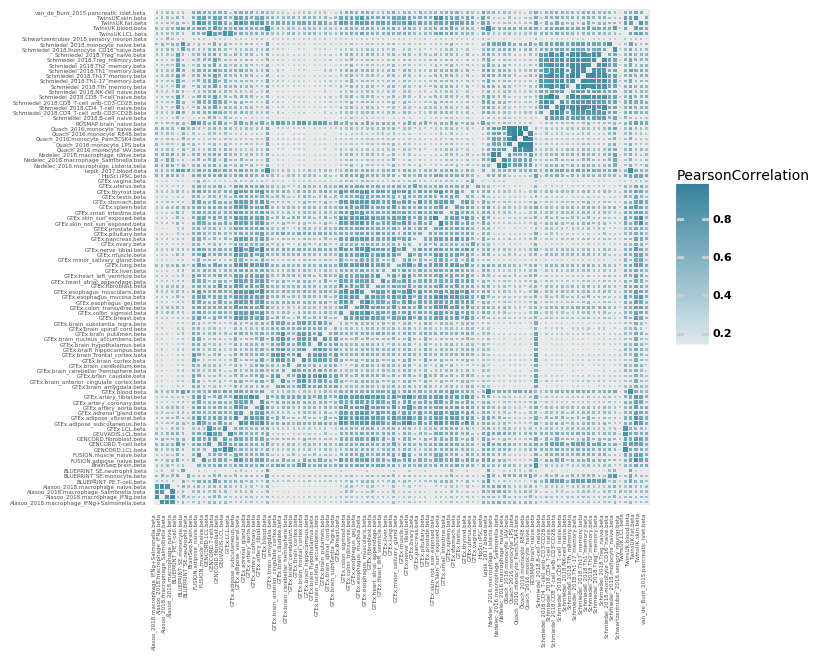

<ggplot: (2932969476861)>

In [98]:
((
ggplot(plot_data[plot_data['X'] != plot_data['Y']],aes(x='X',y='Y',fill='PearsonCorrelation'))+
    theme(
          legend_title=element_text(size=10),
#           legend_margin=margin(grid::unit(0,"cm")),
          legend_text=element_text(size=8,face="bold"),
#           legend_key_height=grid::unit(0_8,"cm"),
#           legend_key_width=grid::unit(0_2,"cm"),
          axis_title_x = element_blank(),
          axis_title_y = element_blank(),
          axis_text_x = element_text(size=4,angle = 90, vjust = 1, hjust=1),
          axis_text_y = element_text(size=4,vjust=0.2),
          axis_ticks = element_blank(),
          plot_background=element_blank(),
          plot_title=element_text(colour="grey20",hjust=0.1,vjust=-3,size=10,face="bold"),
          panel_border=element_blank(),
          panel_grid_major = element_blank(),
          panel_grid_minor = element_blank(),
          aspect_ratio = 1
    )+
    geom_tile(aes(height='PearsonCorrelation',width='PearsonCorrelation'))+
    scale_fill_gradient2(low = colour_low,mid=colour_mid,high = colour_high)
))

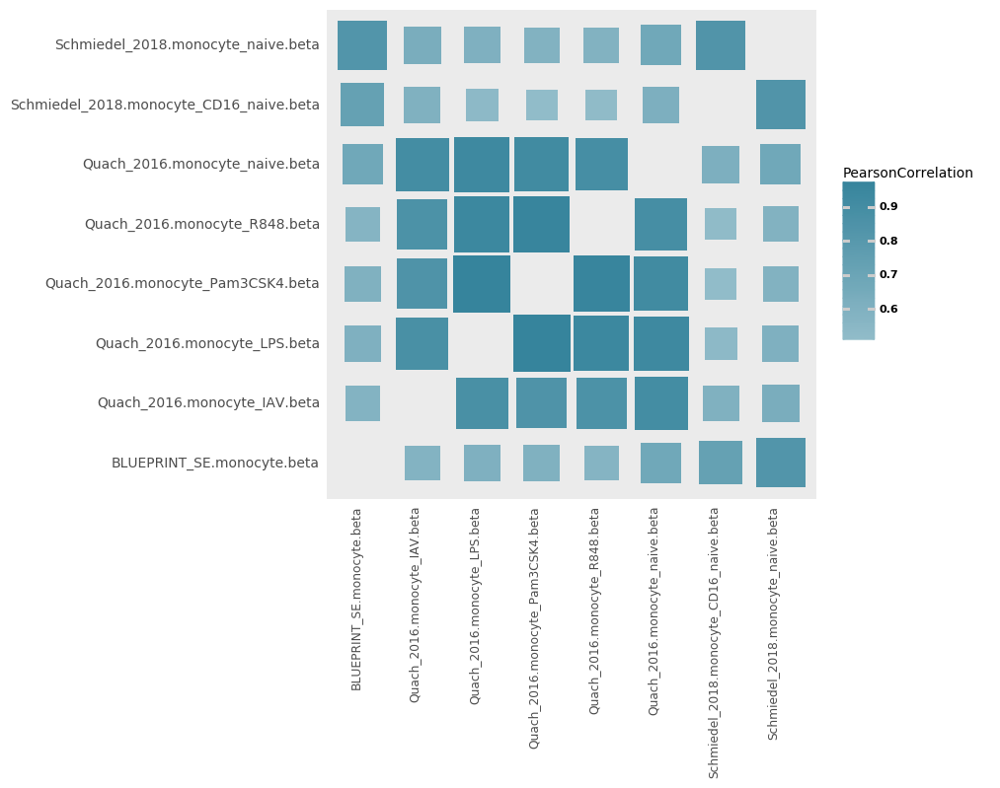

<ggplot: (2932969185895)>

In [95]:
((
ggplot(plot_data_monoc[plot_data_monoc['X'] != plot_data_monoc['Y']],aes(x='X',y='Y',fill='PearsonCorrelation'))+
    theme(
          legend_title=element_text(size=10),
#           legend_margin=margin(grid::unit(0,"cm")),
          legend_text=element_text(size=8,face="bold"),
#           legend_key_height=grid::unit(0_8,"cm"),
#           legend_key_width=grid::unit(0_2,"cm"),
          axis_title_x = element_blank(),
          axis_title_y = element_blank(),
          axis_text_x = element_text(angle = 90, vjust = 1, hjust=1),
          axis_text_y = element_text(size=10,vjust=0.2),
          axis_ticks = element_blank(),
          plot_background=element_blank(),
          plot_title=element_text(colour="grey20",hjust=0.1,vjust=-3,size=10,face="bold"),
          panel_border=element_blank(),
          panel_grid_major = element_blank(),
          panel_grid_minor = element_blank(),
          aspect_ratio = 1
    )+
    geom_tile(aes(height='PearsonCorrelation',width='PearsonCorrelation'))+
    scale_fill_gradient2(low = colour_low,mid=colour_mid,high = colour_high)
))

#### Number of variants per gene

In [64]:
chr1.groupby(by='molecular_trait_id')['eqtl_id'].count().describe()

count    1945.000000
mean        2.645758
std         2.193205
min         1.000000
25%         1.000000
50%         2.000000
75%         3.000000
max        23.000000
Name: eqtl_id, dtype: float64

#### Variants per 1Mb

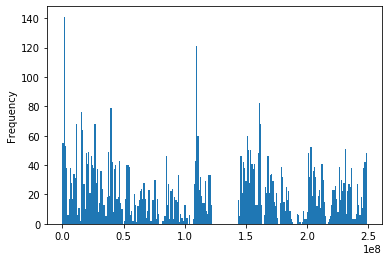

In [76]:
chr1['position'].plot.hist(bins=248)

# Question:
### No need to select for top genes?

# Old

## Questions:
### Use TPMs mean of diff exps?
### Evenly distributed?



In [1]:
import pandas as pd

In [5]:
eqtl_catalogue_metadata=pd.read_csv('https://raw.githubusercontent.com/eQTL-Catalogue/eQTL-Catalogue-resources/master/tabix/tabix_ftp_paths.tsv',sep='\t')

In [12]:
eqtl_catalogue_metadata[eqtl_catalogue_metadata['quant_method']=='microarray']

,study,qtl_group,tissue_ontology_id,tissue_ontology_term,tissue_label,condition_label,quant_method,ftp_path
32,CEDAR,T-cell_CD8,CL_0000625,"CD8-positive, alpha-beta T cell",CD8+ T cell,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
33,CEDAR,T-cell_CD4,CL_0000624,"CD4-positive, alpha-beta T cell",CD4+ T cell,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
34,CEDAR,transverse_colon,UBERON_0001157,transverse colon,transverse colon,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
35,CEDAR,monocyte_CD14,CL_0002057,"CD14-positive, CD16-negative classical monocyte",monocyte,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
36,CEDAR,neutrophil_CD15,CL_0000775,neutrophil,neutrophil,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
37,CEDAR,platelet,CL_0000233,platelet,platelet,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
38,CEDAR,rectum,UBERON_0001052,rectum,rectum,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
39,CEDAR,B-cell_CD19,CL_0000236,B cell,B cell,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
40,CEDAR,ileum,UBERON_0002116,ileum,ileum,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
41,Fairfax_2012,B-cell_CD19,CL_0000236,B cell,B cell,naive,microarray,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...


### Select Naive exp and Gene Expression quantification

In [15]:
best_eqtl_catalogue=eqtl_catalogue_metadata[(eqtl_catalogue_metadata['condition_label'] == 'naive') & (eqtl_catalogue_metadata['quant_method'] == 'ge')]

In [20]:
best_eqtl_catalogue

,study,qtl_group,tissue_ontology_id,tissue_ontology_term,tissue_label,condition_label,quant_method,ftp_path
0,Alasoo_2018,macrophage_naive,CL_0000235,macrophage,macrophage,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
16,BLUEPRINT,monocyte,CL_0002057,"CD14-positive, CD16-negative classical monocyte",monocyte,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
20,BLUEPRINT,neutrophil,CL_0000775,neutrophil,neutrophil,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
24,BLUEPRINT,T-cell,CL_0000624,"CD4-positive, alpha-beta T cell",CD4+ T cell,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
28,BrainSeq,brain,UBERON_0009834,dorsolateral prefrontal cortex,DLPFC,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
46,GENCORD,LCL,EFO_0005292,lymphoblastoid cell line,LCL,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
50,GENCORD,fibroblast,CL_0000057,fibroblast,fibroblast,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
54,GENCORD,T-cell,CL_0000084,T cell,T cell,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
58,GEUVADIS,LCL,EFO_0005292,lymphoblastoid cell line,LCL,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...
62,HipSci,iPSC,EFO_0004905,induced pluripotent stem cell,iPSC,naive,ge,ftp://ftp.ebi.ac.uk/pub/databases/spot/eQTL/cs...


# OLD, based on GTEX

In [22]:
import pandas as pd
# import numpy as np
import pyensembl
# import gffpandas.gffpandas as gffpd
# import pybedtools
# import random
# from plotnine import *
import os

### Target tissue for all filtering purposes

In [2]:
# Different GTEX files have different tissue names, therefore two variables may be needed
target='Cells_EBV-transformed_lymphocytes'
alt_target='Cells - EBV-transformed lymphocytes'

# Read mean exp GTEx file

In [3]:
genes=pd.read_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/GTEX/GTEx_Analysis_2017-06-05_v8_RNASeQCv1.1.9_gene_median_tpm.gct.gz',skiprows=2,sep='\t',usecols=['Name','Description',alt_target])

### Discard mitocondrial genes and genes with expression below top quantile 25 (aprox 1 TPM)

In [4]:
genes=genes[~ genes['Description'].str.startswith('MT-')]

In [5]:
genes=genes[genes[alt_target] >= 10]#genes[alt_target].quantile(0.85)]

In [6]:
genes['Name']=genes['Name'].str.split('.',expand=True)[0]

In [7]:
genes.sort_values(by=alt_target,ascending=False)

,Name,Description,Cells - EBV-transformed lymphocytes
20075,ENSG00000075624,ACTB,11629.4000
6469,ENSG00000211592,IGKC,9372.3700
53430,ENSG00000205542,TMSB4X,8878.0400
18054,ENSG00000231500,RPS18,8284.5000
32631,ENSG00000111640,GAPDH,6385.1500
...,...,...,...
49039,ENSG00000176182,MYPOP,10.0222
3672,ENSG00000135870,RC3H1,10.0135
45949,ENSG00000181396,OGFOD3,10.0130
3151,ENSG00000160753,RUSC1,10.0058


In [8]:
genes.to_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/processed_data/top_genes_GM12878.csv.gz',index=False,compression='gzip')

# Gene Start - End

In [15]:
ensembl = pyensembl.EnsemblRelease(release=88)

In [16]:
pyensembl.cached_release(release=88)

EnsemblRelease(release=88, species='homo_sapiens')

In [17]:
gene_db=pd.DataFrame()
for i in genes['Name']:
    gene=''
    gene=ensembl.gene_by_id(i).to_dict()
    gene_db=gene_db.append(pd.DataFrame.from_dict([gene]))

In [18]:
gene_details=gene_db.drop(columns=['strand','biotype','genome'])

In [19]:
gene_details

,contig,start,end,gene_id,gene_name
0,1,629640,630683,ENSG00000225630,MTND2P28
0,1,631074,632616,ENSG00000237973,MTCO1P12
0,1,632757,633438,ENSG00000229344,MTCO2P12
0,1,633696,634376,ENSG00000248527,MTATP6P1
0,1,634376,634922,ENSG00000198744,MTCO3P12
...,...,...,...,...,...
0,Y,12904108,12920478,ENSG00000067048,DDX3Y
0,Y,13248379,13480673,ENSG00000183878,UTY
0,Y,19567313,19606274,ENSG00000131002,TXLNGY
0,Y,19703865,19744939,ENSG00000012817,KDM5D


# Adding GM12878 eQTLs

In [68]:
dir='/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/GTEX/GTEx_Analysis_v8_eQTL/'

In [69]:
eQTL_GM12878=pd.read_csv(dir+'Cells_EBV-transformed_lymphocytes.v8.signif_variant_gene_pairs.txt.gz',usecols=[0,1,7],sep='\t').rename(columns={'slope':target})

In [70]:
eQTL_GM12878['gene_id']=eQTL_GM12878['gene_id'].str.split('.',expand=True)[0]

In [71]:
eQTLs=gene_details.merge(eQTL_GM12878)

In [72]:
eQTLs

,contig,start,end,gene_id,gene_name,variant_id,Cells_EBV-transformed_lymphocytes
0,1,631074,632616,ENSG00000237973,MTCO1P12,chr1_1544705_G_T_b38,-1.028650
1,1,631074,632616,ENSG00000237973,MTCO1P12,chr1_1546774_C_T_b38,-1.122540
2,1,631074,632616,ENSG00000237973,MTCO1P12,chr1_1553203_C_T_b38,-1.044080
3,1,631074,632616,ENSG00000237973,MTCO1P12,chr1_1567656_T_C_b38,-1.054120
4,1,631074,632616,ENSG00000237973,MTCO1P12,chr1_1572951_A_G_b38,-1.145970
...,...,...,...,...,...,...,...
185433,X,154886349,154888061,ENSG00000277203,F8A1,chrX_155758623_T_C_b38,-0.604000
185434,X,154886349,154888061,ENSG00000277203,F8A1,chrX_155758735_C_G_b38,-0.491918
185435,X,154886349,154888061,ENSG00000277203,F8A1,chrX_155758971_T_C_b38,-0.568460
185436,X,154886349,154888061,ENSG00000277203,F8A1,chrX_155759226_G_A_b38,-0.516990


## Adding rsid

In [73]:
snp_db=pd.read_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/GTEX/GTEx_Analysis_2017-06-05_v8_WholeGenomeSeq_838Indiv_Analysis_Freeze.lookup_table.txt.gz',compression='gzip',sep='\t',usecols=['variant_id','rs_id_dbSNP151_GRCh38p7'])

In [74]:
snp_db=snp_db[snp_db['rs_id_dbSNP151_GRCh38p7']!= '.']

In [75]:
eQTLs=snp_db.merge(eQTLs)

In [76]:
eQTLs[['gene_id','variant_id','rs_id_dbSNP151_GRCh38p7']]

,gene_id,variant_id,rs_id_dbSNP151_GRCh38p7
0,ENSG00000187961,chr1_951408_G_A_b38,rs10465242
1,ENSG00000187961,chr1_965350_G_A_b38,rs3935066
2,ENSG00000187961,chr1_966179_G_A_b38,rs13303160
3,ENSG00000197785,chr1_1175206_T_C_b38,rs9442387
4,ENSG00000160072,chr1_1177351_G_A_b38,rs186127282
...,...,...,...
185358,ENSG00000277203,chrX_155758623_T_C_b38,rs113469966
185359,ENSG00000277203,chrX_155758735_C_G_b38,rs6655071
185360,ENSG00000277203,chrX_155758971_T_C_b38,rs57915757
185361,ENSG00000277203,chrX_155759226_G_A_b38,rs58248838


In [77]:
eQTLs[['gene_id','variant_id','rs_id_dbSNP151_GRCh38p7']].to_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/processed_data/gene_variant_selection.csv',index=False)

# Adding GTEX eQTLs

In [78]:
dir='/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/GTEX/GTEx_Analysis_v8_eQTL/'
GTEX_eQTL=pd.DataFrame()
for i in os.listdir(dir):
    if i.endswith('.v8.signif_variant_gene_pairs.txt.gz'):
        tissue=i.replace('.v8.signif_variant_gene_pairs.txt.gz','')
        tissue_data=pd.read_csv(dir+i,sep='\t',usecols=[0,1,7]).rename(columns={'slope':tissue})
        tissue_data['gene_id']=tissue_data['gene_id'].str.split('.',expand=True)[0]
        tissue_data=eQTLs[['gene_id','variant_id']].merge(tissue_data)
        if GTEX_eQTL.empty: GTEX_eQTL=tissue_data
        else: GTEX_eQTL=GTEX_eQTL.merge(tissue_data,how='outer')
        print(tissue,'done')

Adipose_Subcutaneous done
Adipose_Visceral_Omentum done
Adrenal_Gland done
Artery_Aorta done
Artery_Coronary done
Artery_Tibial done
Brain_Amygdala done
Brain_Anterior_cingulate_cortex_BA24 done
Brain_Caudate_basal_ganglia done
Brain_Cerebellar_Hemisphere done
Brain_Cerebellum done
Brain_Cortex done
Brain_Frontal_Cortex_BA9 done
Brain_Hippocampus done
Brain_Hypothalamus done
Brain_Nucleus_accumbens_basal_ganglia done
Brain_Putamen_basal_ganglia done
Brain_Spinal_cord_cervical_c-1 done
Brain_Substantia_nigra done
Breast_Mammary_Tissue done
Cells_Cultured_fibroblasts done
Cells_EBV-transformed_lymphocytes done
Colon_Sigmoid done
Colon_Transverse done
Esophagus_Gastroesophageal_Junction done
Esophagus_Mucosa done
Esophagus_Muscularis done
Heart_Atrial_Appendage done
Heart_Left_Ventricle done
Kidney_Cortex done
Liver done
Lung done
Minor_Salivary_Gland done
Muscle_Skeletal done
Nerve_Tibial done
Ovary done
Pancreas done
Pituitary done
Prostate done
Skin_Not_Sun_Exposed_Suprapubic done
Skin

In [79]:
(GTEX_eQTL.isna().sum(axis=1)-3).mean()

20.86390487853563

In [81]:
GTEX_eQTL[target].describe()

count    185363.000000
mean          0.002581
std           0.622601
min          -4.722570
25%          -0.505323
50%          -0.186670
75%           0.516835
max           3.231510
Name: Cells_EBV-transformed_lymphocytes, dtype: float64

In [82]:
EBV=pd.read_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/eQTL_catalogue/Cells_EBV-transformed_lymphocytes.tsv.gz',sep='\t')

KeyboardInterrupt: 

#### REVIEW AND CLEAN

# Read and merge pre-finemapped values SUPERSEEDED

In [1120]:
eqtl_file = '/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/GTEX/pre-finemapped/Mean_probability.csv'

In [1121]:
eQTLs_large=pd.read_csv(eqtl_file)

In [1122]:
eQTLs_large

,eQTL,GENE,Tissue,M-Probability
0,chr1_161274374,ENSG00000248485,Brain_Caudate_basal_ganglia,0.179690
1,chr1_161687648,ENSG00000248485,Brain_Caudate_basal_ganglia,0.211998
2,chr1_161319639,ENSG00000248485,Brain_Caudate_basal_ganglia,0.119975
3,chr1_212904839,ENSG00000162769,Brain_Caudate_basal_ganglia,0.786642
4,chr1_202927014,ENSG00000117153,Brain_Caudate_basal_ganglia,0.409050
...,...,...,...,...
8702367,chr22_24652045,ENSG00000284128,Whole_Blood,0.276968
8702368,chr1_42964678,ENSG00000284138,Whole_Blood,0.232462
8702369,chr1_42965857,ENSG00000284138,Whole_Blood,0.232462
8702370,chr1_43655680,ENSG00000284138,Whole_Blood,0.169572


In [1123]:
pre_eQTLs=eQTLs_large.pivot_table(index=['eQTL','GENE'],columns='Tissue',values='M-Probability').reset_index()

In [1124]:
# pre_eQTLs=pre_eQTLs[pre_eQTLs[target].notna() & pre_eQTLs[pre_eQTLs.columns[2:]].drop(columns=target).notna().any(axis=1)]

In [1125]:
pre_eQTLs=pre_eQTLs[pre_eQTLs[target].notna()]

In [1126]:
pre_eQTLs

Tissue,eQTL,GENE,Adipose_Subcutaneous,Adipose_Visceral_Omentum,Adrenal_Gland,Artery_Aorta,Artery_Coronary,Artery_Tibial,Brain_Amygdala,Brain_Anterior_cingulate_cortex_BA24,...,Skin_Sun_Exposed,Skin_Sun_Exposed_Lower_leg,Small_Intestine_Terminal_Ileum,Spleen,Stomach,Testis,Thyroid,Uterus,Vagina,Whole_Blood
841,chr10_100345873,ENSG00000119929,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1780,chr10_100499811,ENSG00000075826,0.097753,0.125583,0.143062,0.159394,0.000158,0.162414,NaN,0.104129,...,0.005256,0.286711,0.012450,0.154364,0.237918,0.008666,NaN,0.01045,0.0308,1.158000e-07
1788,chr10_100501781,ENSG00000075826,0.143873,0.093173,0.082840,0.209427,0.000158,0.084817,NaN,0.104129,...,0.003282,0.379864,0.016830,0.095469,0.098757,0.009458,0.152040,0.01045,0.0308,6.260000e-08
1801,chr10_100505067,ENSG00000075826,0.294063,0.093173,0.100345,0.159394,0.128304,0.144214,NaN,0.104129,...,0.079840,0.400413,0.090123,0.186237,0.098757,0.117800,0.345978,0.01045,0.0308,2.918000e-02
1805,chr10_100505426,ENSG00000075826,0.327788,0.125583,0.143062,0.159394,0.128304,0.346224,NaN,0.104129,...,0.088840,0.301681,0.121965,0.154364,0.237918,0.117800,0.099876,0.01045,0.0308,2.557000e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2950623,chrX_96813513,ENSG00000204086,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2950624,chrX_96814799,ENSG00000204086,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2950625,chrX_96828061,ENSG00000204086,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2950626,chrX_96829985,ENSG00000204086,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1127]:
pre_eQTLs[pre_eQTLs.columns[2:]].notna().sum(axis=1).describe()

count    86691.000000
mean        11.869317
std         12.376476
min          1.000000
25%          2.000000
50%          7.000000
75%         19.000000
max         51.000000
dtype: float64

In [1128]:
data_merged=gene_details.merge(pre_eQTLs,left_on='gene_id',right_on='GENE',how='inner')

In [1129]:
data_merged=data_merged.drop(columns=['GENE','gene_name'])

In [1130]:
data_merged.insert(data_merged.columns.to_list().index('Adipose_Subcutaneous'),'var_chr',data_merged['eQTL'].str.split('_',expand=True)[0].str.lstrip('chr'))

In [1131]:
data_merged.insert(data_merged.columns.to_list().index('Adipose_Subcutaneous'),'var_pos',data_merged['eQTL'].str.split('_',expand=True)[1])

In [1132]:
#data_merged.insert(data_merged.columns.to_list().index('Adipose_Subcutaneous'),'var_Ref',data_merged['eQTL'].str.split('_',expand=True)[2])

In [1133]:
#data_merged.insert(data_merged.columns.to_list().index('Adipose_Subcutaneous'),'var_Alt',data_merged['eQTL'].str.split('_',expand=True)[3])

In [1134]:
data_merged

,contig,start,end,gene_id,eQTL,var_chr,var_pos,Adipose_Subcutaneous,Adipose_Visceral_Omentum,Adrenal_Gland,...,Skin_Sun_Exposed,Skin_Sun_Exposed_Lower_leg,Small_Intestine_Terminal_Ileum,Spleen,Stomach,Testis,Thyroid,Uterus,Vagina,Whole_Blood
0,1,629062,629433,ENSG00000225972,chr1_1176582,1,1176582,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,629062,629433,ENSG00000225972,chr1_1576457,1,1576457,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,631074,632616,ENSG00000237973,chr1_1576457,1,1576457,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,725885,778626,ENSG00000228327,chr1_777135,1,777135,2.131000e-13,NaN,NaN,...,0.999,0.845822,NaN,0.590192,NaN,0.798665,0.600994,NaN,NaN,NaN
4,1,725885,778626,ENSG00000228327,chr1_797421,1,797421,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63696,X,154886349,154888061,ENSG00000277203,chrX_155448967,X,155448967,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
63697,X,154886349,154888061,ENSG00000277203,chrX_155510519,X,155510519,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
63698,X,154886349,154888061,ENSG00000277203,chrX_155550622,X,155550622,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
63699,X,154886349,154888061,ENSG00000277203,chrX_155608369,X,155608369,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.175279,NaN


In [1135]:
data_num=len(data_merged[data_merged[target] > 0.8])

In [1136]:
eQTLs=pd.DataFrame(columns=data_merged.columns)
for i in range(0,100,25):
    index_range=data_merged[((i/100) < data_merged[target]) & (data_merged[target] < (i+25/100))].index.to_list()
    eQTLs=eQTLs.append(data_merged.loc[random.sample(index_range,data_num)])

In [1137]:
eQTLs.describe()

,Adipose_Subcutaneous,Adipose_Visceral_Omentum,Adrenal_Gland,Artery_Aorta,Artery_Coronary,Artery_Tibial,Brain_Amygdala,Brain_Anterior_cingulate_cortex_BA24,Brain_Caudate_basal_ganglia,Brain_Cerebellar_Hemisphere,...,Skin_Sun_Exposed,Skin_Sun_Exposed_Lower_leg,Small_Intestine_Terminal_Ileum,Spleen,Stomach,Testis,Thyroid,Uterus,Vagina,Whole_Blood
count,6.680000e+02,6.660000e+02,5.470000e+02,6.170000e+02,5.200000e+02,6.740000e+02,339.000000,3.770000e+02,4.610000e+02,4.670000e+02,...,5.650000e+02,482.000000,5.560000e+02,6.440000e+02,5.960000e+02,5.090000e+02,6.610000e+02,3.700000e+02,4.020000e+02,6.860000e+02
mean,5.916672e-01,5.355583e-01,4.749782e-01,5.485425e-01,4.810234e-01,5.633272e-01,0.413085,4.382281e-01,4.476422e-01,4.427933e-01,...,5.952584e-01,0.706407,4.928855e-01,5.261271e-01,5.295212e-01,4.979316e-01,5.770646e-01,4.514156e-01,4.393723e-01,5.505276e-01
std,3.840056e-01,3.846175e-01,3.721099e-01,3.883071e-01,3.697766e-01,3.905798e-01,0.334076,3.342398e-01,3.587935e-01,3.694647e-01,...,4.307988e-01,0.322282,3.694408e-01,3.662421e-01,3.782735e-01,3.894472e-01,3.902610e-01,3.347625e-01,3.434661e-01,3.752150e-01
min,2.655000e-24,1.493000e-89,4.837000e-13,1.834000e-40,1.162000e-13,7.183000e-15,0.000006,2.166000e-08,1.047000e-07,4.914000e-11,...,4.055000e-130,0.100693,1.013000e-14,8.705000e-40,1.380000e-32,6.244000e-12,2.656000e-60,9.797000e-08,9.857000e-12,1.246000e-20
25%,1.907342e-01,1.234290e-01,7.836175e-02,1.312000e-01,5.156500e-02,1.547390e-01,0.105195,1.305985e-01,1.001000e-01,9.075450e-02,...,7.529000e-02,0.417567,1.138687e-01,1.747910e-01,1.157715e-01,8.330350e-02,1.696530e-01,1.268729e-01,1.115946e-01,1.587501e-01
50%,6.883807e-01,5.498764e-01,4.662390e-01,5.564923e-01,5.097742e-01,6.263313e-01,0.354870,4.078000e-01,4.090495e-01,3.496583e-01,...,8.274000e-01,0.869240,4.844893e-01,5.020867e-01,5.472607e-01,5.034133e-01,6.479180e-01,4.386928e-01,4.003383e-01,5.914478e-01
75%,9.865758e-01,9.576823e-01,8.805295e-01,9.735680e-01,8.262343e-01,9.888500e-01,0.722237,7.332910e-01,8.028643e-01,8.349300e-01,...,9.995000e-01,0.992834,8.862591e-01,9.227744e-01,9.411565e-01,9.230883e-01,9.863767e-01,7.458580e-01,7.586607e-01,9.435825e-01
max,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,9.967780e-01,1.000000e+00,1.000000e+00,...,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,9.999840e-01,1.000000e+00


In [1138]:
eQTLs['start']=eQTLs['start'].astype(int)
eQTLs['end']=eQTLs['end'].astype(int)
# eQTLs['distance']=eQTLs['end']-eQTLs['start']

In [1139]:
eQTLs

,contig,start,end,gene_id,eQTL,var_chr,var_pos,Adipose_Subcutaneous,Adipose_Visceral_Omentum,Adrenal_Gland,...,Skin_Sun_Exposed,Skin_Sun_Exposed_Lower_leg,Small_Intestine_Terminal_Ileum,Spleen,Stomach,Testis,Thyroid,Uterus,Vagina,Whole_Blood
11584,3,49689499,49721529,ENSG00000164068,chr3_49707457,3,49707457,0.128300,0.005427,NaN,...,NaN,NaN,NaN,4.760000e-02,NaN,0.040660,0.080190,NaN,NaN,NaN
5854,2,44361950,44772592,ENSG00000143919,chr2_44452146,2,44452146,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52753,17,46193576,46196723,ENSG00000214401,chr17_46275267,17,46275267,NaN,NaN,NaN,...,NaN,NaN,0.000608,2.785000e-12,NaN,0.000235,NaN,NaN,NaN,NaN
37287,11,69641087,69654474,ENSG00000110092,chr11_69246550,11,69246550,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34372,10,79682997,79685436,ENSG00000278616,chr10_79700217,10,79700217,NaN,NaN,0.003335,...,NaN,0.130429,NaN,NaN,NaN,NaN,NaN,0.00676,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56362,19,6729914,6737603,ENSG00000125734,chr19_6722011,19,6722011,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.07008
6406,2,74458329,74460891,ENSG00000239779,chr2_74518802,2,74518802,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36866,11,61430042,61447529,ENSG00000167985,chr11_61256534,11,61256534,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
51490,17,37977972,37989048,ENSG00000274512,chr17_38261195,17,38261195,0.999776,0.123429,NaN,...,NaN,0.528582,NaN,1.985720e-01,0.9198,0.494841,0.958685,0.30489,0.02356,1.00000


# Add feature data

## Original GTEX eQTLs

In [23]:
dir='/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/GTEX/GTEx_Analysis_v8_eQTL/'
GTEX_eQTL=pd.DataFrame()
for i in os.listdir(dir):
    if i.endswith('.v8.signif_variant_gene_pairs.txt.gz'):
        tissue=i.replace('.v8.signif_variant_gene_pairs.txt.gz','')
        tissue_data=pd.read_csv(dir+i,sep='\t',usecols=[0,1,7]).rename(columns={'slope':tissue})
        if GTEX_eQTL.empty: GTEX_eQTL=tissue_data
        else: GTEX_eQTL=GTEX_eQTL.merge(tissue_data,how='outer')
        print(tissue,'done')

In [24]:
tissue_data['gene_id']

,variant_id,gene_id,Adipose_Subcutaneous
0,chr1_64764_C_T_b38,ENSG00000227232.5,0.586346
1,chr1_665098_G_A_b38,ENSG00000227232.5,0.384453
2,chr1_666028_G_A_b38,ENSG00000227232.5,0.371935
3,chr1_108826_G_C_b38,ENSG00000269981.1,0.431229
4,chr1_126108_G_A_b38,ENSG00000269981.1,-0.338384
...,...,...,...
2930365,chrX_155636194_A_G_b38,ENSG00000168939.11,0.102390
2930366,chrX_155656217_A_G_b38,ENSG00000168939.11,0.098783
2930367,chrX_155682745_A_AT_b38,ENSG00000168939.11,-0.127701
2930368,chrX_155687184_G_T_b38,ENSG00000168939.11,-0.102390


In [1150]:
filtered_GTEX_eQTL=GTEX_eQTL[GTEX_eQTL[target].notna()]

In [1151]:
filtered_GTEX_eQTL['gene_id']=filtered_GTEX_eQTL['gene_id'].str.split('.',expand=True)[0]

<ipython-input-1151-e05ed2165c83>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [1152]:
filtered_GTEX_eQTL['eQTL']=filtered_GTEX_eQTL['variant_id'].str.split('_',expand=True)[0]+'_'+filtered_GTEX_eQTL['variant_id'].str.split('_',expand=True)[1]

<ipython-input-1152-44a7b4be1b49>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [1153]:
filtered_GTEX_eQTL['Ref']=filtered_GTEX_eQTL['variant_id'].str.split('_',expand=True)[2]
filtered_GTEX_eQTL['Alt']=filtered_GTEX_eQTL['variant_id'].str.split('_',expand=True)[3]

<ipython-input-1153-ea891a123da2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-1153-ea891a123da2>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [1154]:
filtered_GTEX_eQTL=filtered_GTEX_eQTL.drop(columns=target)

In [1155]:
eQTLs.merge(filtered_GTEX_eQTL,how='left',on=['gene_id','eQTL'],suffixes=['_z','_slope'])

,contig,start,end,gene_id,eQTL,var_chr,var_pos,Adipose_Subcutaneous_z,Adipose_Visceral_Omentum_z,Adrenal_Gland_z,...,Small_Intestine_Terminal_Ileum_slope,Spleen_slope,Stomach_slope,Testis_slope,Thyroid_slope,Uterus_slope,Vagina_slope,Whole_Blood_slope,Ref,Alt
0,3,49689499,49721529,ENSG00000164068,chr3_49707457,3,49707457,0.128300,0.005427,NaN,...,-0.125171,-0.274098,-0.135749,-0.274862,-0.244381,NaN,NaN,NaN,A,G
1,2,44361950,44772592,ENSG00000143919,chr2_44452146,2,44452146,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,-0.209652,NaN,NaN,-0.179797,T,A
2,17,46193576,46196723,ENSG00000214401,chr17_46275267,17,46275267,NaN,NaN,NaN,...,1.254340,1.240110,1.253750,1.297690,1.174570,1.224960,1.233300,1.281670,GT,G
3,11,69641087,69654474,ENSG00000110092,chr11_69246550,11,69246550,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,T,C
4,10,79682997,79685436,ENSG00000278616,chr10_79700217,10,79700217,NaN,NaN,0.003335,...,-0.795010,-0.633753,-0.749439,-0.253234,-0.845651,-0.864322,-0.749447,-0.460318,C,T
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1703,19,6729914,6737603,ENSG00000125734,chr19_6722011,19,6722011,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1704,2,74458329,74460891,ENSG00000239779,chr2_74518802,2,74518802,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,C,T
1705,11,61430042,61447529,ENSG00000167985,chr11_61256534,11,61256534,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G,T
1706,17,37977972,37989048,ENSG00000274512,chr17_38261195,17,38261195,0.999776,0.123429,NaN,...,0.979661,1.123450,1.043440,1.094930,0.986652,1.023860,0.795783,0.927193,A,G


### Regulatory Build release 88

In [528]:
from ftplib import FTP
import io
import gzip
import gffutils

In [438]:
# ftp = FTP('ftp.ensembl.org')
# ftp.login()
# ftp.cwd('pub/release-88/regulation/homo_sapiens/RegulatoryFeatureActivity')
# folders=ftp.nlst()
# r = io.BytesIO()
# file='homo_sapiens.GRCh38.Lung.Regulatory_Build.regulatory_activity.20161111.gff.gz'
# ftp.retrbinary('RETR '+file,r.write)

In [614]:
gene_bed=pybedtools.BedTool.from_dataframe(eQTLs[eQTLs.columns[0:5]])

In [640]:
var_bed=pybedtools.BedTool.from_dataframe(eQTLs[['var_chr','var_pos','var_pos','gene_id','eQTL']])

In [618]:
names=['chrom', 'trash', 'type', 'start', 'end', 'trash2','trash3','trash4','trash5','activity','whoknows1','whoknows2','trash55','trash6', 'trash7','trash8','trash9','trash10','trash11','regbuild_snp_feature_type','trash13','gene_id']


## Option 1: Only reg build tissues matching with eQTL tissues

In [667]:
ftp = FTP('ftp.ensembl.org')
ftp.login()
ftp.cwd('pub/release-88/regulation/homo_sapiens/RegulatoryFeatureActivity')
folders=ftp.nlst()
bed_tissues={}
bed_gene_intersections={}
bed_gene_table={}
bed_var_intersections={}
bed_var_table={}
# To include GM12878 the name has to be changed to match reg build name
for i in eQTLs_large['Tissue'].unique().tolist()+['GM12878']:
    if i in(folders): 
        print(i)
        r = io.BytesIO()
        ftp.cwd(i)
        file='homo_sapiens.GRCh38.'+i+'.Regulatory_Build.regulatory_activity.20161111.gff.gz'
        ftp.retrbinary('RETR '+file,r.write)
        if i == 'GM12878': i=target
        with gzip.open(r, mode="rt") as f:
            r.seek(0)
            gff_=pd.read_csv(f,sep='\t|;|=',header=None, engine='python',names=names)
            bed_tissues[i]=pybedtools.BedTool.from_dataframe(gff_[['chrom','start','end','activity','gene_id','regbuild_snp_feature_type']])
# GENE
            bed_gene_intersections[i]=gene_bed.intersect(bed_tissues[i],wa=True, wb=True, loj=True).to_dataframe(names=['chrom', 'start', 'end', 'gene_id', 'eQTL', 'strand', 'thickStart','thickEnd', 'regbuild_snp_activity', 'reg_id', 'regbuild_snp_feature_type'])
            bed_gene_intersections[i]['regbuild_snp_activity']=bed_gene_intersections[i]['regbuild_snp_activity'].replace({'REPRESSED':1,'INACTIVE':2,'POISED':3,'ACTIVE':4,'.':0}).astype('int')
            bed_gene_table[i]=bed_gene_intersections[i].pivot_table(index=['gene_id','eQTL'], columns=['regbuild_snp_feature_type'], values='regbuild_snp_activity').drop(columns='.')
# VARIANT
            bed_var_intersections[i]=var_bed.intersect(bed_tissues[i],wa=True, wb=True, loj=True).to_dataframe(names=['chrom', 'start', 'end', 'gene_id', 'eQTL', 'strand', 'thickStart','thickEnd', 'regbuild_snp_activity', 'reg_id', 'regbuild_snp_feature_type'])
            bed_var_intersections[i]['regbuild_snp_activity']=bed_var_intersections[i]['regbuild_snp_activity'].replace({'REPRESSED':1,'INACTIVE':2,'POISED':3,'ACTIVE':4,'.':0}).astype('int')
            bed_var_table[i]=bed_var_intersections[i].pivot_table(index=['gene_id','eQTL'], columns=['regbuild_snp_feature_type'], values='regbuild_snp_activity').drop(columns='.')
        ftp.cwd('..')

Pancreas


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Spleen


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Ovary


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Lung


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


GM12878


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


## Option 2: Using all tissues to get a diferential activity value for GM12878

In [1163]:
ftp = FTP('ftp.ensembl.org')
ftp.login()
ftp.cwd('pub/release-88/regulation/homo_sapiens/RegulatoryFeatureActivity')
folders=ftp.nlst()
bed_tissues={}
bed_gene_intersections={}
bed_gene_table={}
bed_var_intersections={}
bed_var_table={}
for i in folders:
    print(i)
    r = io.BytesIO()
    ftp.cwd(i)
    file='homo_sapiens.GRCh38.'+i+'.Regulatory_Build.regulatory_activity.20161111.gff.gz'
    ftp.retrbinary('RETR '+file,r.write)
#     if i == 'GM12878': i=target
    with gzip.open(r, mode="rt") as f:
        r.seek(0)
        gff_=pd.read_csv(f,sep='\t|;|=',header=None, engine='python',names=names)
        bed_tissues[i]=pybedtools.BedTool.from_dataframe(gff_[['chrom','start','end','activity','gene_id','regbuild_snp_feature_type']])
# GENE
        bed_gene_intersections[i]=gene_bed.intersect(bed_tissues[i],wa=True, wb=True, loj=True).to_dataframe(names=['chrom', 'start', 'end', 'gene_id', 'eQTL', 'strand', 'thickStart','thickEnd', 'regbuild_snp_activity', 'reg_id', 'regbuild_snp_feature_type'])
        bed_gene_intersections[i]['regbuild_snp_activity']=bed_gene_intersections[i]['regbuild_snp_activity'].replace({'REPRESSED':1,'INACTIVE':2,'POISED':3,'ACTIVE':4,'.':0}).astype('int').replace({0:np.nan})
        bed_gene_table[i]=bed_gene_intersections[i].pivot_table(index=['gene_id','eQTL'], columns=['regbuild_snp_feature_type'], values='regbuild_snp_activity')#.drop(columns='.')
# VARIANT
        bed_var_intersections[i]=var_bed.intersect(bed_tissues[i],wa=True, wb=True, loj=True).to_dataframe(names=['chrom', 'start', 'end', 'gene_id', 'eQTL', 'strand', 'thickStart','thickEnd', 'regbuild_snp_activity', 'reg_id', 'regbuild_snp_feature_type'])
        bed_var_intersections[i]['regbuild_snp_activity']=bed_var_intersections[i]['regbuild_snp_activity'].replace({'REPRESSED':1,'INACTIVE':2,'POISED':3,'ACTIVE':4,'.':0}).astype('int').replace({0:np.nan})
        bed_var_table[i]=bed_var_intersections[i].pivot_table(index=['gene_id','eQTL'], columns=['regbuild_snp_feature_type'], values='regbuild_snp_activity')#.drop(columns='.')
    ftp.cwd('..')

A549


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Aorta


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


B_cells_PB_Roadmap


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


CD14CD16__monocyte_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


CD14CD16__monocyte_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


CD4_ab_T_cell_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


CD8_ab_T_cell_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


CM_CD4_ab_T_cell_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


DND_41


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


EPC_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Fetal_Adrenal_Gland


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Fetal_Intestine_Large


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Fetal_Intestine_Small


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Fetal_Muscle_Leg


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Fetal_Muscle_Trunk


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Fetal_Stomach


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Fetal_Thymus


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


GM12878


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Gastric


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


H1ESC


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


H1_mesenchymal


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


H1_neuronal_progenitor


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


H1_trophoblast


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


H9


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


HMEC


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


HSMM


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


HSMMtube


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


HUVEC


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


HUVEC_prol_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


HeLa_S3


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


HepG2


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


IMR90


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


K562


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Left_Ventricle


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Lung


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


M0_macrophage_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


M0_macrophage_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


M1_macrophage_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


M1_macrophage_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


M2_macrophage_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


M2_macrophage_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


MSC_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Monocytes_CD14


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Monocytes_CD14_PB_Roadmap


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


NHDF_AD


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


NHEK


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


NHLF


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


NH_A


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Natural_Killer_cells_PB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Osteobl


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Ovary


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Pancreas


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Placenta


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Psoas_Muscle


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Right_Atrium


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Small_Intestine


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Spleen


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


T_cells_PB_Roadmap


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


Thymus


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


eosinophil_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


erythroblast_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


iPS_20b


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


iPS_DF_19_11


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


iPS_DF_6_9


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


naive_B_cell_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


neutrophil_CB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


neutrophil_VB


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


neutrophil_myelocyte_BM


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used
/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


### Merged GENE table

In [1164]:
bed_gene_table_merged=pd.DataFrame()
for i in bed_gene_table.keys():
    if bed_gene_table_merged.empty:
        bed_gene_table_merged=pd.DataFrame(columns=['gene_id','eQTL']).merge(bed_gene_table[i].add_prefix(i+'_gene_'),on=['gene_id','eQTL'],how='outer')
    else:
        bed_gene_table_merged=bed_gene_table_merged.merge(bed_gene_table[i].add_prefix(i+'_gene_'),on=['gene_id','eQTL'],how='outer')

In [1165]:
bed_gene_table_merged

,gene_id,eQTL,A549_gene_CTCF Binding Site,A549_gene_Enhancer,A549_gene_Open chromatin,A549_gene_Promoter,A549_gene_Promoter Flanking Region,A549_gene_TF binding site,Aorta_gene_CTCF Binding Site,Aorta_gene_Enhancer,...,neutrophil_CB_gene_Promoter,neutrophil_CB_gene_Promoter Flanking Region,neutrophil_VB_gene_CTCF Binding Site,neutrophil_VB_gene_Enhancer,neutrophil_VB_gene_Promoter,neutrophil_VB_gene_Promoter Flanking Region,neutrophil_myelocyte_BM_gene_CTCF Binding Site,neutrophil_myelocyte_BM_gene_Enhancer,neutrophil_myelocyte_BM_gene_Promoter,neutrophil_myelocyte_BM_gene_Promoter Flanking Region
0,ENSG00000004777,chr19_35766415,NaN,NaN,1.0,4.0,2.0,2.0,NaN,NaN,...,4.0,2.0,NaN,NaN,4.0,2.0,NaN,NaN,4.0,2.0
1,ENSG00000005156,chr17_34980567,NaN,2.000000,2.0,4.0,2.0,2.0,NaN,4.0,...,4.0,2.0,NaN,4.0,4.0,4.0,NaN,2.000000,4.0,4.0
2,ENSG00000005801,chr11_3370868,2.4,NaN,2.0,4.0,NaN,NaN,2.400000,NaN,...,4.0,NaN,2.800000,NaN,4.0,NaN,2.0,NaN,4.0,NaN
3,ENSG00000005882,chr17_50094913,NaN,2.000000,2.0,4.0,2.0,NaN,NaN,4.0,...,2.0,2.0,NaN,2.0,3.0,2.0,NaN,2.000000,4.0,2.0
4,ENSG00000006282,chr17_50547162,2.0,NaN,NaN,4.0,NaN,4.0,2.000000,NaN,...,3.0,NaN,2.000000,NaN,3.0,NaN,2.0,NaN,2.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1207,ENSG00000280071,chr21_5099575,3.0,1.666667,1.0,4.0,2.2,NaN,2.000000,2.0,...,4.0,3.2,3.000000,2.0,4.0,3.2,2.0,2.666667,4.0,3.0
1208,ENSG00000280071,chr21_5107240,3.0,1.666667,1.0,4.0,2.2,NaN,2.000000,2.0,...,4.0,3.2,3.000000,2.0,4.0,3.2,2.0,2.666667,4.0,3.0
1209,ENSG00000280153,chr16_10923871,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1210,ENSG00000281501,chr4_25160758,4.0,NaN,2.0,4.0,4.0,NaN,2.000000,NaN,...,4.0,2.0,2.000000,NaN,4.0,2.0,2.0,NaN,4.0,2.0


In [1166]:
reg_build_types=pd.DataFrame(bed_gene_table_merged.columns)[0].str.split('_gene_',expand=True)[1].unique().tolist()[1:]

### Merged VARIANT table

In [1167]:
bed_var_table_merged=pd.DataFrame()
for i in bed_var_table:
    if bed_var_table_merged.empty:
        bed_var_table_merged=pd.DataFrame(columns=['gene_id','eQTL']).merge(bed_var_table[i].add_prefix(i+'_var_'),on=['gene_id','eQTL'],how='outer')
    else:
        bed_var_table_merged=bed_var_table_merged.merge(bed_var_table[i].add_prefix(i+'_var_'),on=['gene_id','eQTL'],how='outer')

In [1168]:
bed_var_table_merged

,gene_id,eQTL,A549_var_CTCF Binding Site,A549_var_Enhancer,A549_var_Open chromatin,A549_var_Promoter,A549_var_Promoter Flanking Region,A549_var_TF binding site,Aorta_var_CTCF Binding Site,Aorta_var_Enhancer,...,neutrophil_CB_var_Promoter,neutrophil_CB_var_Promoter Flanking Region,neutrophil_VB_var_CTCF Binding Site,neutrophil_VB_var_Enhancer,neutrophil_VB_var_Promoter,neutrophil_VB_var_Promoter Flanking Region,neutrophil_myelocyte_BM_var_CTCF Binding Site,neutrophil_myelocyte_BM_var_Enhancer,neutrophil_myelocyte_BM_var_Promoter,neutrophil_myelocyte_BM_var_Promoter Flanking Region
0,ENSG00000005156,chr17_34980567,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,4.0,NaN,NaN,NaN,4.0,NaN,NaN,NaN,4.0,NaN
1,ENSG00000005882,chr17_50094913,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,2.0,NaN,NaN,NaN,3.0,NaN,NaN,NaN,4.0,NaN
2,ENSG00000006282,chr17_50547162,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,3.0,NaN,NaN,NaN,3.0,NaN,NaN,NaN,2.0,NaN
3,ENSG00000014824,chr4_41990735,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,4.0,NaN,NaN,NaN,4.0,NaN,NaN,NaN,4.0,NaN
4,ENSG00000025772,chr20_44960400,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,2.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,4.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,ENSG00000280153,chr16_10923871,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
496,ENSG00000281501,chr4_25160758,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,4.0,NaN,NaN,NaN,4.0,NaN,NaN,NaN,4.0,NaN
497,ENSG00000282826,chr20_28602066,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,3.0,NaN,NaN,NaN,3.0,NaN,NaN,NaN,4.0,NaN
498,ENSG00000283312,chr2_231514081,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,...,4.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,4.0,NaN


## Unify Reg Build data

In [1169]:
gene_regbuild=bed_gene_table_merged[['gene_id','eQTL']]
var_regbuild=bed_var_table_merged[['gene_id','eQTL']]
for i in reg_build_types:
# GENE
    common_gene_table=bed_gene_table_merged[bed_gene_table_merged.columns[bed_gene_table_merged.columns.str.endswith(i)]]
    target_gene_name=common_gene_table.columns[common_gene_table.columns.str.contains('GM12878')]
    gene_regbuild[i]=common_gene_table[target_gene_name].div(common_gene_table.drop(columns=target_gene_name).mean(axis=1).values,axis=0)
# VARIANT
    common_var_table=bed_var_table_merged[bed_var_table_merged.columns[bed_var_table_merged.columns.str.endswith(i)]]
    target_var_name=common_var_table.columns[common_var_table.columns.str.contains('GM12878')]
    var_regbuild[i]=common_var_table[target_var_name].div(common_var_table.drop(columns=target_var_name).mean(axis=1).values,axis=0)
    

<ipython-input-1169-dae64979c7e6>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-1169-dae64979c7e6>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [1170]:
reg_build_data=gene_regbuild.merge(var_regbuild,suffixes=['_gene','_var'],on=['gene_id','eQTL'])

In [1171]:
reg_build_data

,gene_id,eQTL,CTCF Binding Site_gene,Enhancer_gene,Open chromatin_gene,Promoter_gene,Promoter Flanking Region_gene,TF binding site_gene,CTCF Binding Site_var,Enhancer_var,Open chromatin_var,Promoter_var,Promoter Flanking Region_var,TF binding site_var
0,ENSG00000005156,chr17_34980567,NaN,0.827160,0.888889,1.000000,0.930556,1.436620,NaN,NaN,NaN,1.000000,NaN,NaN
1,ENSG00000005882,chr17_50094913,NaN,0.687179,0.941176,1.030769,0.870130,NaN,NaN,NaN,NaN,1.030769,NaN,NaN
2,ENSG00000006282,chr17_50547162,0.489051,NaN,NaN,1.116667,NaN,0.395349,NaN,NaN,NaN,1.116667,NaN,NaN
3,ENSG00000014824,chr4_41990735,NaN,NaN,0.955224,1.019011,NaN,NaN,NaN,NaN,NaN,1.019011,NaN,NaN
4,ENSG00000025772,chr20_44960400,NaN,NaN,0.969697,1.034749,NaN,NaN,NaN,NaN,NaN,1.034749,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,ENSG00000279602,chr17_43315919,NaN,NaN,NaN,1.022901,NaN,NaN,NaN,NaN,NaN,NaN,1.145299,NaN
476,ENSG00000280071,chr21_5107240,0.817073,1.306043,1.230769,1.000000,1.460048,NaN,NaN,NaN,NaN,NaN,1.433155,NaN
477,ENSG00000280153,chr16_10923871,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.971429
478,ENSG00000281501,chr4_25160758,1.595238,NaN,0.941176,1.007519,0.881579,NaN,NaN,NaN,NaN,1.007519,NaN,NaN


# Hi-C data

In [810]:
[s for s in os.listdir('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/HiC/loops/') if 'GM12878' in s]

['Rao_2014.GM12878.hg38.peakachu-merged.loops']

In [1176]:
hic_loops=pd.read_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/HiC/loops/Rao_2014.GM12878.hg38.peakachu-merged.loops', sep='\t',header=None,names=['chr','start','x2','y1','end','end2'])#[['chr','start','end']]


In [1177]:
hic_loops['start']=hic_loops.min(axis=1)

In [1178]:
hic_loops['end']=hic_loops.max(axis=1)

In [1179]:
hic_loops['chr']=hic_loops['chr'].str.lstrip('chr')

In [1182]:
hic_loops['loop-n']=pd.Series(hic_loops.index.tolist())
hic_loops['loop-n']='loop_'+hic_loops['loop-n'].astype(str)

In [1183]:
hic_loops=hic_loops[['chr','start','end','loop-n']]

In [1184]:
hic_loops

,chr,start,end,loop-n
0,1,153507524,153757524,loop_0
1,1,153507524,153987524,loop_1
2,1,184070866,184670866,loop_2
3,1,184070866,184230866,loop_3
4,1,204560872,204770872,loop_4
...,...,...,...,...
17219,22,26084034,26344034,loop_17219
17220,22,17787234,18077234,loop_17220
17221,22,42623994,43043994,loop_17221
17222,22,22807510,23287813,loop_17222


In [1185]:
hic_loops_bed=pybedtools.BedTool.from_dataframe(hic_loops)

In [1186]:
var_loop=var_bed.intersect(hic_loops_bed,wa=True,wb=True,loj=True).to_dataframe(names=['chr','start','end','gene_id','eQTL','chrloop','startloop','endloop','var_loop-n'])[['chr','start','end','gene_id','eQTL','var_loop-n']]


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


In [1187]:
gene_loop=gene_bed.intersect(hic_loops_bed,wa=True,wb=True,loj=True).to_dataframe(names=['chr','start','end','gene_id','eQTL','chrloop','startloop','endloop','gene_loop-n'])[['chr','start','end','gene_id','eQTL','gene_loop-n']]


/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


In [1188]:
var_loop

,chr,start,end,gene_id,eQTL,var_loop-n
0,7,67159839,67159839,ENSG00000198874,chr7_67159839,.
1,19,32414289,32414289,ENSG00000267213,chr19_32414289,loop_5778
2,19,32414289,32414289,ENSG00000267213,chr19_32414289,loop_5922
3,19,32414289,32414289,ENSG00000267213,chr19_32414289,loop_17119
4,12,123603517,123603517,ENSG00000111361,chr12_123603517,loop_2646
...,...,...,...,...,...,...
4007,2,74958729,74958729,ENSG00000204792,chr2_74958729,loop_6914
4008,2,74958729,74958729,ENSG00000204792,chr2_74958729,loop_7096
4009,2,74958729,74958729,ENSG00000204792,chr2_74958729,loop_6127
4010,2,74958729,74958729,ENSG00000204792,chr2_74958729,loop_6153


In [1189]:
gene_loop

,chr,start,end,gene_id,eQTL,gene_loop-n
0,7,66995173,67239519,ENSG00000198874,chr7_67159839,loop_11562
1,7,66995173,67239519,ENSG00000198874,chr7_67159839,loop_13785
2,19,32390050,32405560,ENSG00000267213,chr19_32414289,loop_5778
3,19,32390050,32405560,ENSG00000267213,chr19_32414289,loop_5922
4,19,32390050,32405560,ENSG00000267213,chr19_32414289,loop_17119
...,...,...,...,...,...,...
4438,2,74918148,74938418,ENSG00000204792,chr2_74958729,loop_6914
4439,2,74918148,74938418,ENSG00000204792,chr2_74958729,loop_7096
4440,2,74918148,74938418,ENSG00000204792,chr2_74958729,loop_6127
4441,2,74918148,74938418,ENSG00000204792,chr2_74958729,loop_6153


In [1190]:
var_gene_loop=var_loop.merge(gene_loop,on=['gene_id','eQTL'])

In [1191]:
grouped=var_gene_loop[var_gene_loop['var_loop-n']==var_gene_loop['gene_loop-n']][['gene_id','eQTL']].groupby(['gene_id','eQTL'])


In [1192]:
loops=grouped[['gene_id','eQTL']].count().drop(columns=['gene_id','eQTL']).reset_index()

In [1193]:
loops['Same_loop']=1

In [1194]:
loops

,gene_id,eQTL,Same_loop
0,ENSG00000004777,chr19_35766415,1
1,ENSG00000005156,chr17_34980567,1
2,ENSG00000005801,chr11_3370868,1
3,ENSG00000005882,chr17_50094913,1
4,ENSG00000006282,chr17_50547162,1
...,...,...,...
1234,ENSG00000281501,chr4_25160758,1
1235,ENSG00000282826,chr20_28602066,1
1236,ENSG00000283312,chr2_231514081,1
1237,ENSG00000283426,chr3_195654189,1


In [1195]:
eQTLs.merge(loops,on=['gene_id','eQTL'],how='left')

,contig,start,end,gene_id,eQTL,var_chr,var_pos,Adipose_Subcutaneous,Adipose_Visceral_Omentum,Adrenal_Gland,...,Skin_Sun_Exposed_Lower_leg,Small_Intestine_Terminal_Ileum,Spleen,Stomach,Testis,Thyroid,Uterus,Vagina,Whole_Blood,Same_loop
0,3,49689499,49721529,ENSG00000164068,chr3_49707457,3,49707457,0.128300,0.005427,NaN,...,NaN,NaN,4.760000e-02,NaN,0.040660,0.080190,NaN,NaN,NaN,NaN
1,2,44361950,44772592,ENSG00000143919,chr2_44452146,2,44452146,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,17,46193576,46196723,ENSG00000214401,chr17_46275267,17,46275267,NaN,NaN,NaN,...,NaN,0.000608,2.785000e-12,NaN,0.000235,NaN,NaN,NaN,NaN,NaN
3,11,69641087,69654474,ENSG00000110092,chr11_69246550,11,69246550,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,10,79682997,79685436,ENSG00000278616,chr10_79700217,10,79700217,NaN,NaN,0.003335,...,0.130429,NaN,NaN,NaN,NaN,NaN,0.00676,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1703,19,6729914,6737603,ENSG00000125734,chr19_6722011,19,6722011,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.07008,1.0
1704,2,74458329,74460891,ENSG00000239779,chr2_74518802,2,74518802,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1705,11,61430042,61447529,ENSG00000167985,chr11_61256534,11,61256534,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1706,17,37977972,37989048,ENSG00000274512,chr17_38261195,17,38261195,0.999776,0.123429,NaN,...,0.528582,NaN,1.985720e-01,0.9198,0.494841,0.958685,0.30489,0.02356,1.00000,NaN


# Merged data to export for ML

In [1196]:
ML_data=eQTLs.merge(filtered_GTEX_eQTL,how='left',on=['gene_id','eQTL'],suffixes=['_z','_slope']).merge(reg_build_data,how='left').merge(loops,on=['gene_id','eQTL'],how='left')

In [1197]:
ML_data=ML_data.replace('X',23)

In [1198]:
ML_data['Ref']=ML_data['Ref'].str.len()
ML_data['Alt']=ML_data['Alt'].str.len()

In [1202]:
ML_data['distance']=ML_data['start'].astype(int)-ML_data['var_pos'].astype(int)

In [1203]:
ML_data['indel_len']=ML_data['Ref']-ML_data['Alt']

In [1205]:
ML_data.to_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/processed_data/ML_input.csv',index=False)

In [1204]:
ML_data

,contig,start,end,gene_id,eQTL,var_chr,var_pos,Adipose_Subcutaneous_z,Adipose_Visceral_Omentum_z,Adrenal_Gland_z,...,TF binding site_gene,CTCF Binding Site_var,Enhancer_var,Open chromatin_var,Promoter_var,Promoter Flanking Region_var,TF binding site_var,Same_loop,distance,indel_len
0,3,49689499,49721529,ENSG00000164068,chr3_49707457,3,49707457,0.128300,0.005427,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-17958,0.0
1,2,44361950,44772592,ENSG00000143919,chr2_44452146,2,44452146,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-90196,0.0
2,17,46193576,46196723,ENSG00000214401,chr17_46275267,17,46275267,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-81691,1.0
3,11,69641087,69654474,ENSG00000110092,chr11_69246550,11,69246550,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,394537,0.0
4,10,79682997,79685436,ENSG00000278616,chr10_79700217,10,79700217,NaN,NaN,0.003335,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-17220,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1703,19,6729914,6737603,ENSG00000125734,chr19_6722011,19,6722011,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,7903,NaN
1704,2,74458329,74460891,ENSG00000239779,chr2_74518802,2,74518802,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-60473,0.0
1705,11,61430042,61447529,ENSG00000167985,chr11_61256534,11,61256534,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,173508,0.0
1706,17,37977972,37989048,ENSG00000274512,chr17_38261195,17,38261195,0.999776,0.123429,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-283223,0.0


# Data visualization

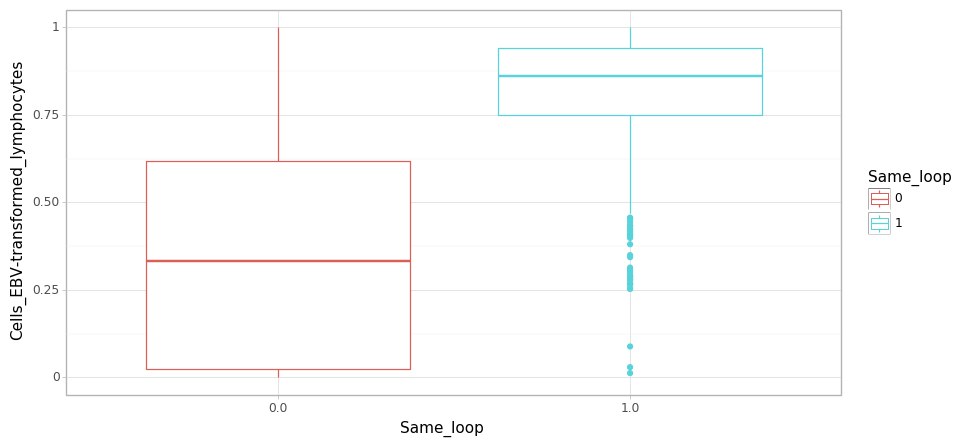

<ggplot: (2978514102884)>

In [1228]:
x='Same_loop'
y=target
plotdata=ML_data[[x,y]].fillna(0)
plotdata[x]=plotdata.astype(object)
(
    ggplot(plotdata,aes(x=x,y=y,colour=x))
    +theme_light()
    +geom_boxplot()
)

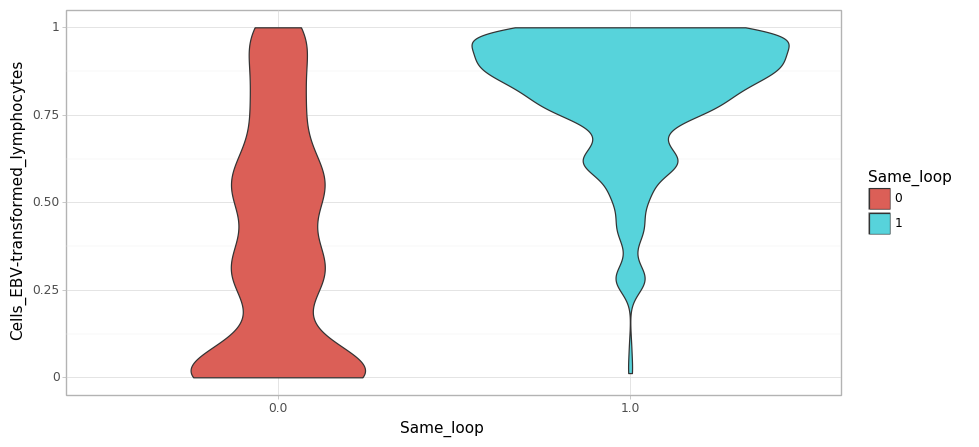

<ggplot: (2978418177118)>

In [1236]:
x='Same_loop'
y=target
plotdata=ML_data[[x,y]].fillna(0)
plotdata[x]=plotdata.astype(object)
(
    ggplot(plotdata,aes(x=x,y=y,fill=x))
    +theme_light()
    +geom_violin()
    #+geom_density(aes(y='stat(count)'),alpha=0.4)
)

In [1099]:
ML_data.columns.to_list()

['contig',
 'start',
 'end',
 'gene_id',
 'eQTL',
 'var_chr',
 'var_pos',
 'Adipose_Subcutaneous_z',
 'Adipose_Visceral_Omentum_z',
 'Adrenal_Gland_z',
 'Artery_Aorta_z',
 'Artery_Coronary_z',
 'Artery_Tibial_z',
 'Brain_Amygdala_z',
 'Brain_Anterior_cingulate_cortex_BA24_z',
 'Brain_Caudate_basal_ganglia_z',
 'Brain_Cerebellar_Hemisphere_z',
 'Brain_Cerebellum_z',
 'Brain_Cortex_z',
 'Brain_Frontal_Cortex_BA9_z',
 'Brain_Hippocampus_z',
 'Brain_Hypothalamus_z',
 'Brain_Nucleus_accumbens_basal_ganglia_z',
 'Brain_Putamen_basal_ganglia_z',
 'Brain_Spinal_cord_cervical_c-1_z',
 'Brain_Substantia_nigra_z',
 'Breast_Mammary_Tissue_z',
 'Cells_Cultured_fibroblasts_z',
 'Cells_EBV-transformed_lymphocytes',
 'Colon_Sigmoid_z',
 'Colon_Transverse_z',
 'Esophagus_Gastroesophageal_Junction_z',
 'Esophagus_Mucosa_z',
 'Esophagus_Muscularis_z',
 'Heart_Atrial_Appendage_z',
 'Heart_Left_Ventricle_z',
 'Kidney_Cortex_z',
 'Liver_z',
 'Lung_z',
 'Minor_Salivary_Gland_z',
 'Muscle_Skeletal_z',
 'Nerve

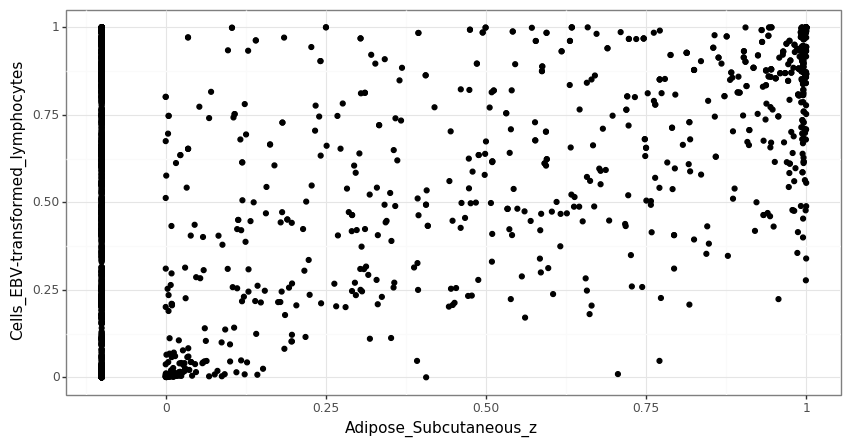

<ggplot: (2978335579543)>


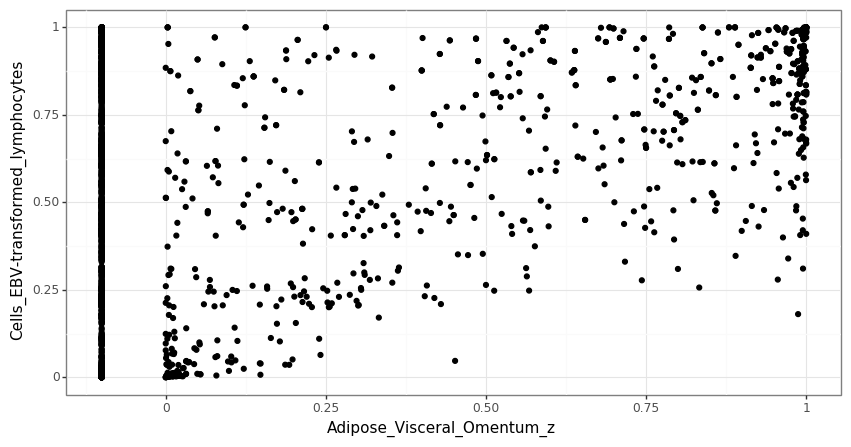

<ggplot: (2978347205675)>


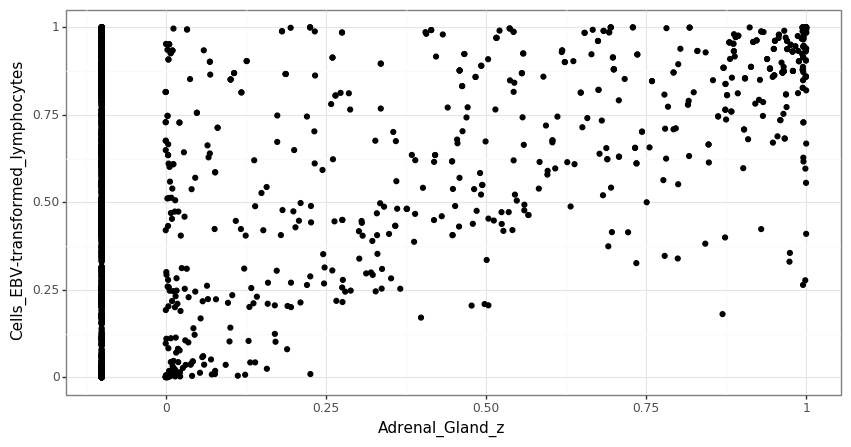

<ggplot: (2978502819247)>


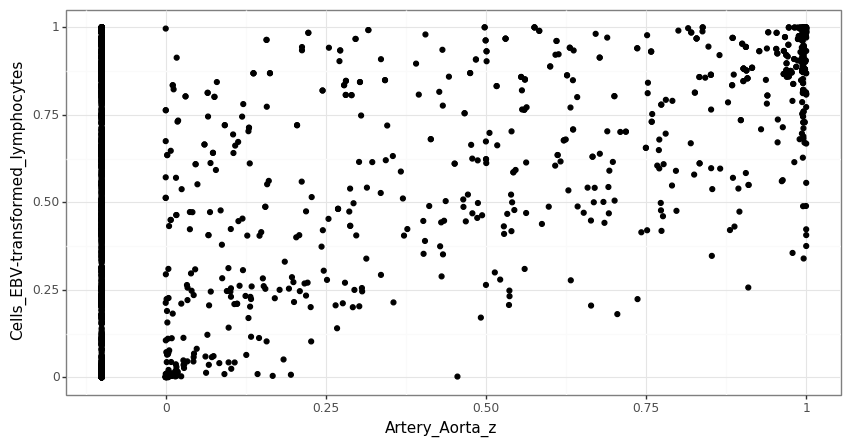

<ggplot: (2978348030829)>


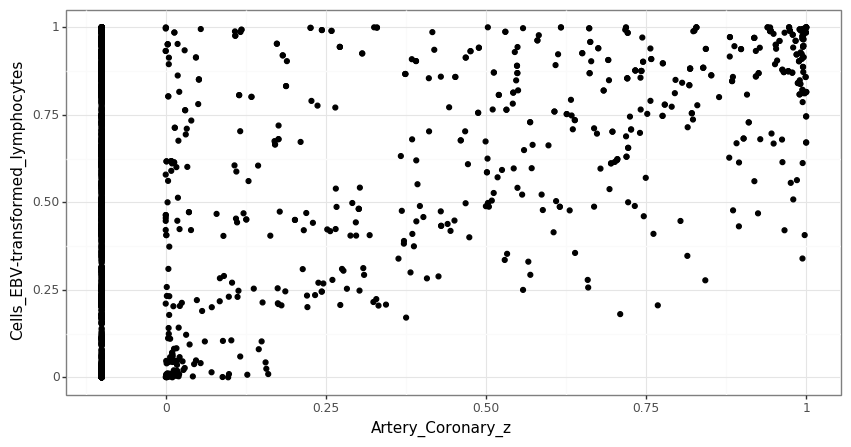

<ggplot: (2978440195217)>


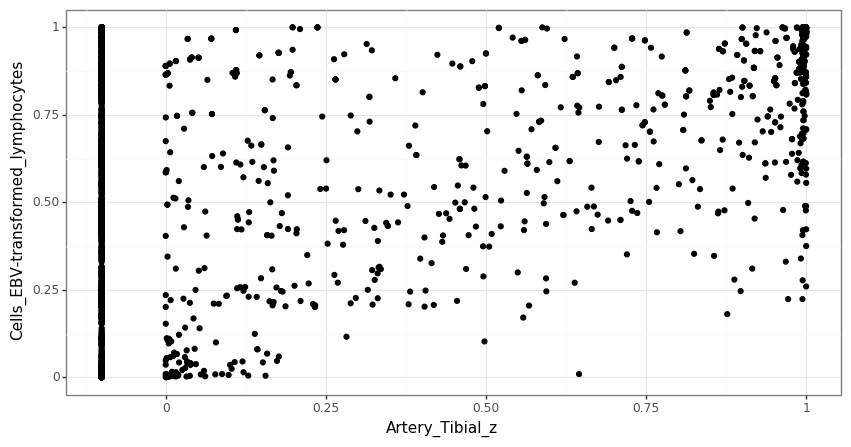

<ggplot: (2978346990460)>


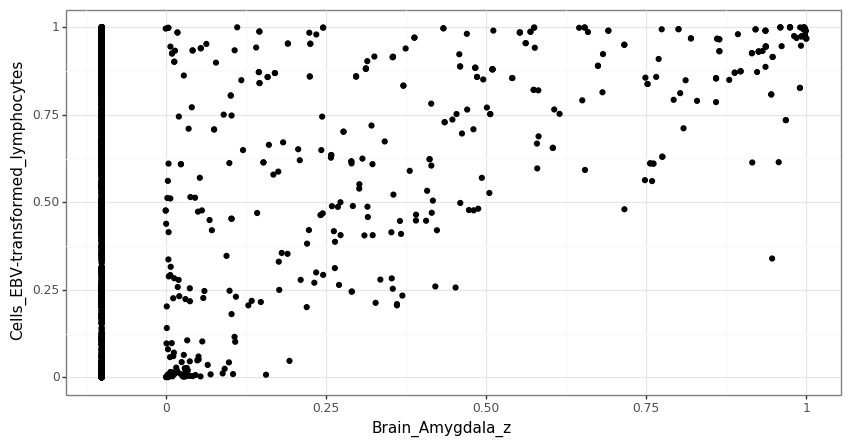

<ggplot: (2978479080138)>


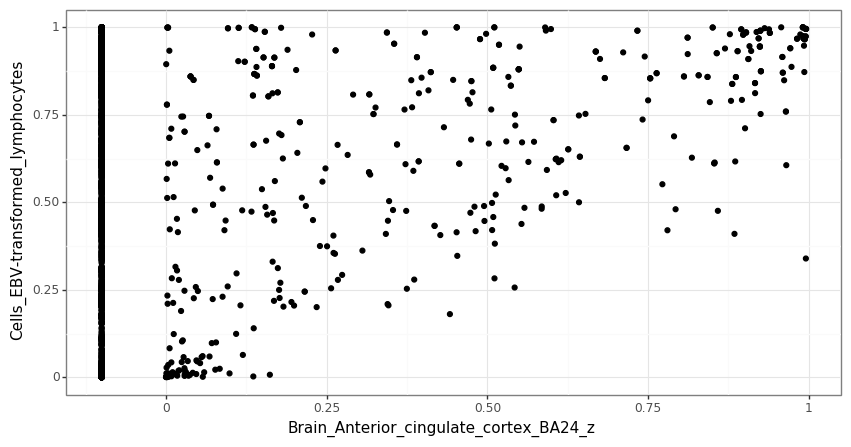

<ggplot: (2978341403609)>


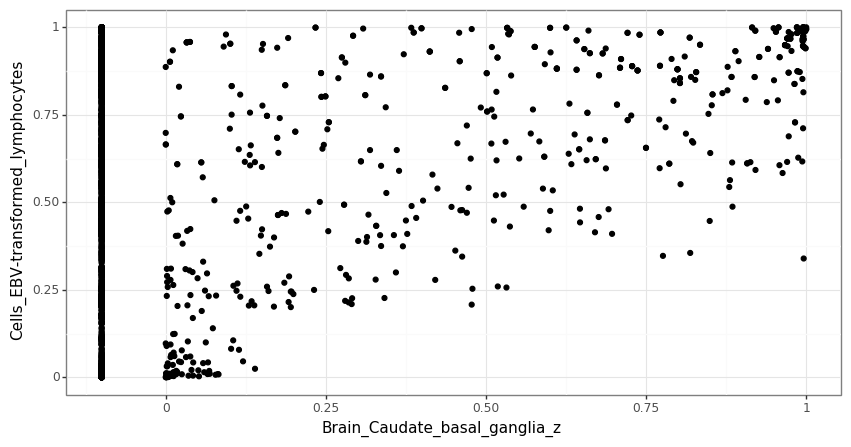

<ggplot: (2978345050950)>


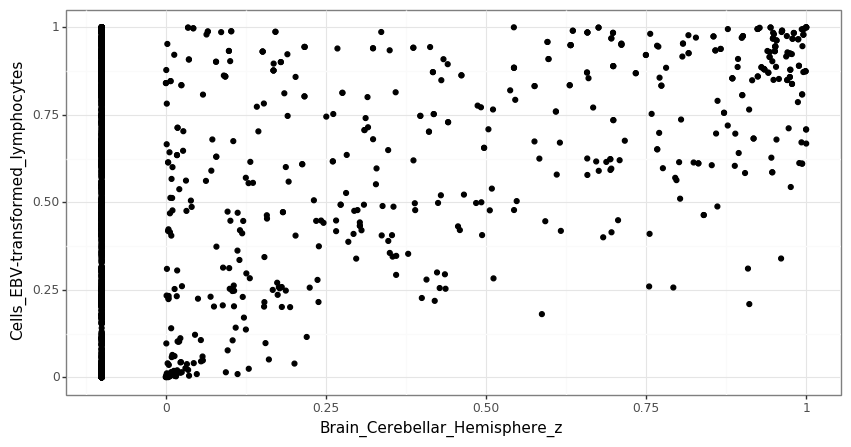

<ggplot: (2978340410763)>


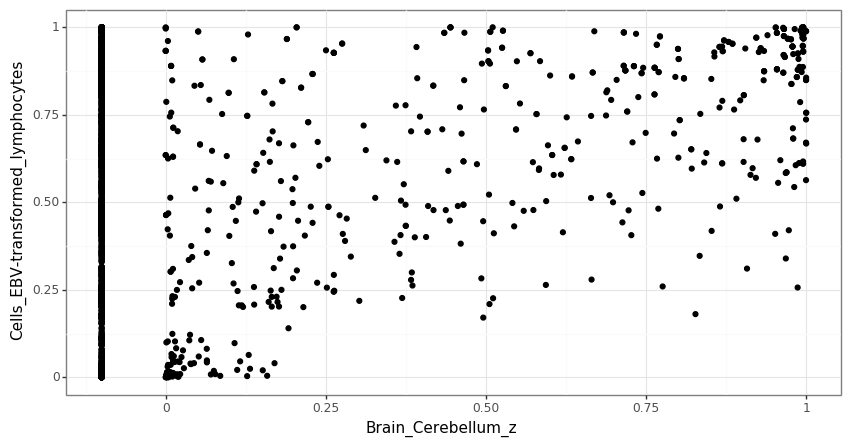

<ggplot: (2978502567108)>


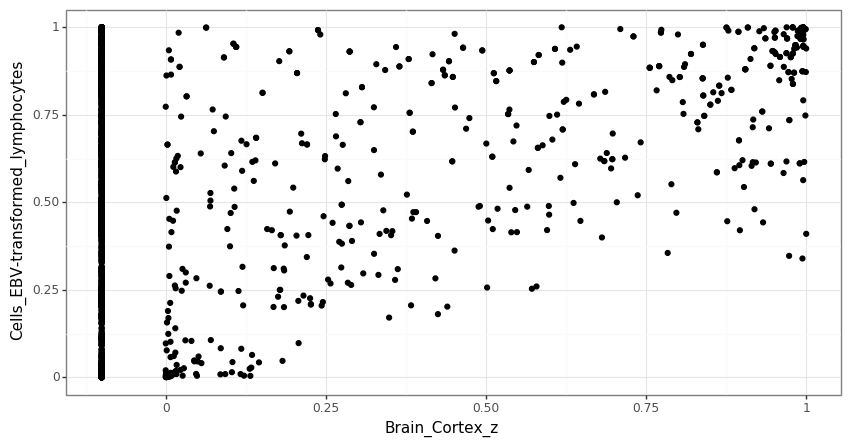

<ggplot: (2978347884975)>


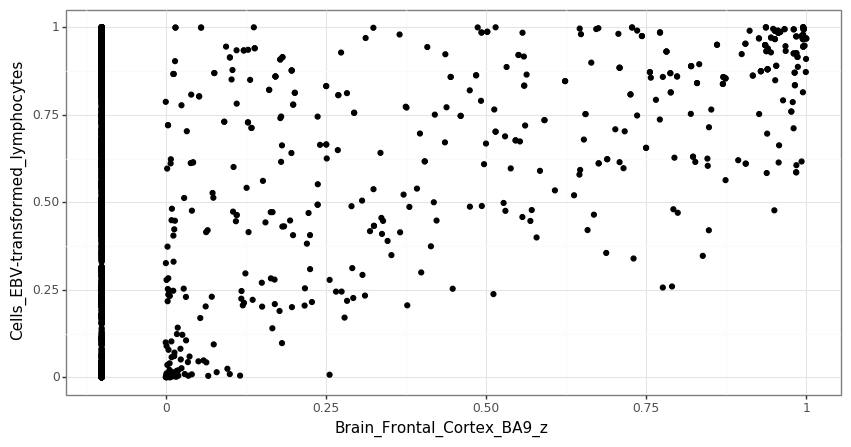

<ggplot: (2978474402579)>


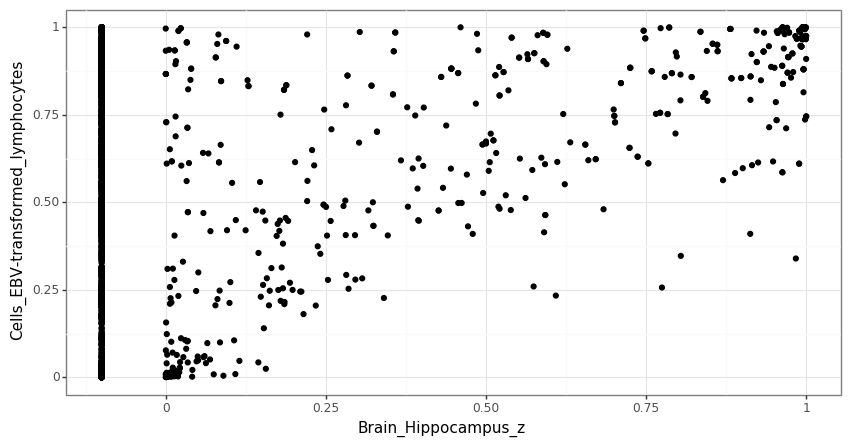

<ggplot: (2978275193257)>


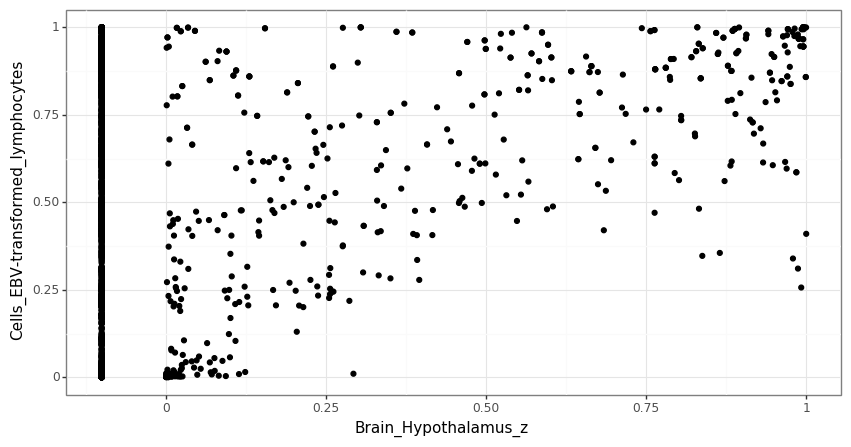

<ggplot: (2978486122367)>


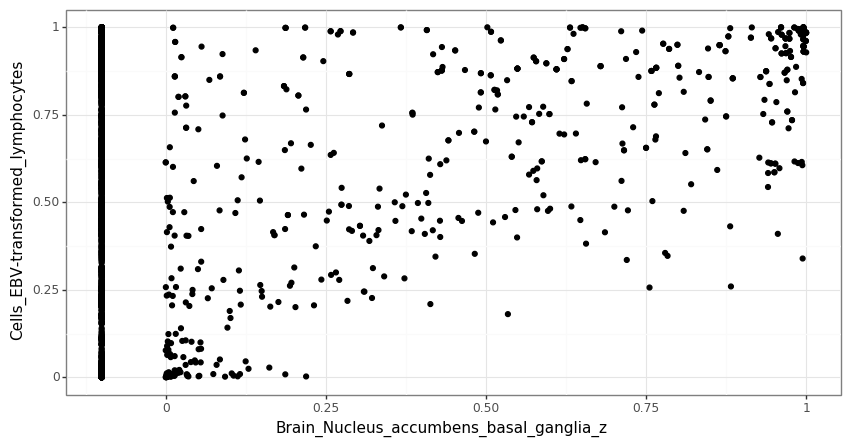

<ggplot: (2978504460445)>


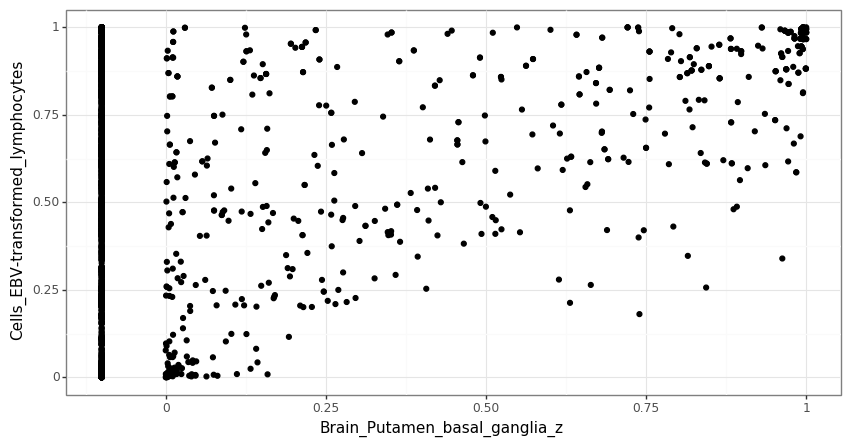

<ggplot: (2978484770211)>


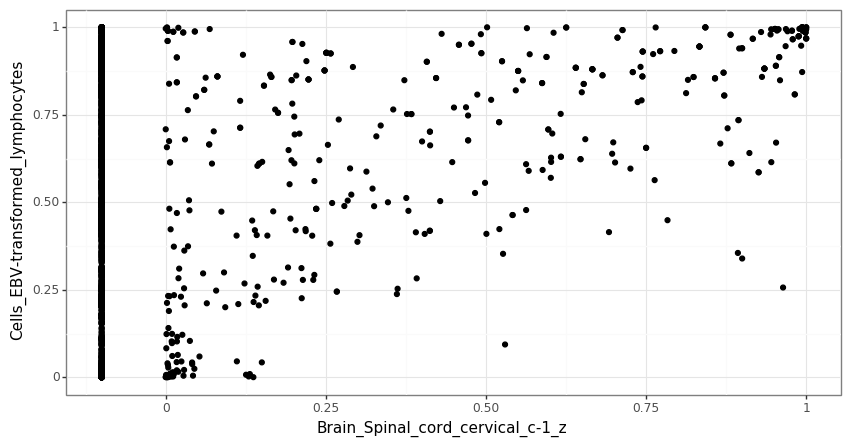

<ggplot: (2978478617613)>


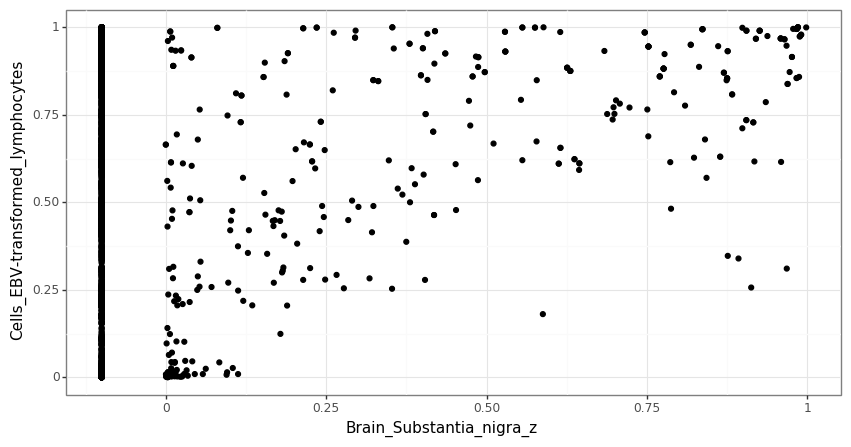

<ggplot: (2978485342739)>


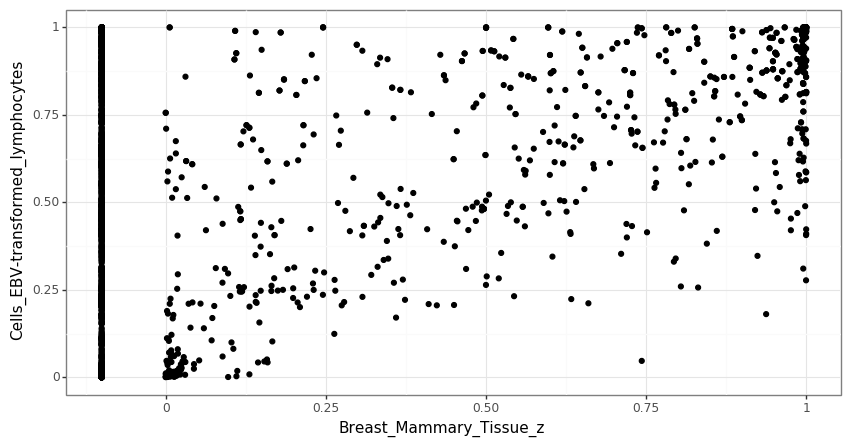

<ggplot: (2978358007092)>


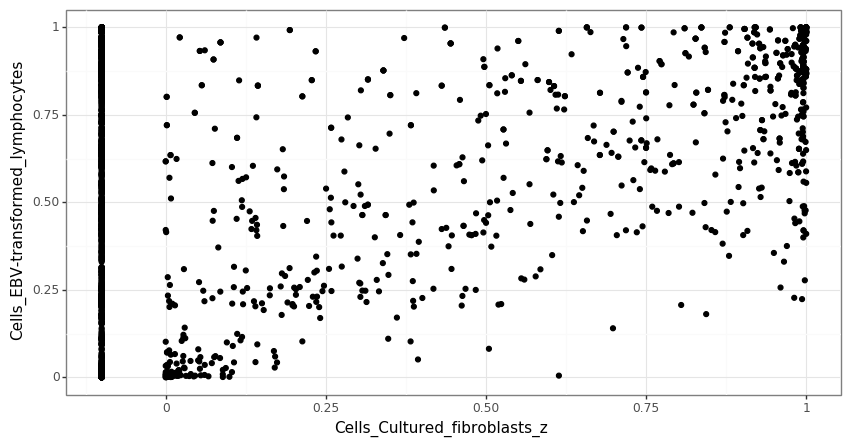

<ggplot: (2978502567108)>


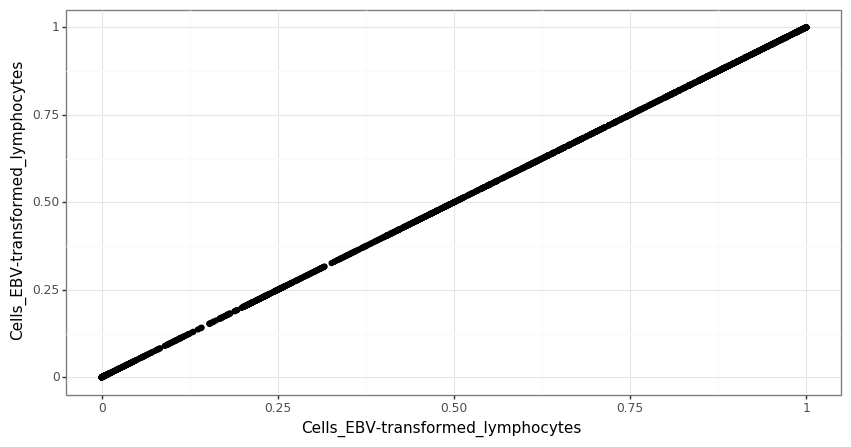

<ggplot: (2978504458382)>


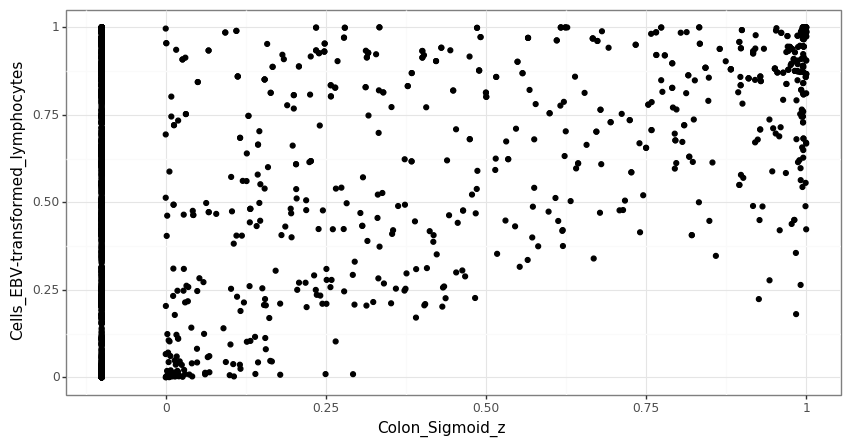

<ggplot: (2978415499243)>


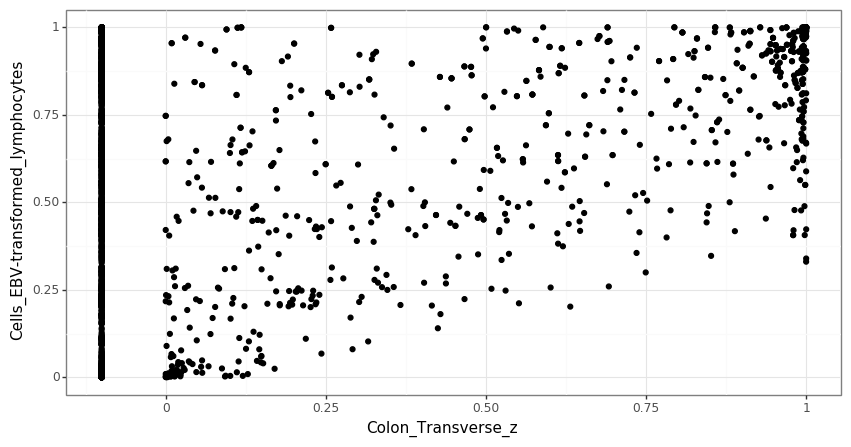

<ggplot: (2978347780512)>


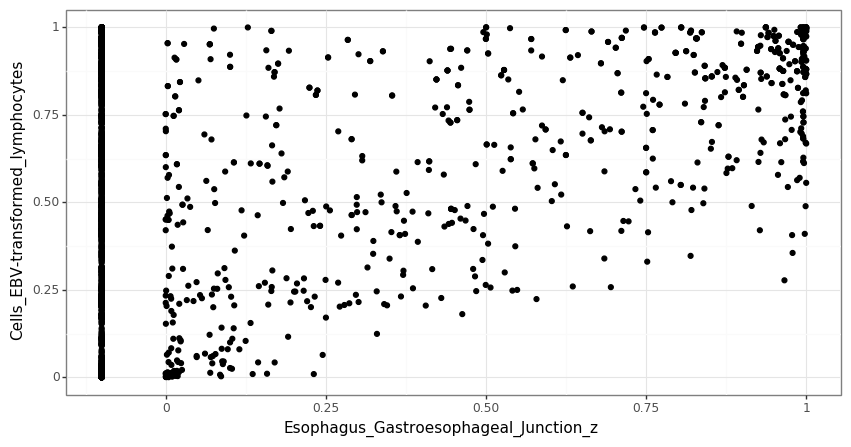

<ggplot: (2978347180385)>


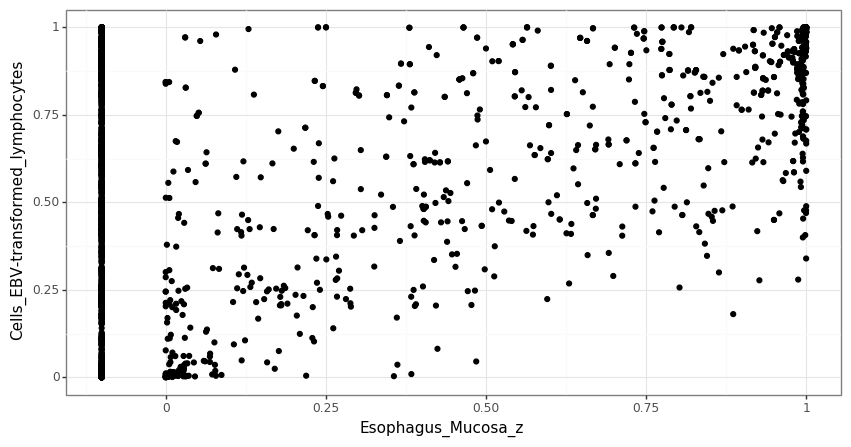

<ggplot: (2978488186920)>


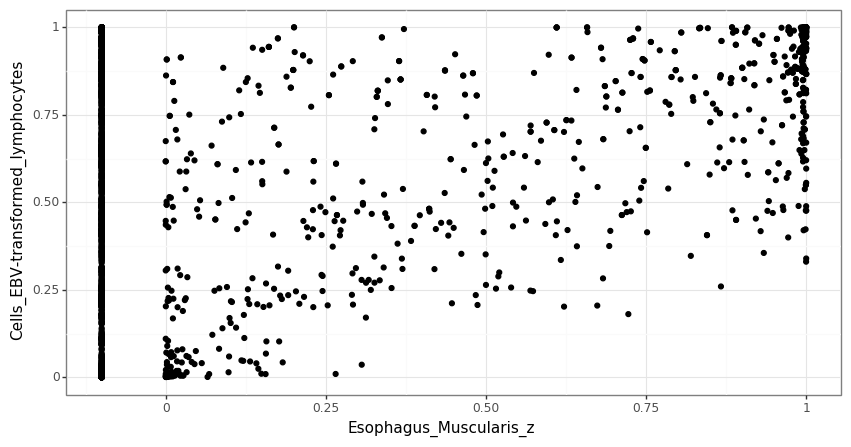

<ggplot: (2978353830647)>


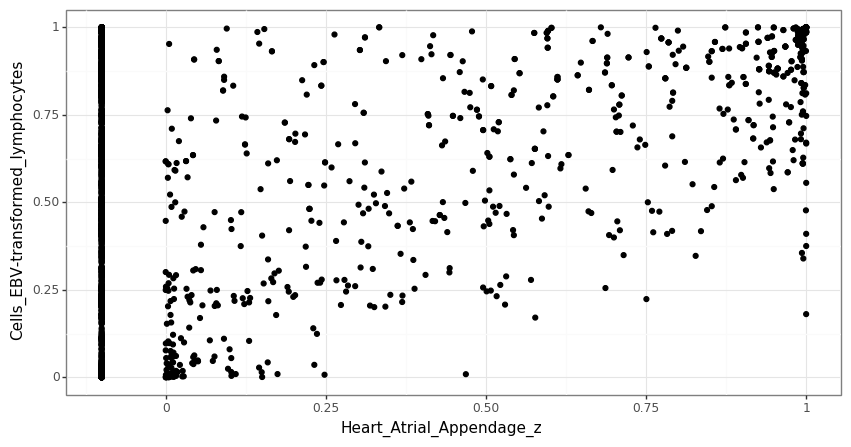

<ggplot: (2978487627674)>


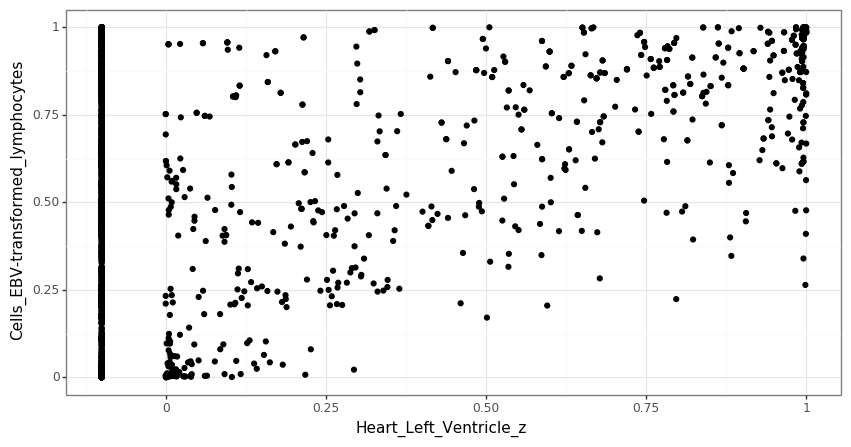

<ggplot: (2978418177046)>


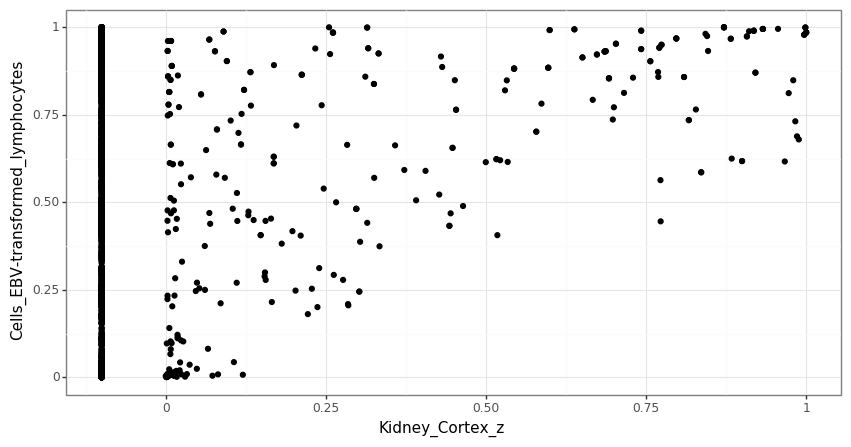

<ggplot: (2978418807257)>


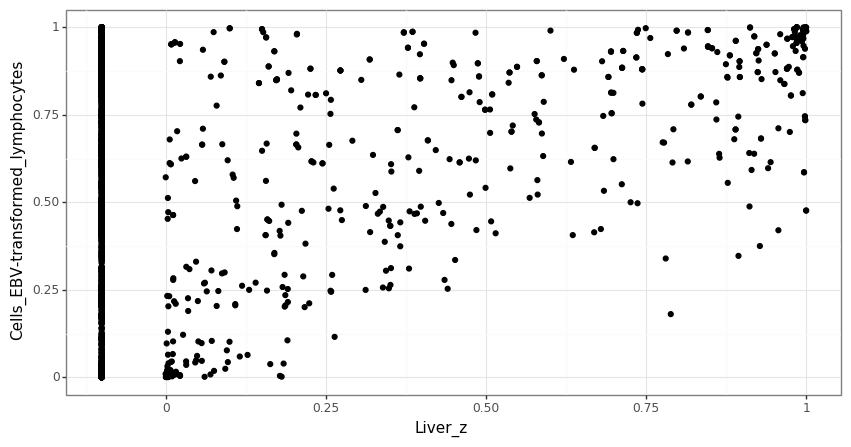

<ggplot: (2978353762030)>


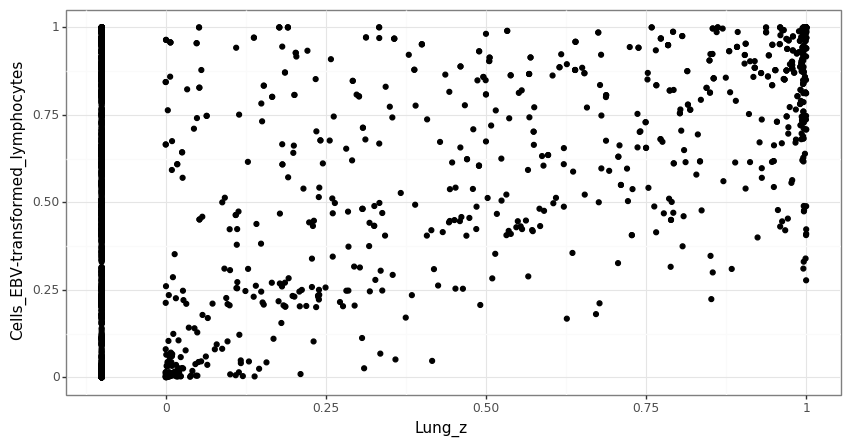

<ggplot: (2978356112550)>


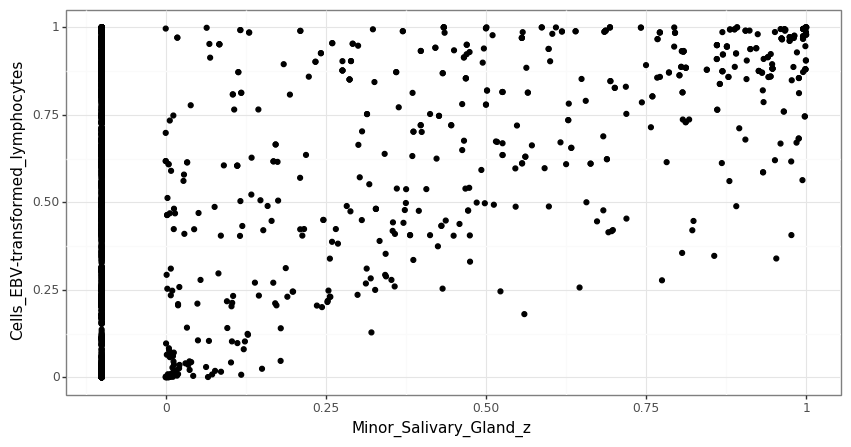

<ggplot: (2978388669296)>


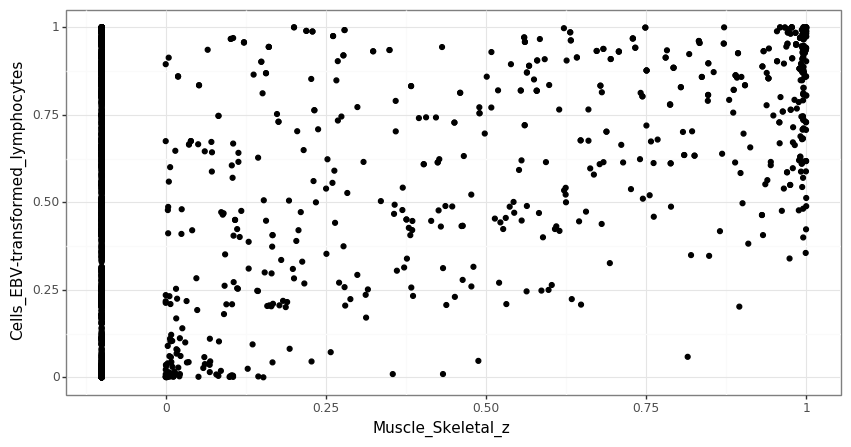

<ggplot: (2978347782364)>


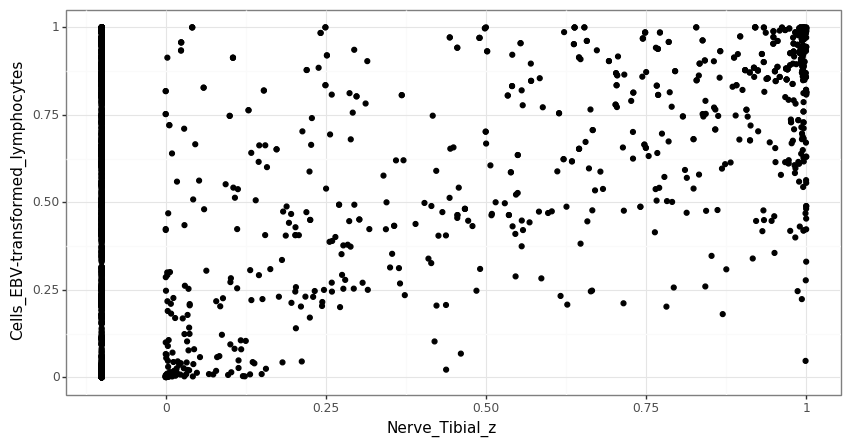

<ggplot: (2978344476182)>


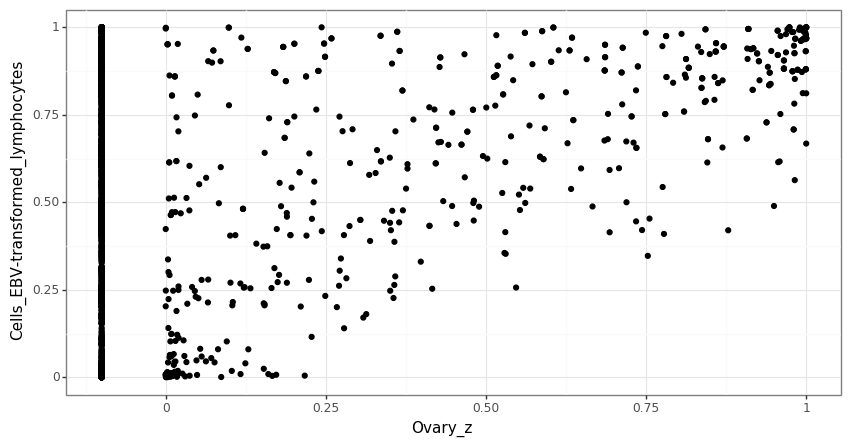

<ggplot: (2978529920687)>


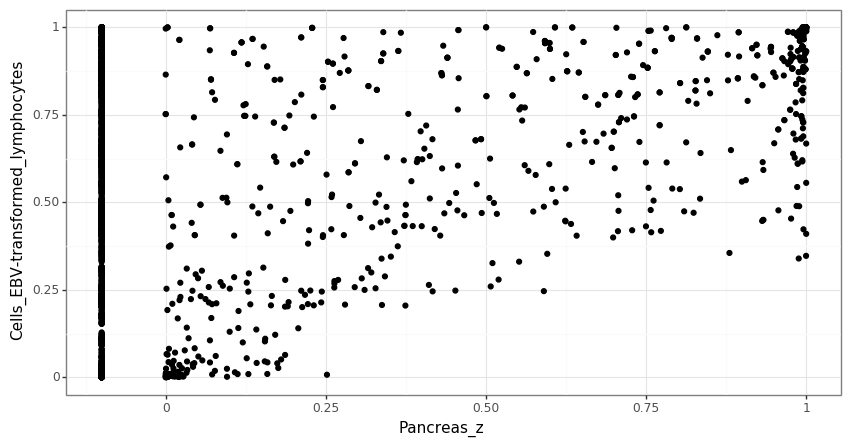

<ggplot: (2978529738099)>


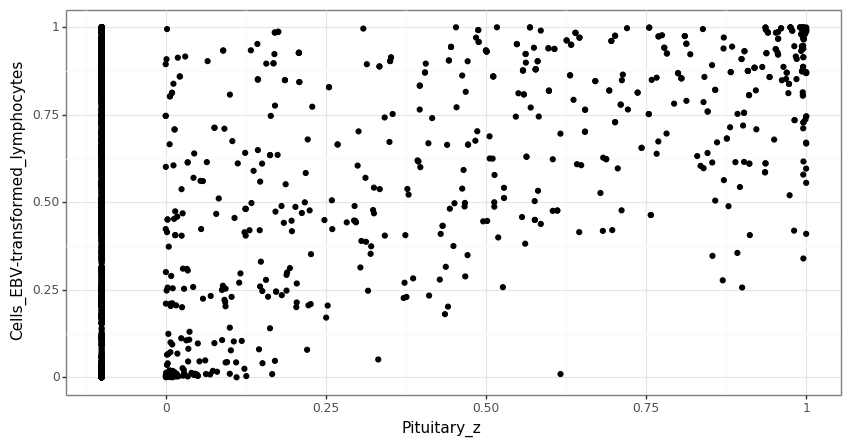

<ggplot: (2978356445582)>


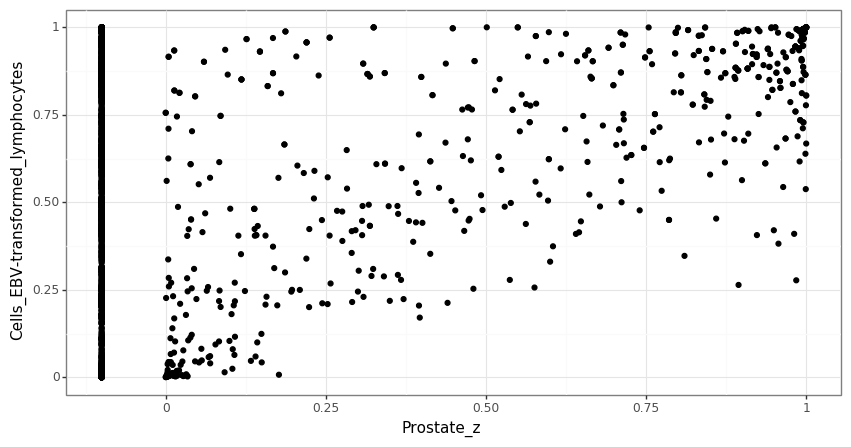

<ggplot: (2978515659132)>


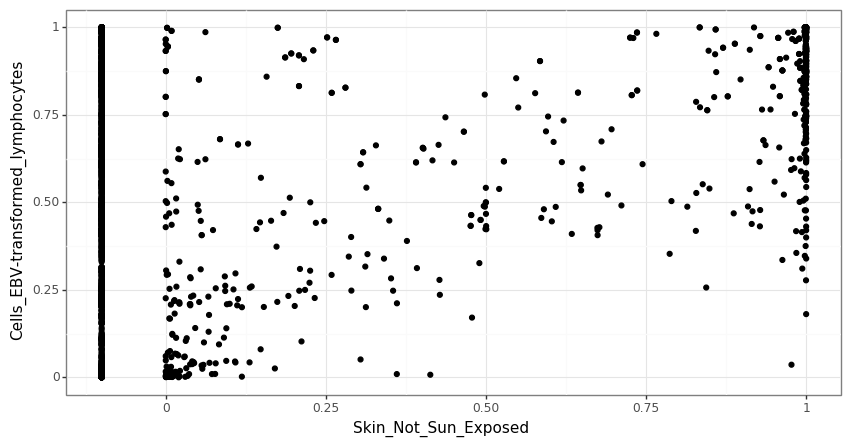

<ggplot: (2978515151580)>


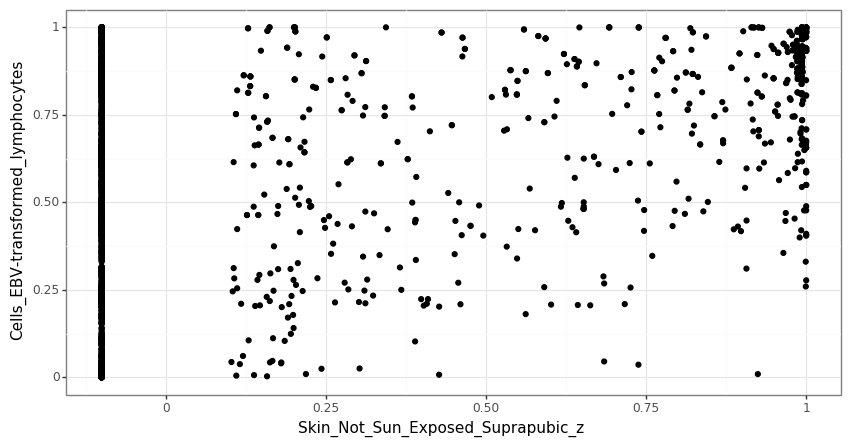

<ggplot: (2978515642597)>


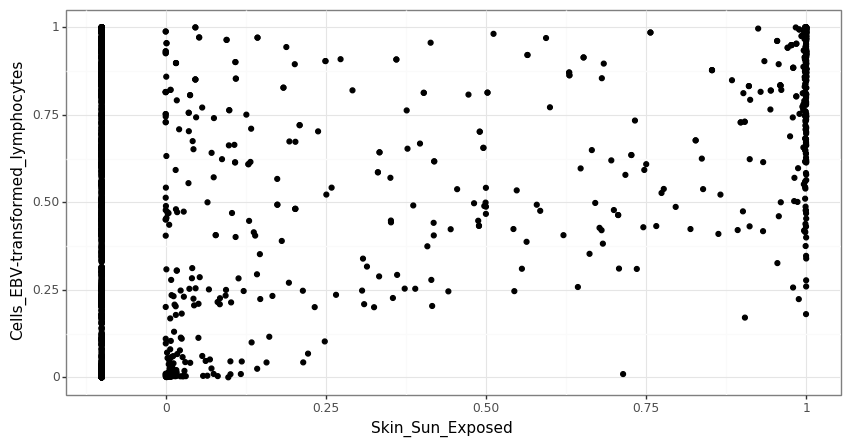

<ggplot: (2978515582239)>


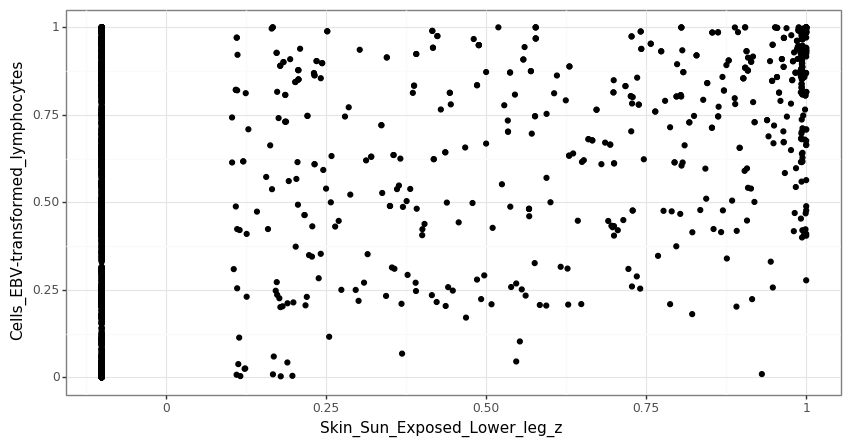

<ggplot: (2978529665919)>


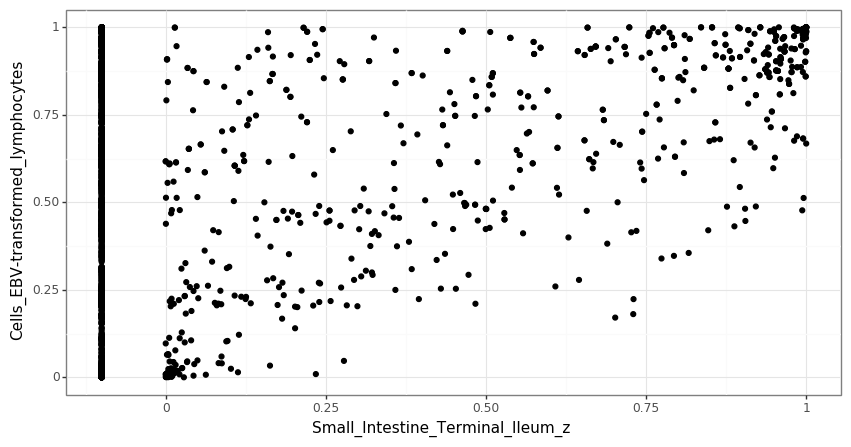

<ggplot: (2978515520690)>


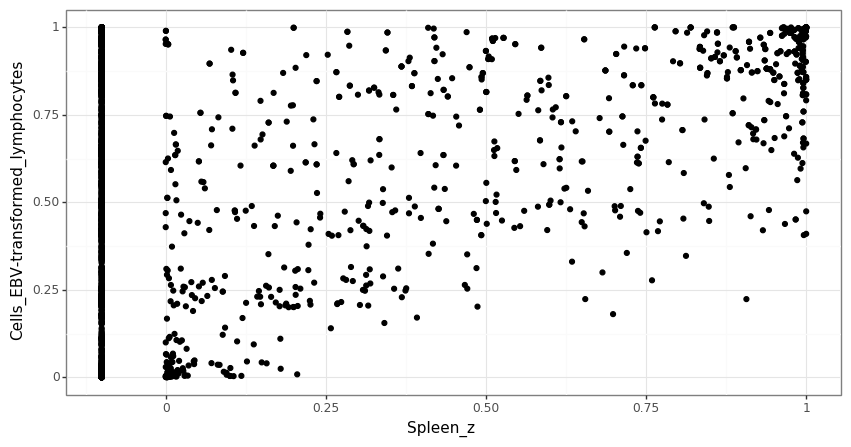

<ggplot: (2978515514037)>


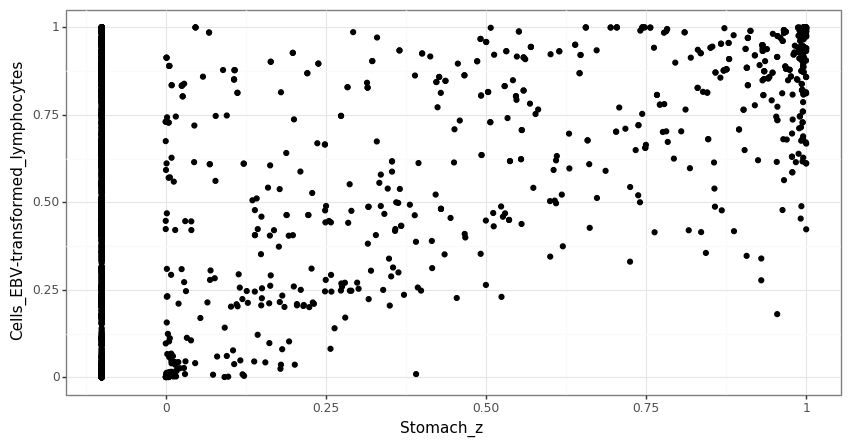

<ggplot: (2978515597496)>


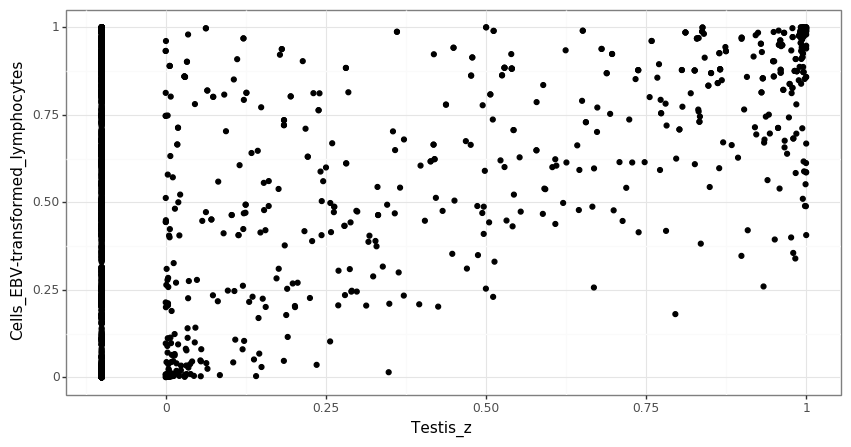

<ggplot: (2978515553973)>


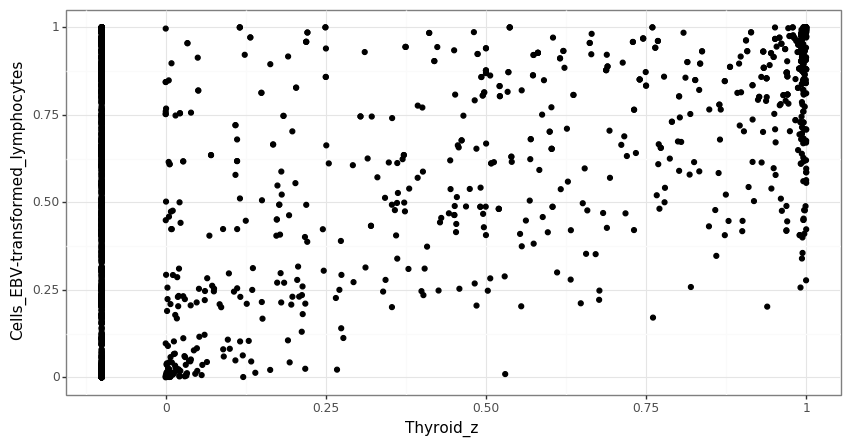

<ggplot: (2978515391034)>


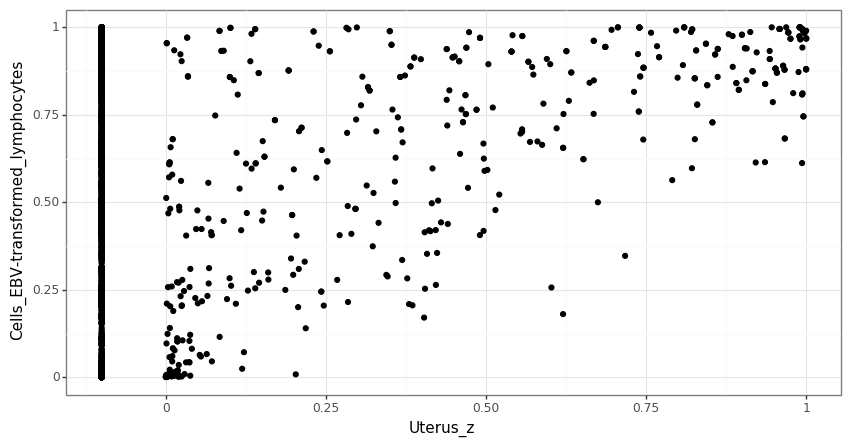

<ggplot: (2978515385552)>


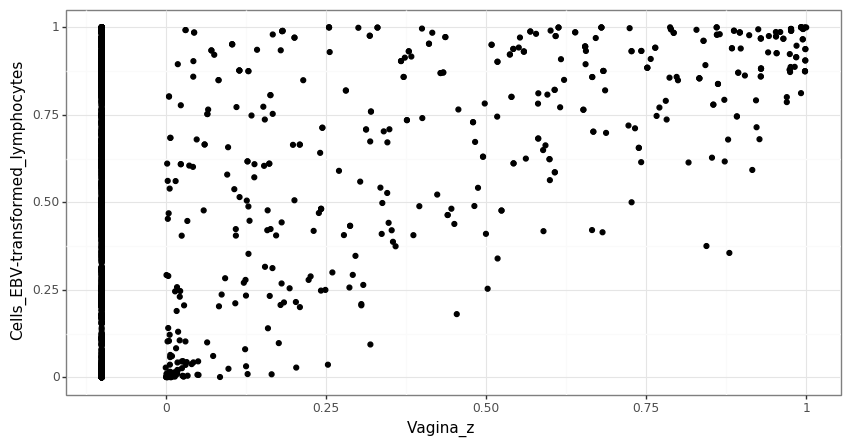

<ggplot: (2978515420754)>


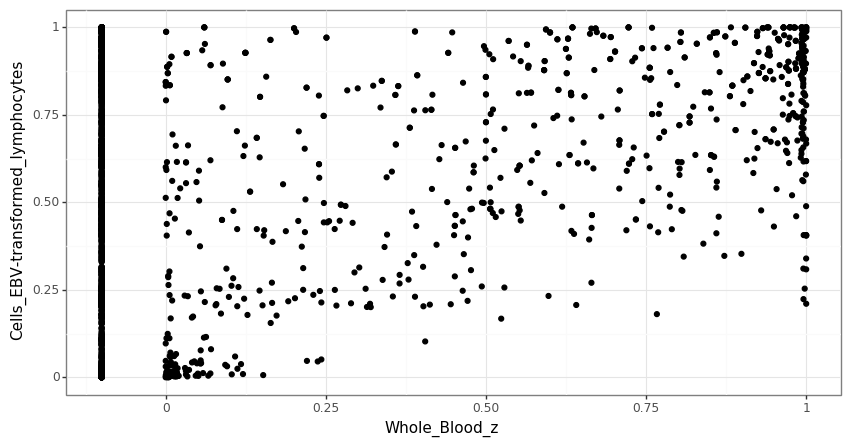

<ggplot: (2978515439210)>


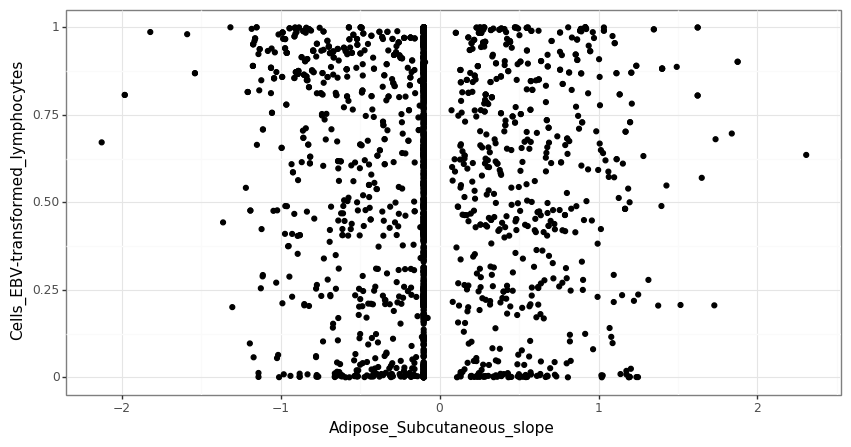

<ggplot: (2978515321549)>


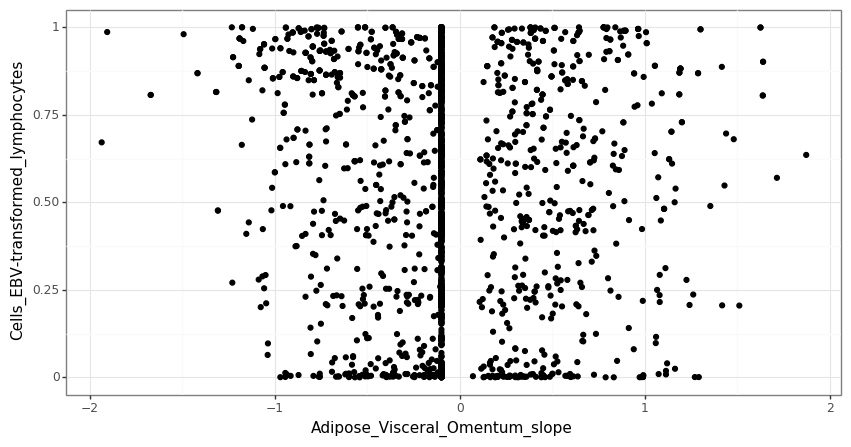

<ggplot: (2978515302632)>


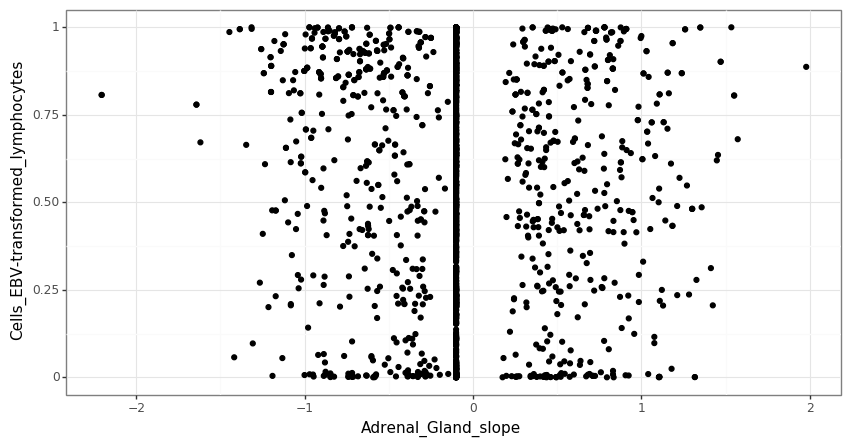

<ggplot: (2978515354968)>


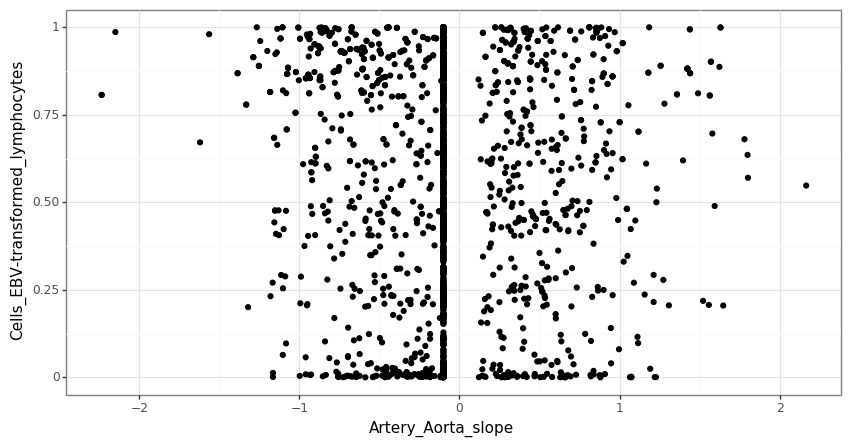

<ggplot: (2978514711360)>


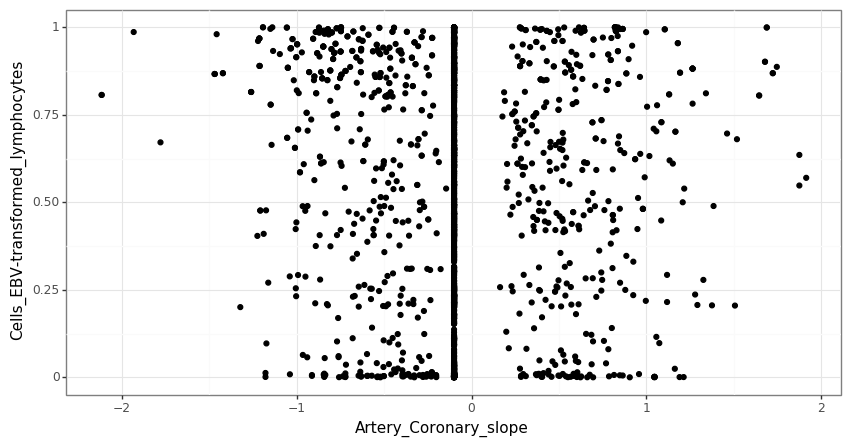

<ggplot: (2978515402418)>


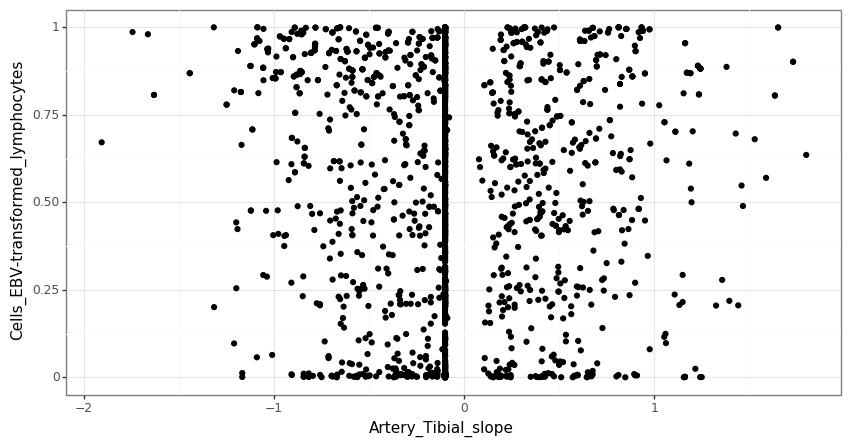

<ggplot: (2978515621922)>


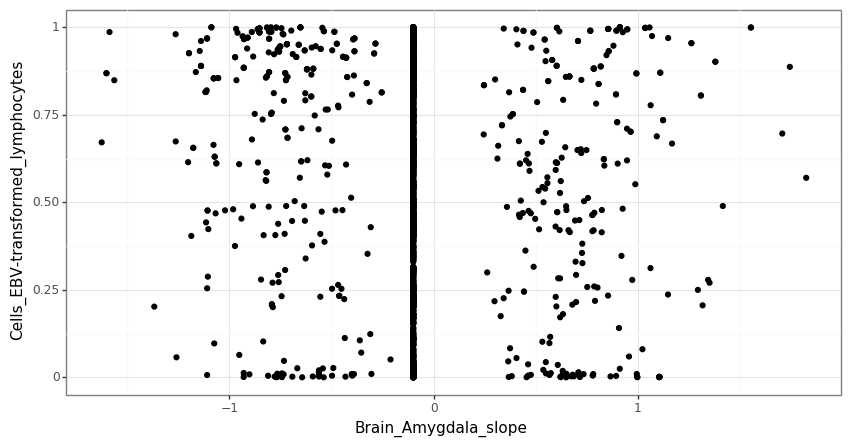

<ggplot: (2978515434364)>


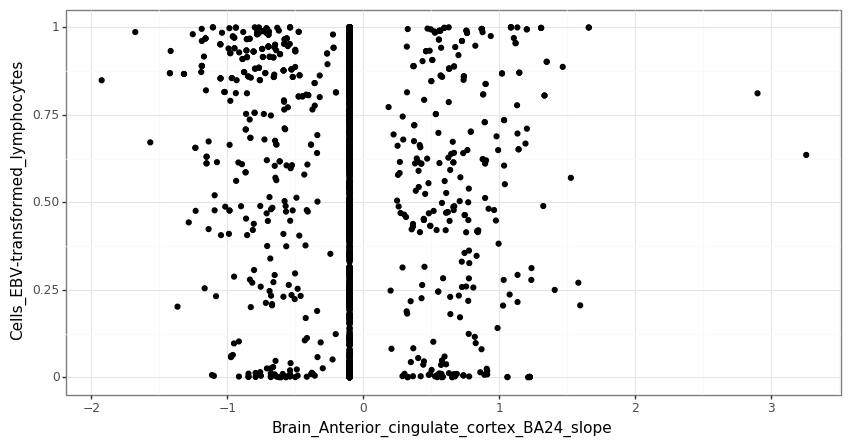

<ggplot: (2978514991234)>


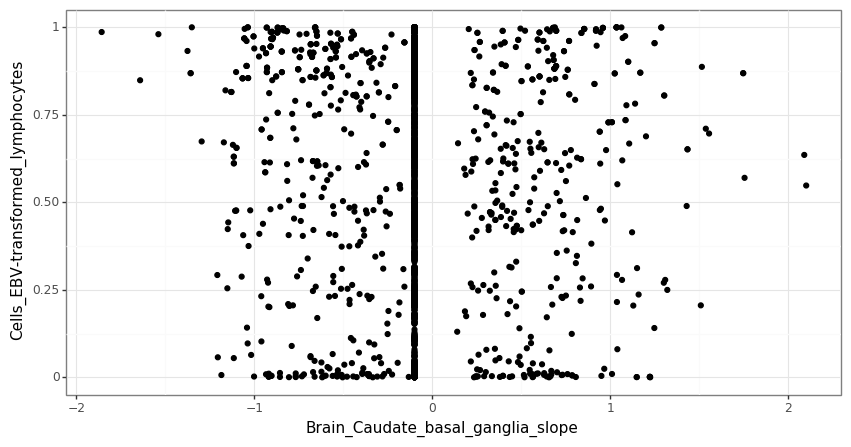

<ggplot: (2978515202961)>


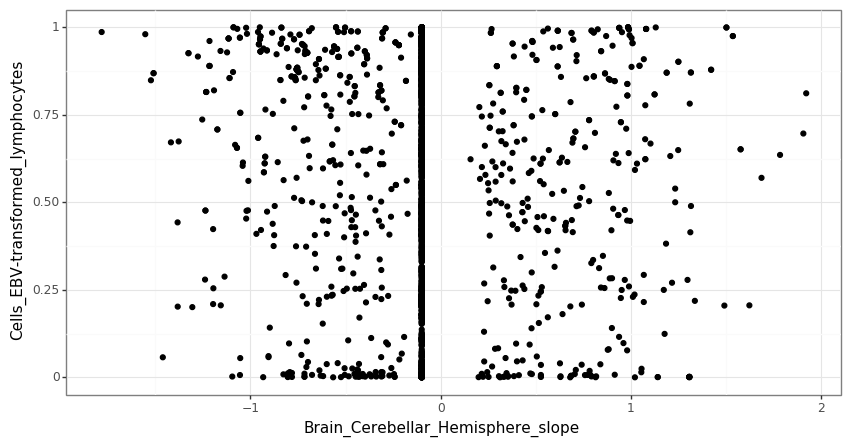

<ggplot: (2978514957933)>


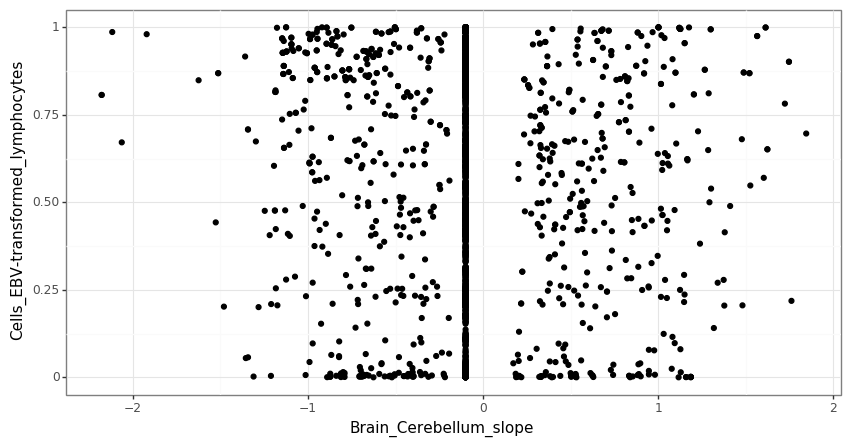

<ggplot: (2978514920292)>


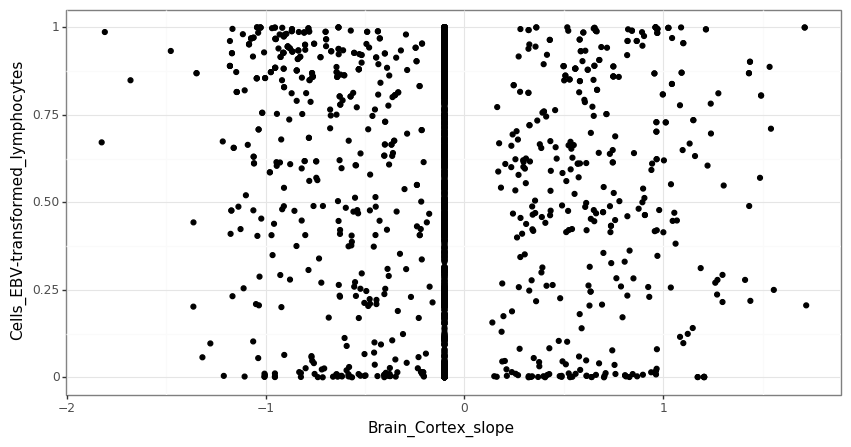

<ggplot: (2978514330745)>


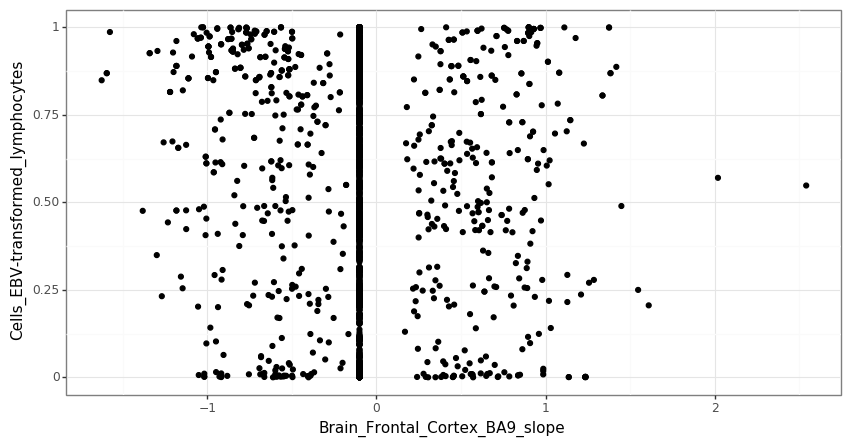

<ggplot: (2978514828310)>


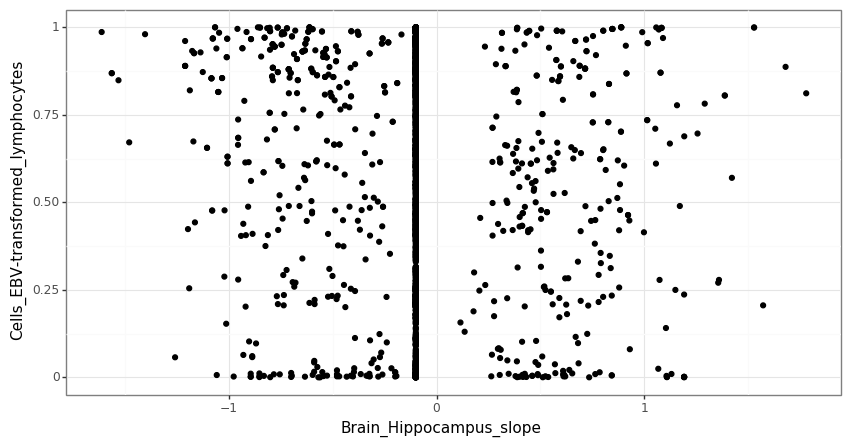

<ggplot: (2978515302632)>


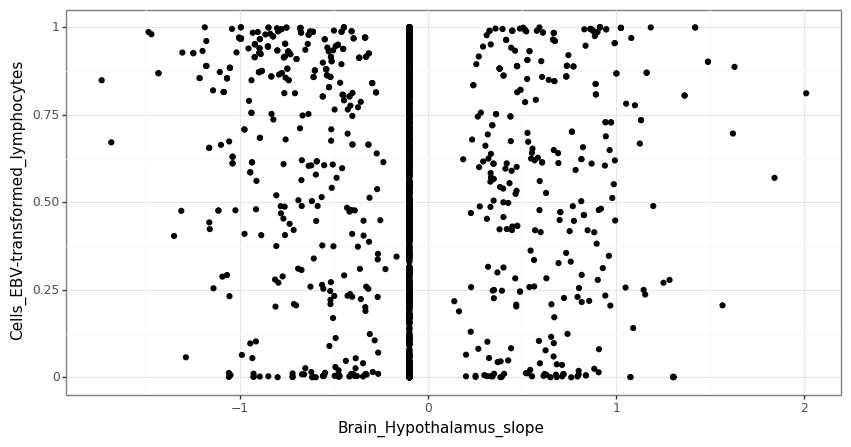

<ggplot: (2978514793226)>


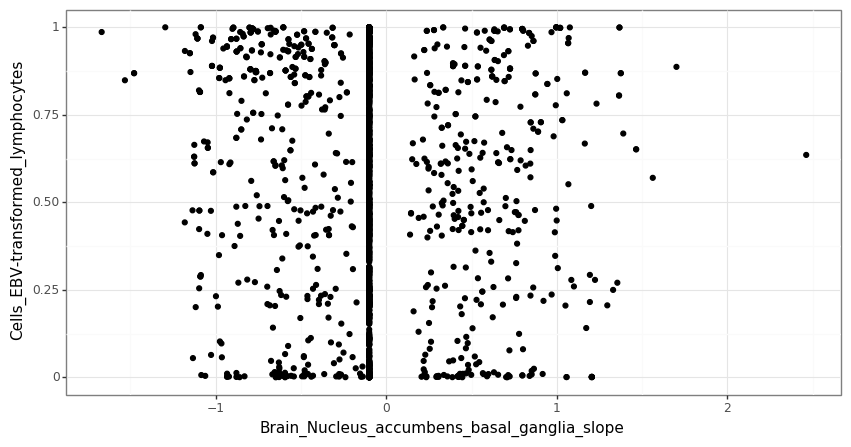

<ggplot: (2978515109331)>


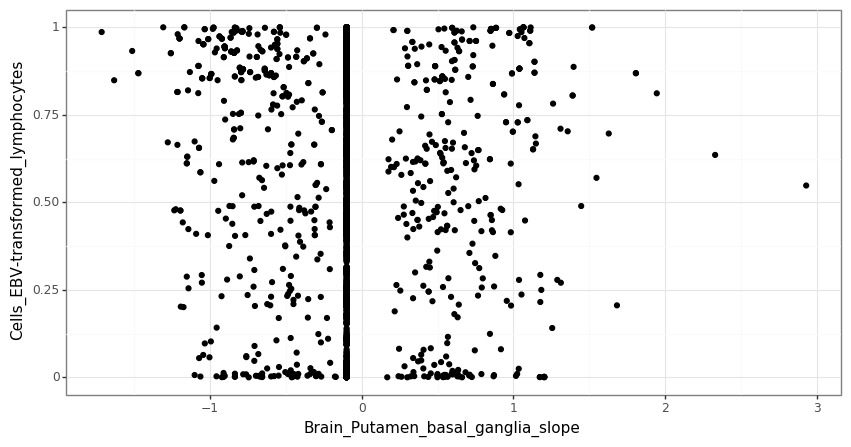

<ggplot: (2978514715474)>


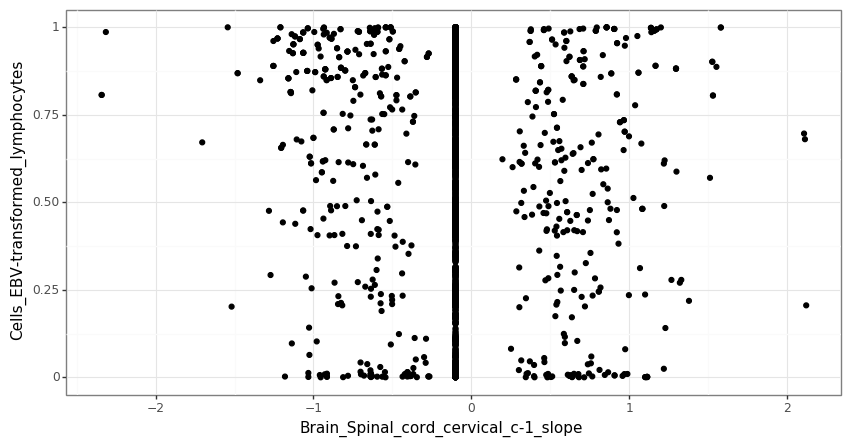

<ggplot: (2978514641330)>


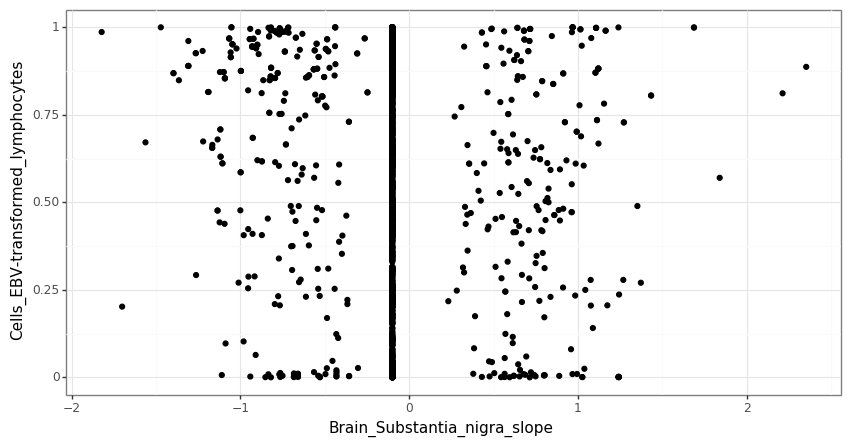

<ggplot: (2978514866089)>


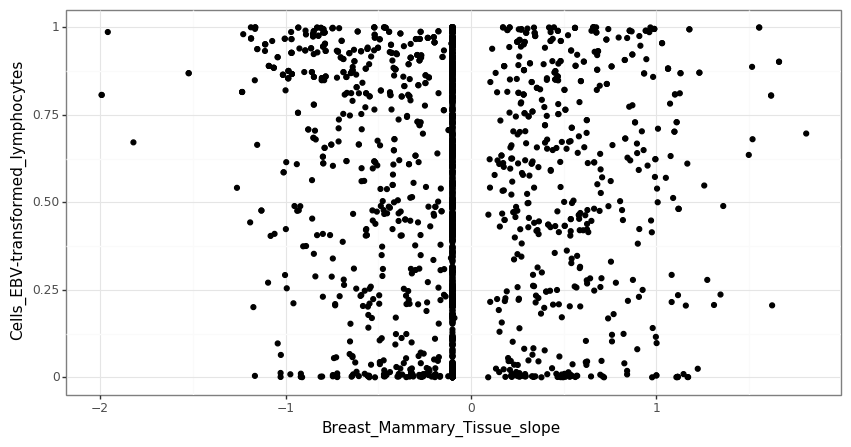

<ggplot: (2978514818708)>


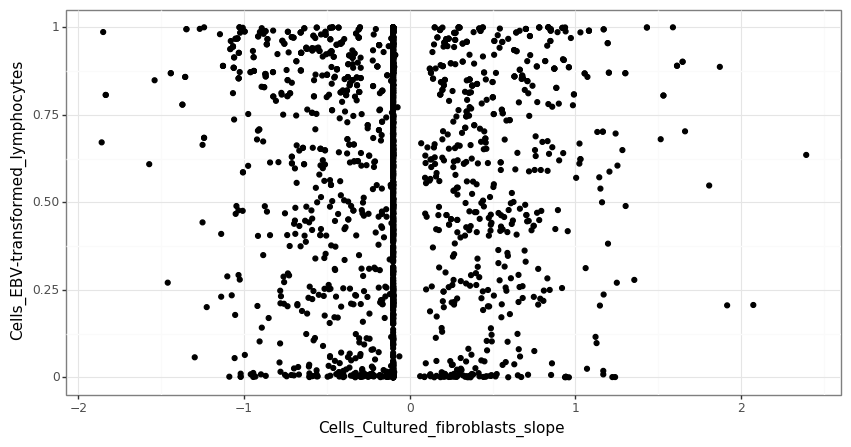

<ggplot: (2978514784708)>


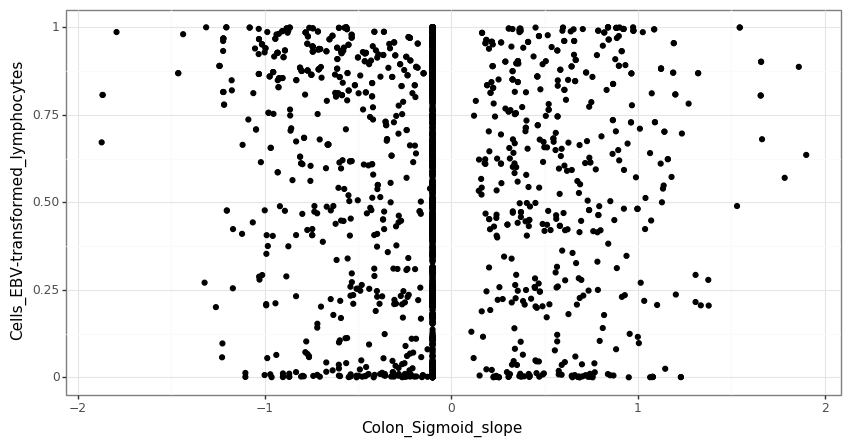

<ggplot: (2978514509213)>


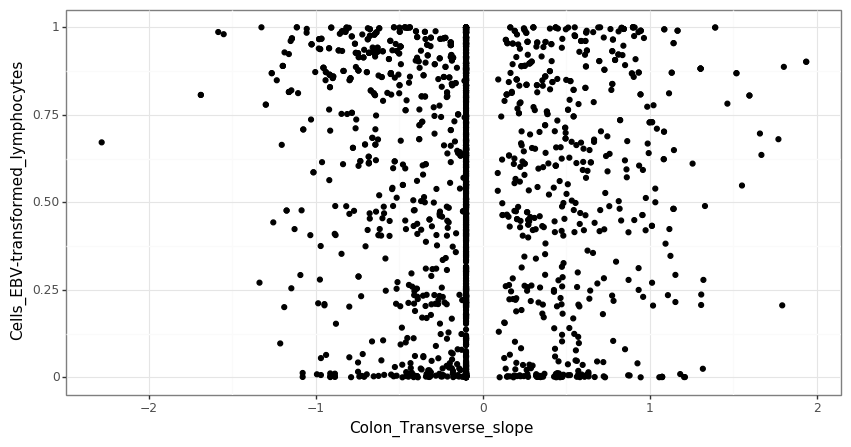

<ggplot: (2978514481083)>


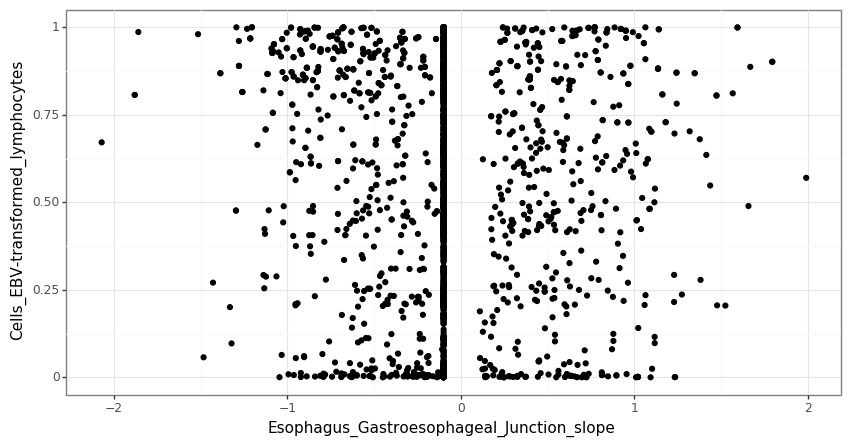

<ggplot: (2978514420086)>


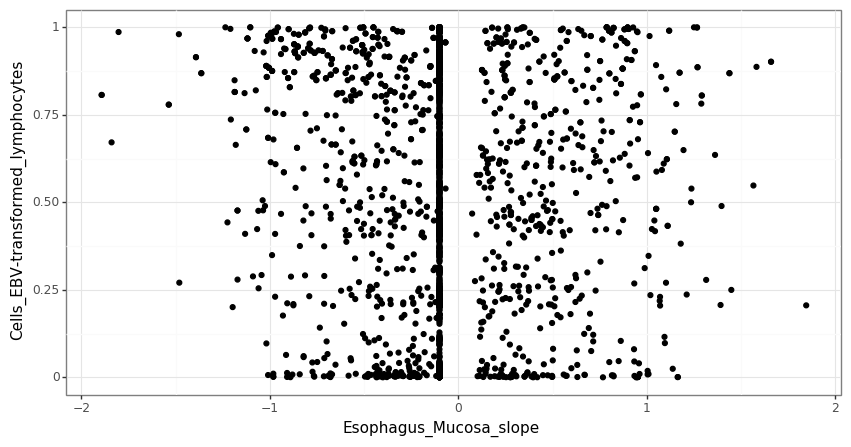

<ggplot: (2978514394070)>


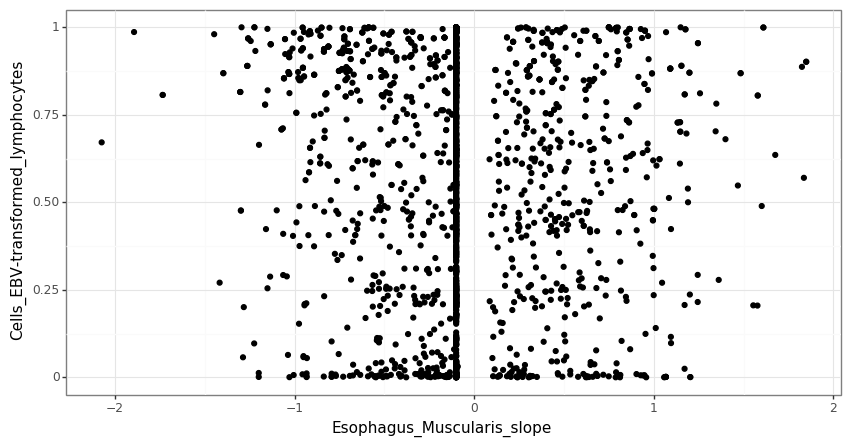

<ggplot: (2978514554254)>


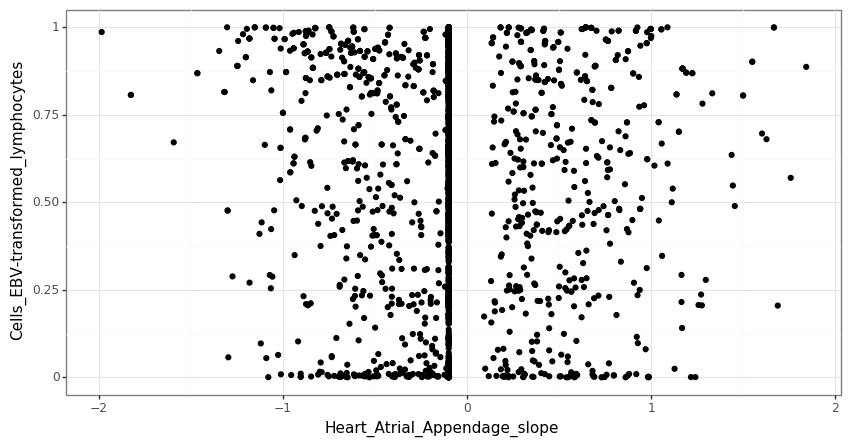

<ggplot: (2978514393917)>


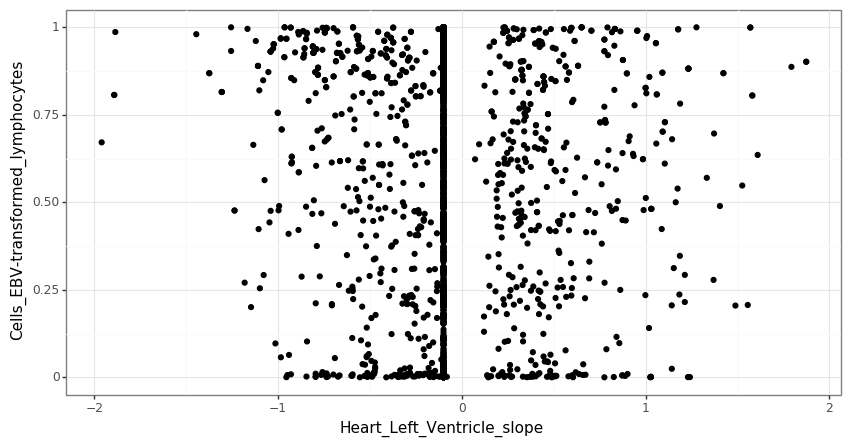

<ggplot: (2978514170965)>


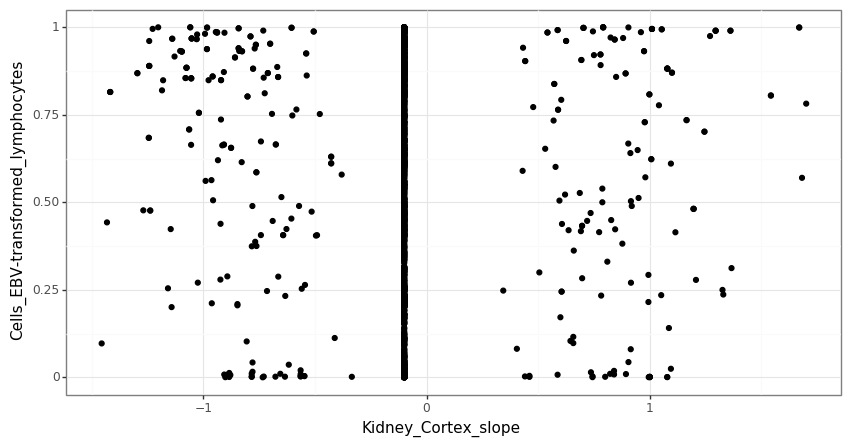

<ggplot: (2978514141751)>


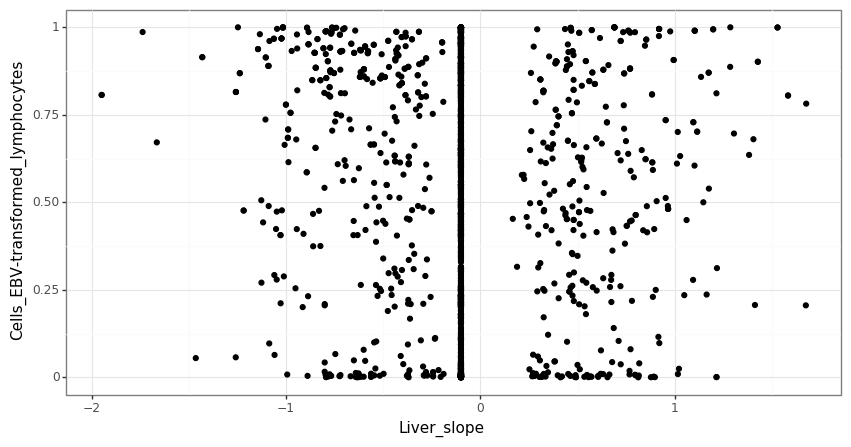

<ggplot: (2978336645105)>


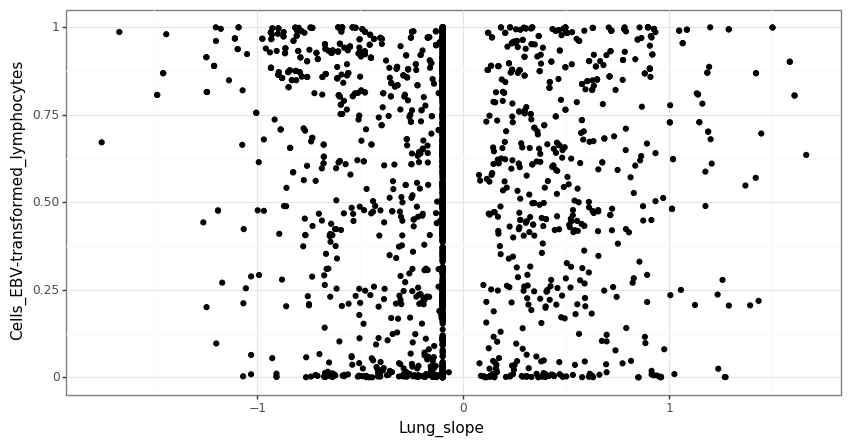

<ggplot: (2978346918178)>


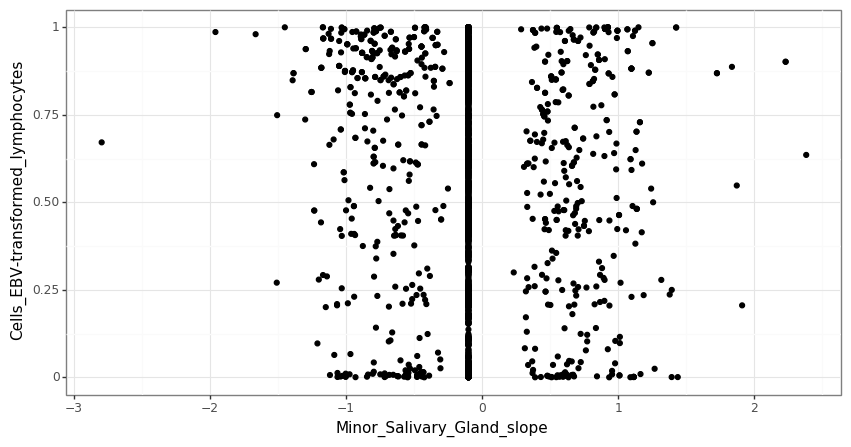

<ggplot: (2978514177546)>


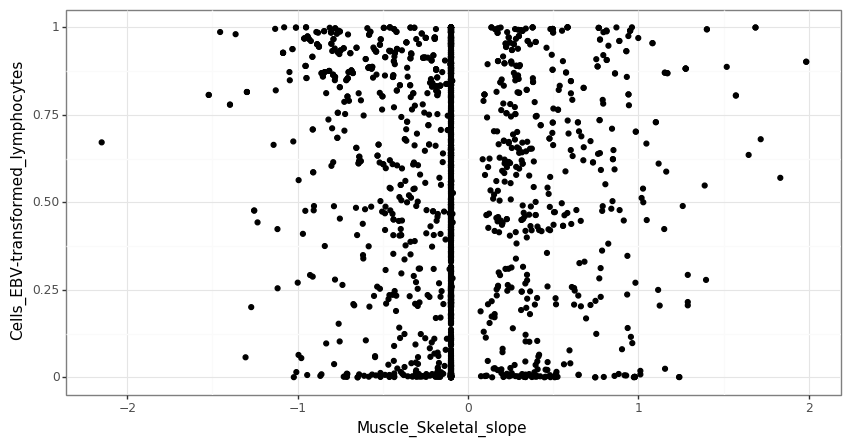

<ggplot: (2978514131134)>


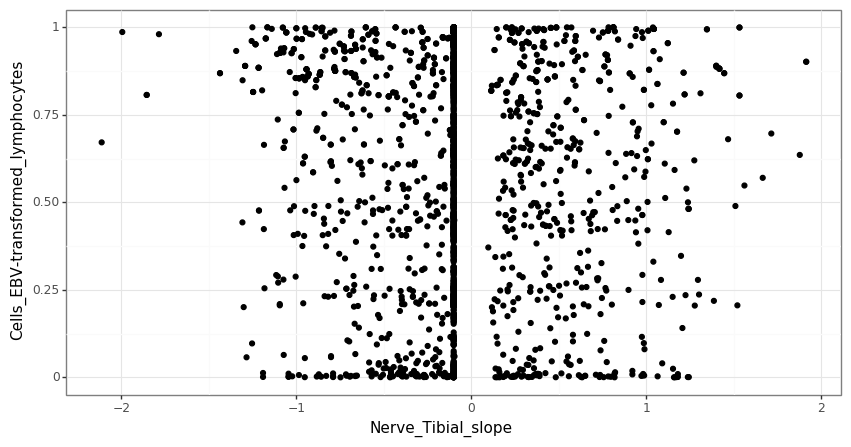

<ggplot: (2978382260264)>


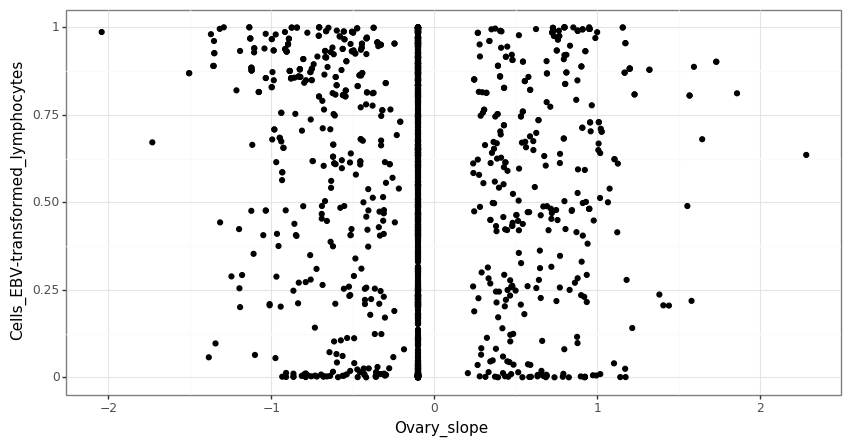

<ggplot: (2978502495519)>


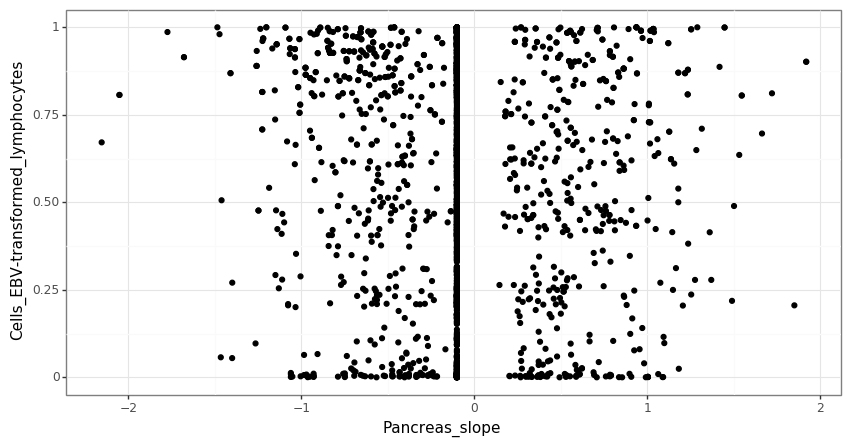

<ggplot: (2978348946812)>


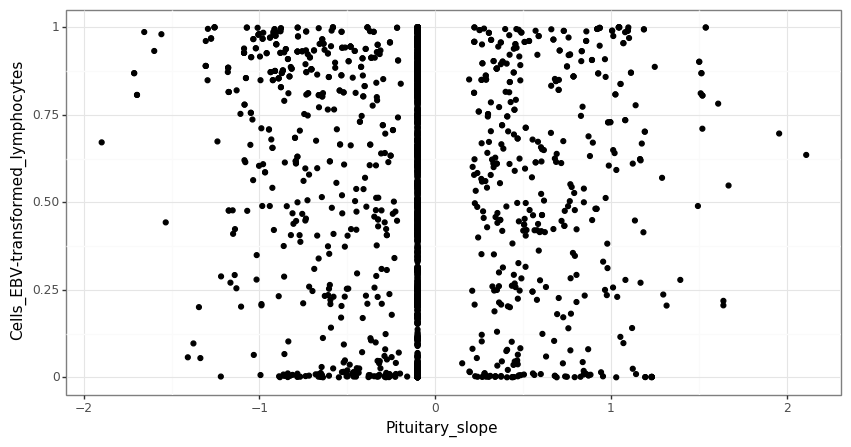

<ggplot: (2978485465781)>


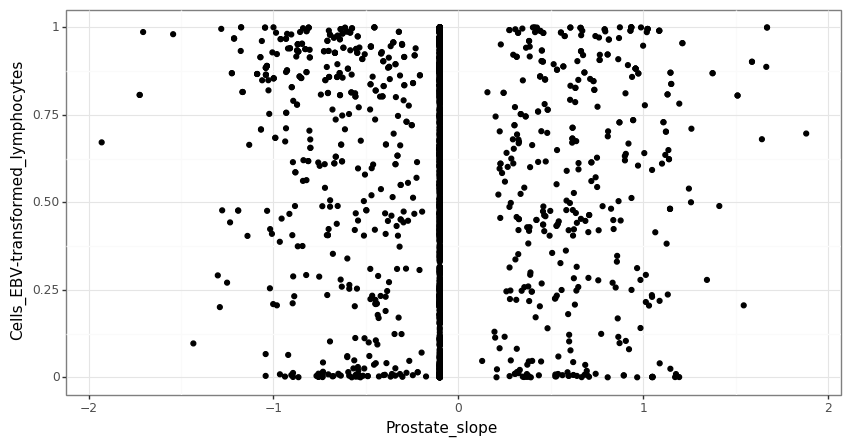

<ggplot: (2978347883999)>


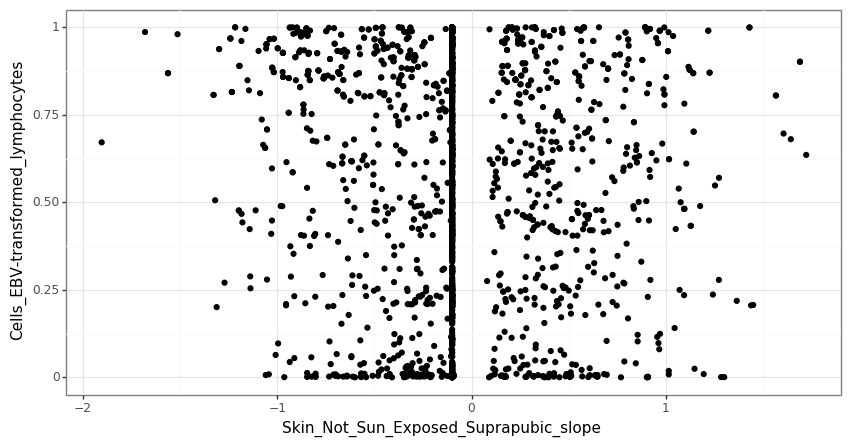

<ggplot: (2978346993613)>


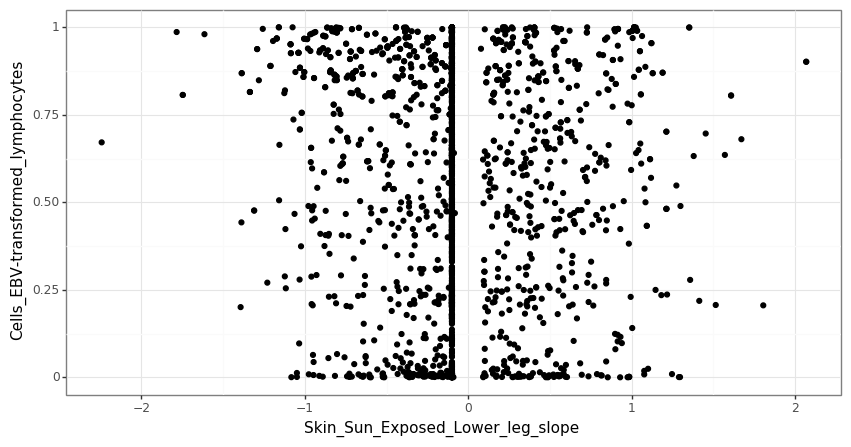

<ggplot: (2978349736638)>


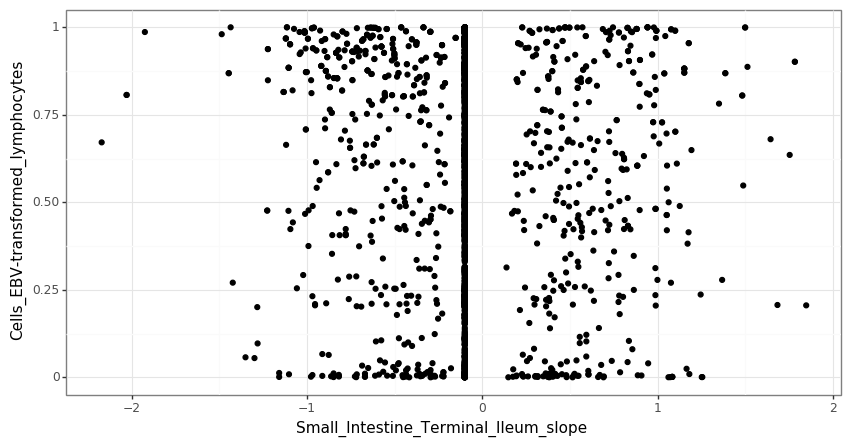

<ggplot: (2978502619332)>


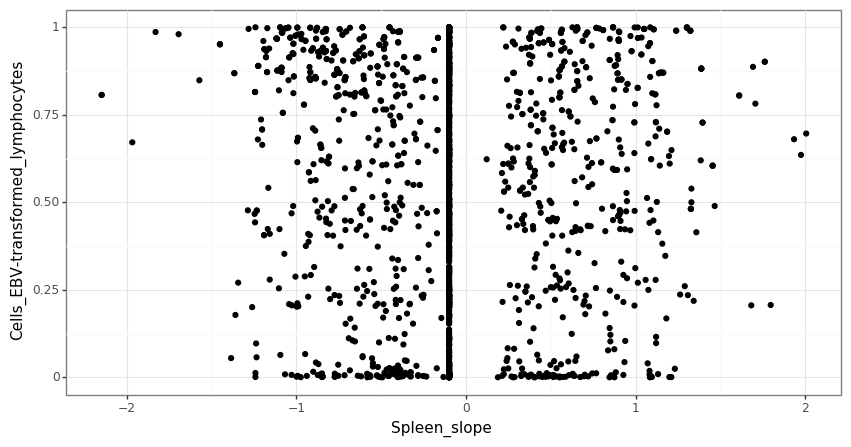

<ggplot: (2978439366349)>


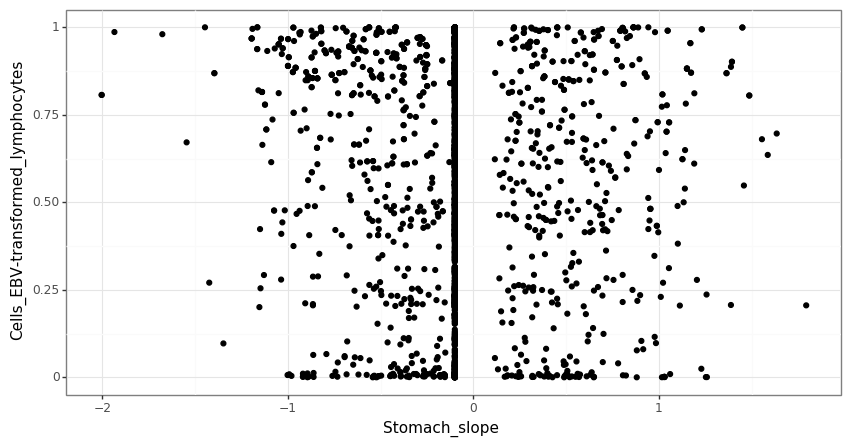

<ggplot: (2978346933742)>


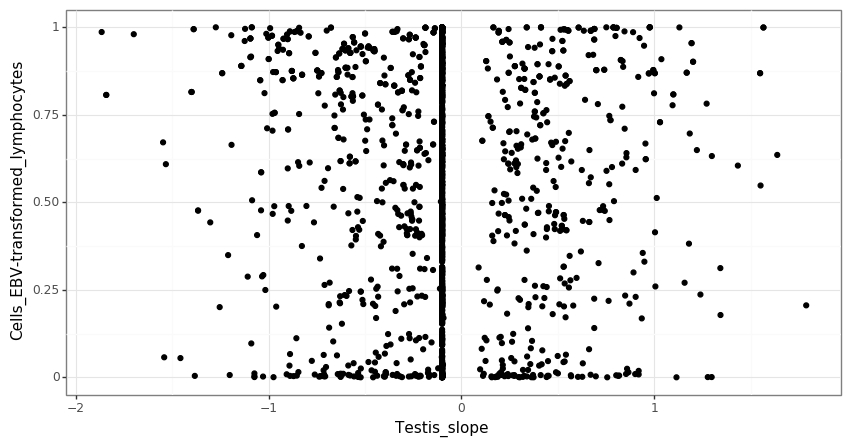

<ggplot: (2978378606589)>


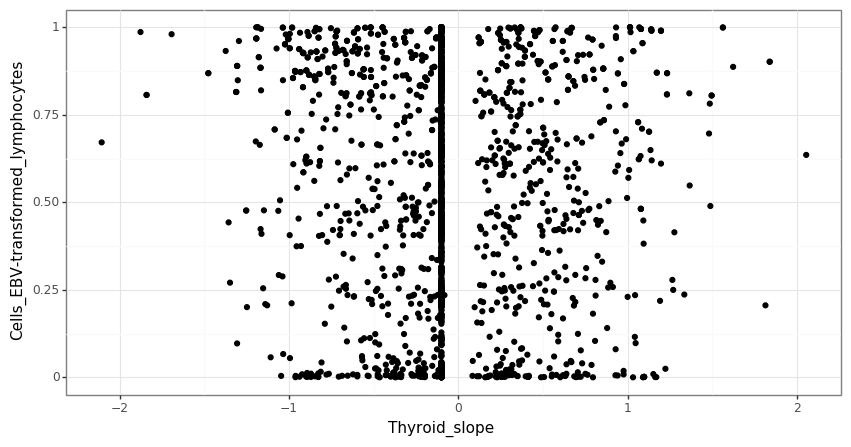

<ggplot: (2978502495600)>


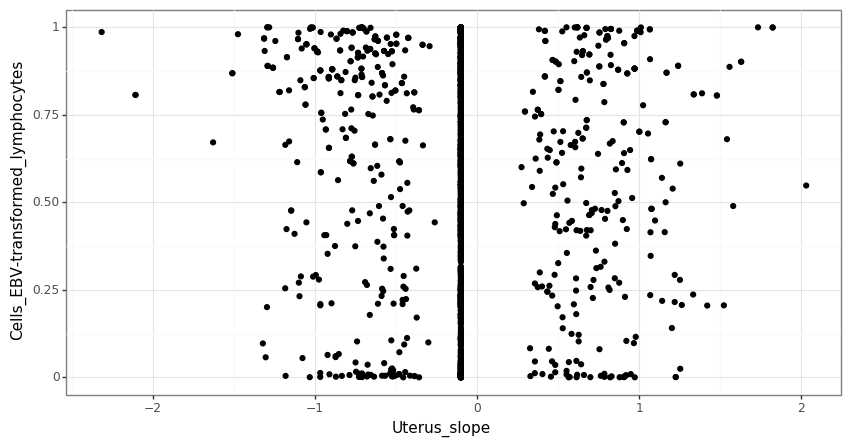

<ggplot: (2978494723738)>


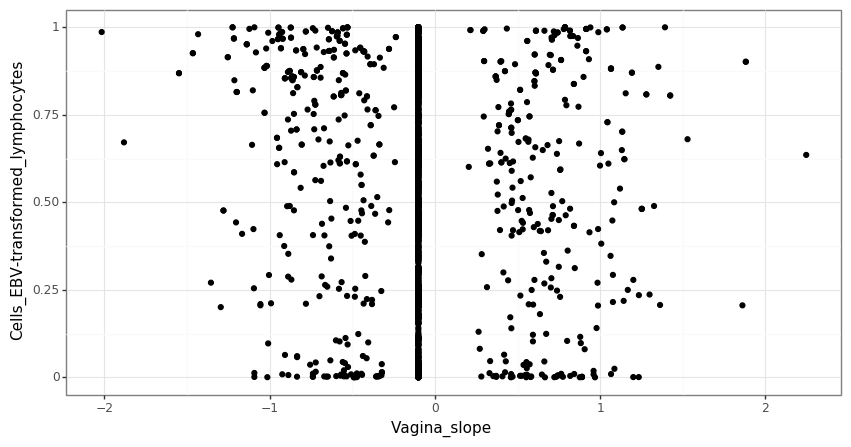

<ggplot: (2978348120019)>


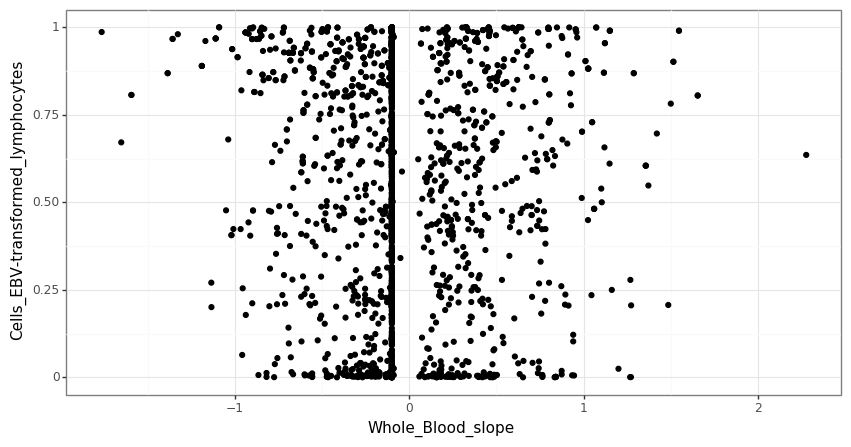

<ggplot: (2978514112061)>


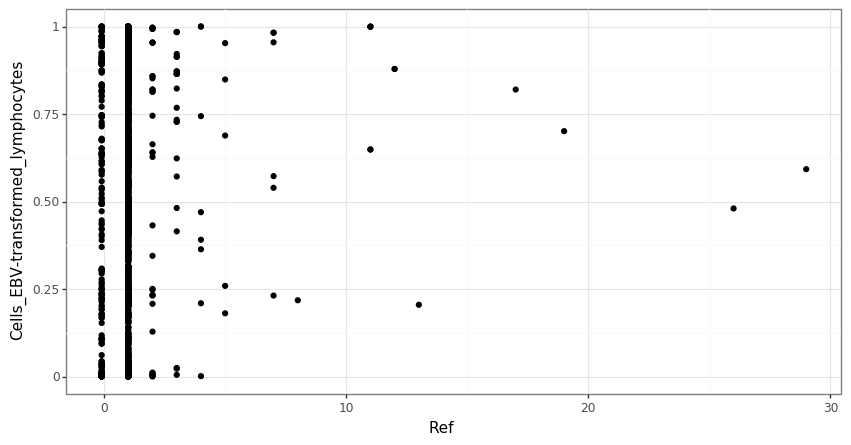

<ggplot: (2978514333272)>


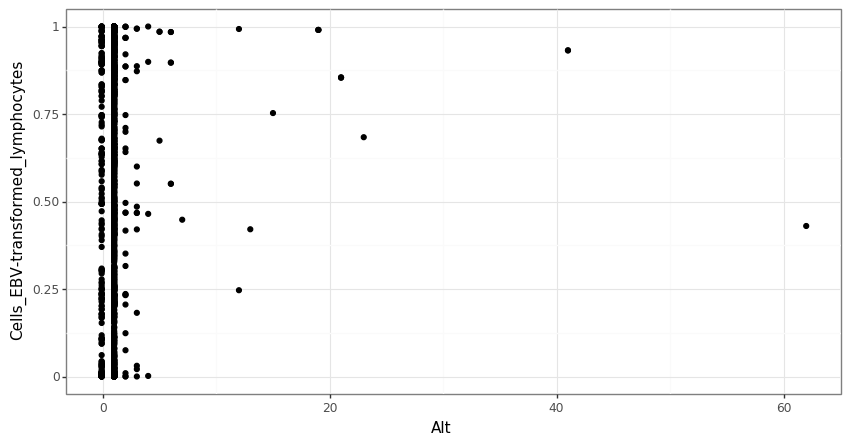

<ggplot: (2978514437548)>


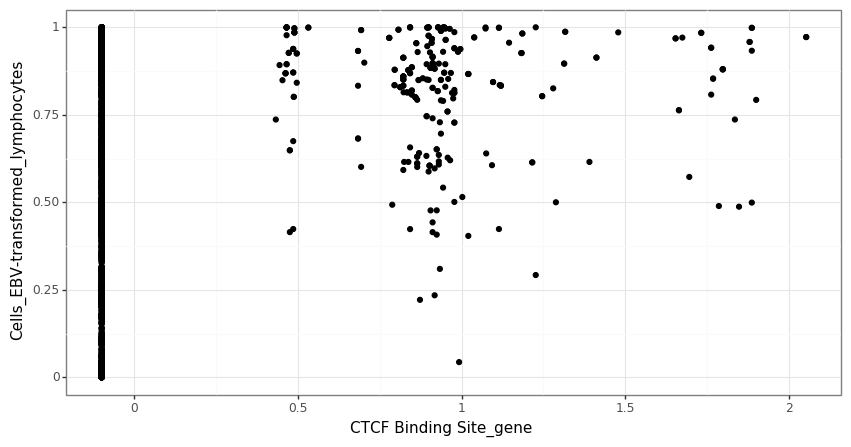

<ggplot: (2978396792086)>


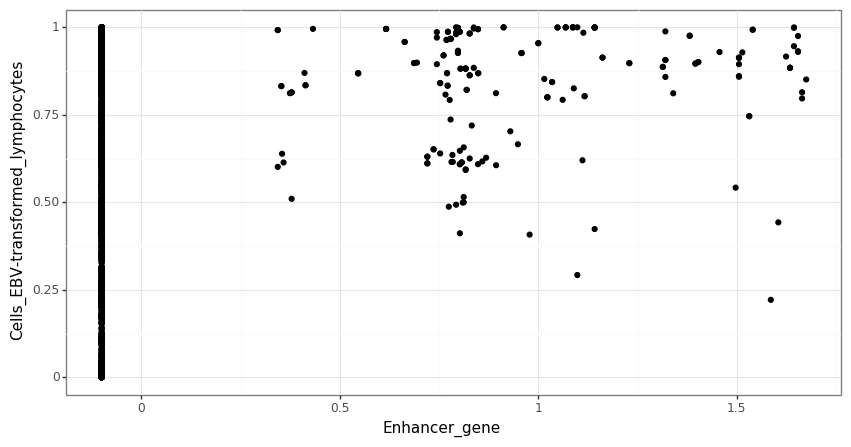

<ggplot: (2978514445740)>


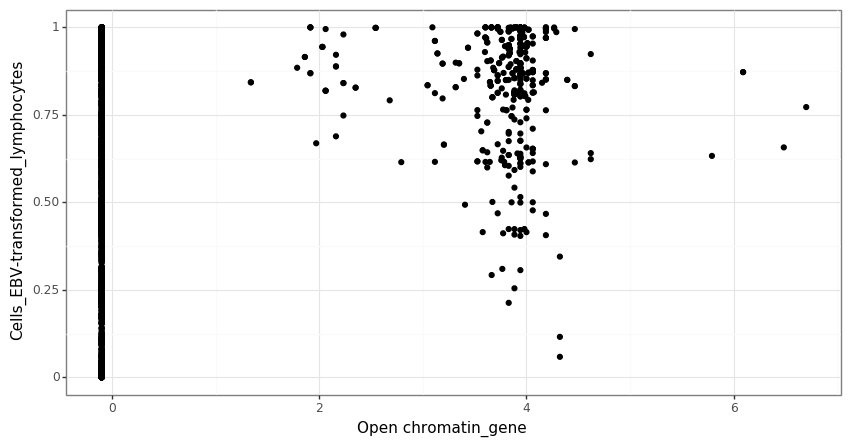

<ggplot: (2978514453809)>


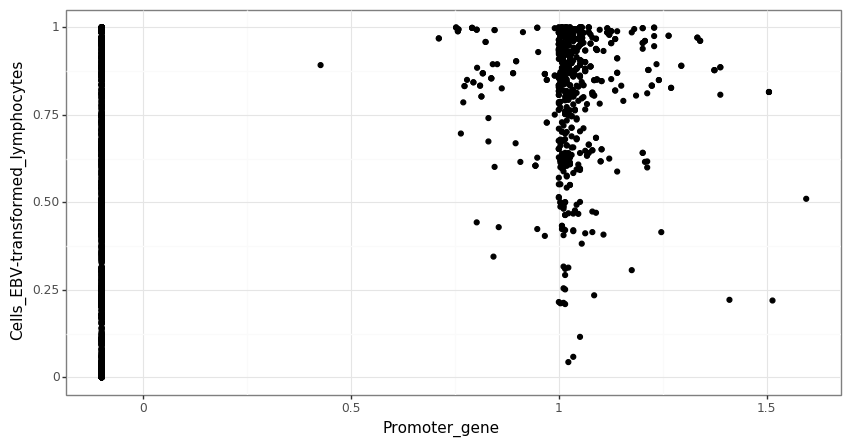

<ggplot: (2978485744366)>


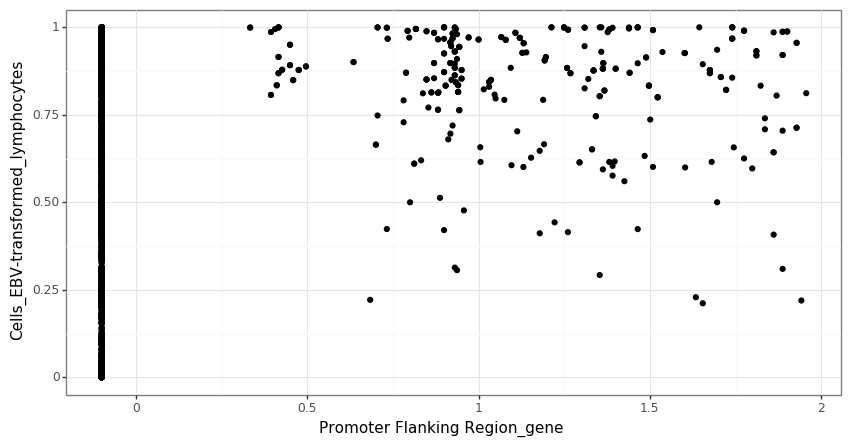

<ggplot: (2978514481017)>


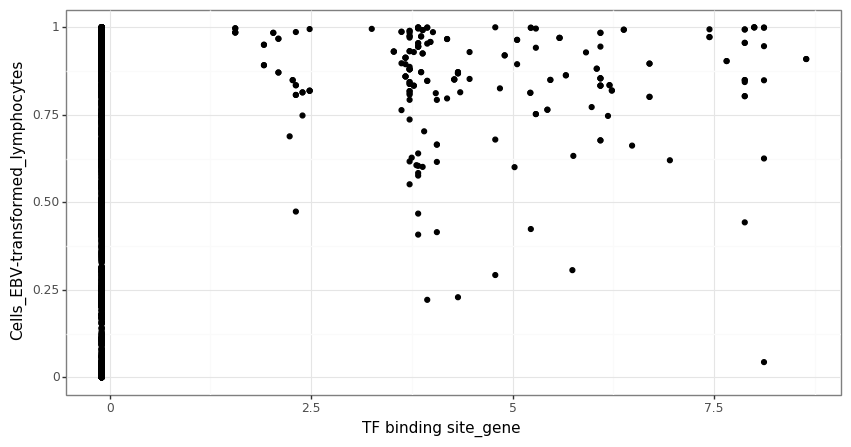

<ggplot: (2978514603873)>


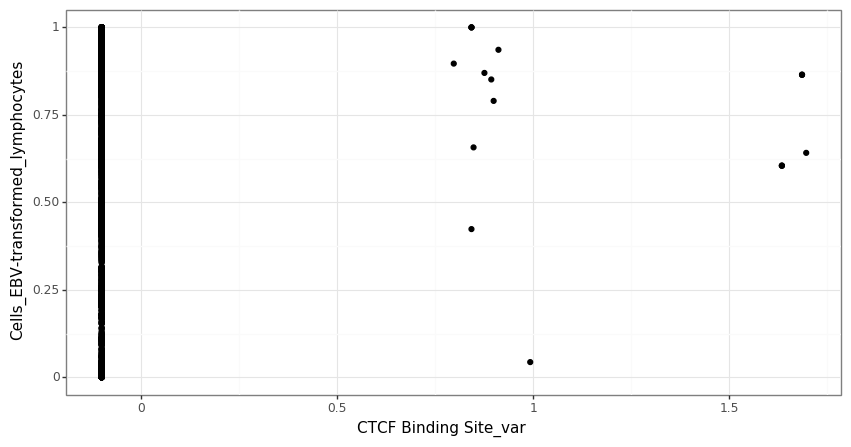

<ggplot: (2978514698123)>


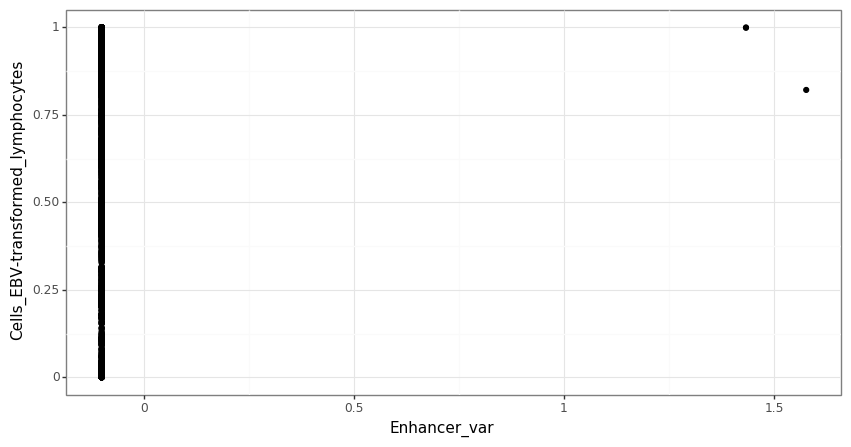

<ggplot: (2978514717001)>


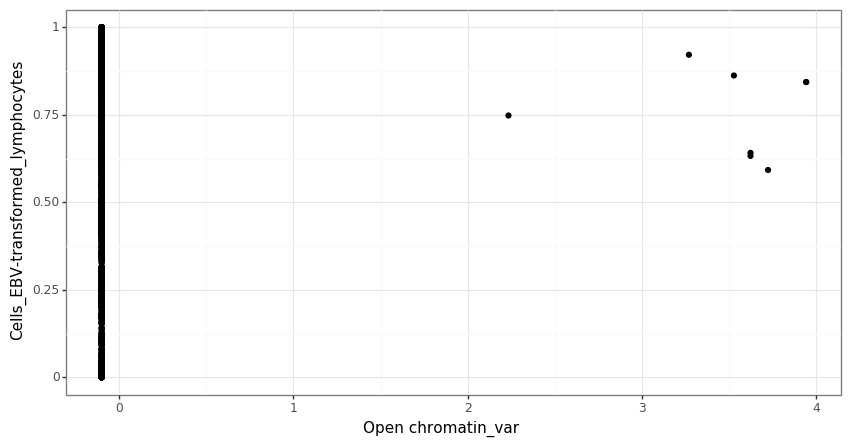

<ggplot: (2978514552805)>


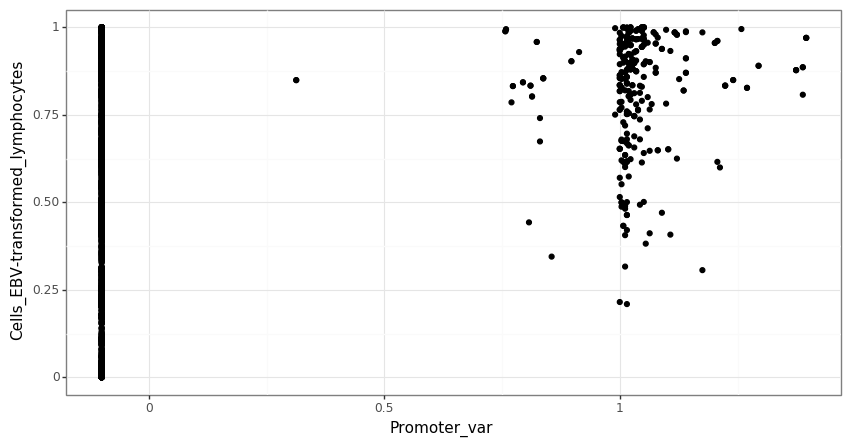

<ggplot: (2978514707228)>


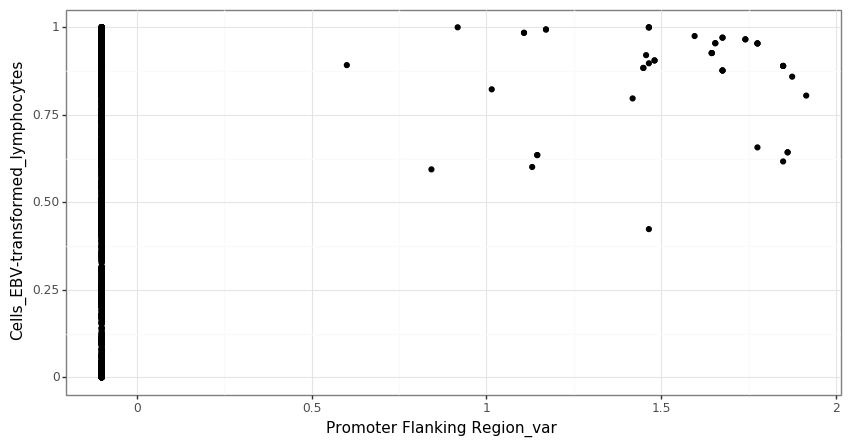

<ggplot: (2978514704324)>


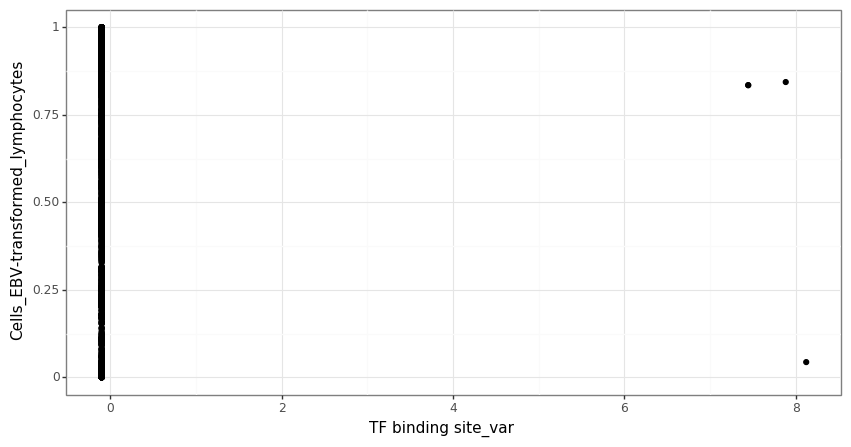

<ggplot: (2978514858210)>


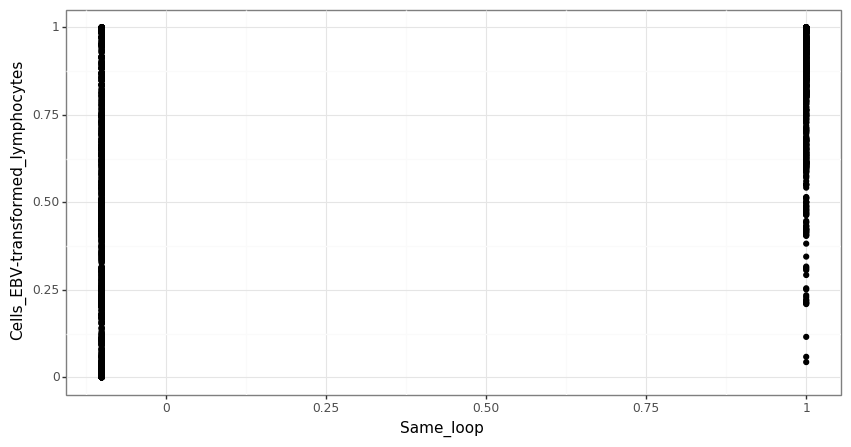

<ggplot: (2978514928604)>


In [1104]:
for i in ML_data.columns[7:].drop('variant_id'):
    x=i
    y=target
    plot=(
        ggplot(ML_data.fillna(-0.1),aes(x=x,y=y))
        +geom_point()
        +theme_bw()
    )
    print(plot)

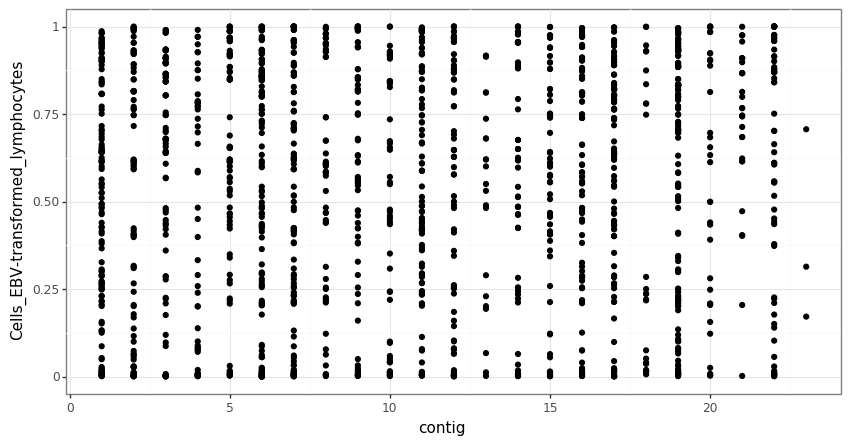

<ggplot: (2978416734157)>


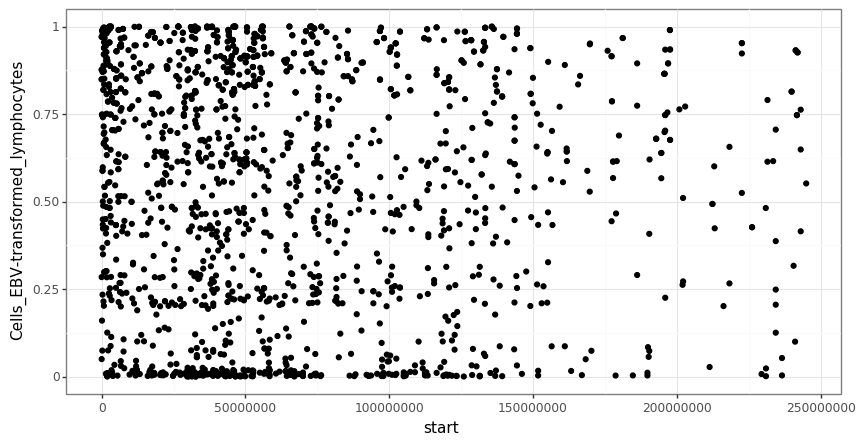

<ggplot: (2978487521428)>


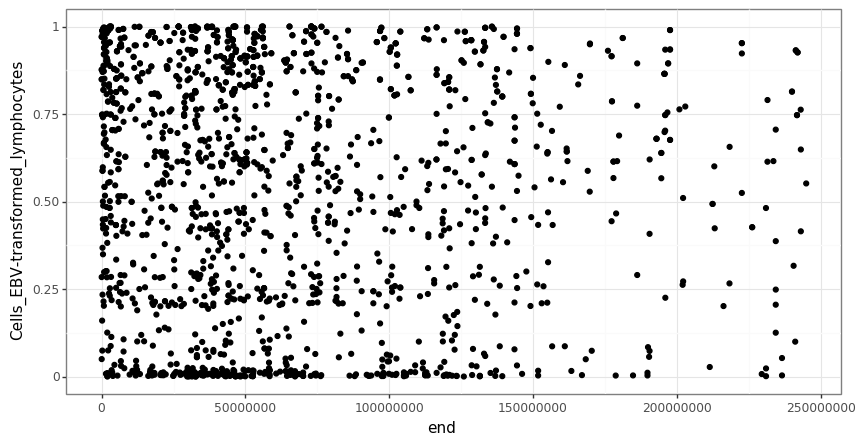

<ggplot: (2978417016706)>


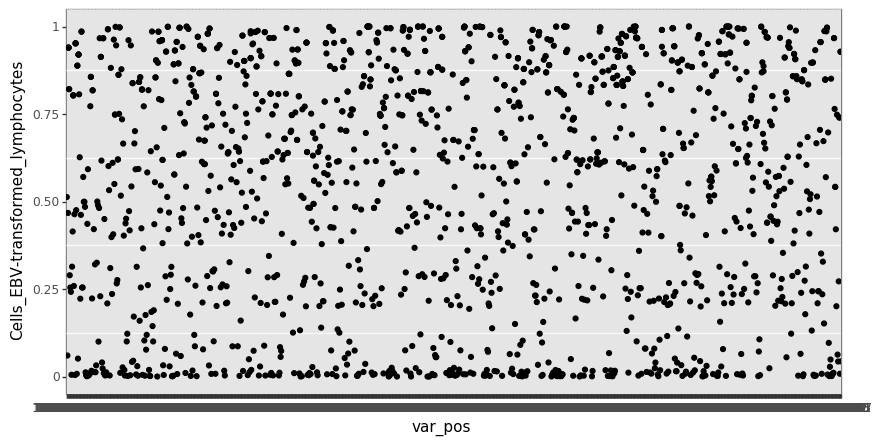

<ggplot: (2978439001573)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 765 rows containing missing values.


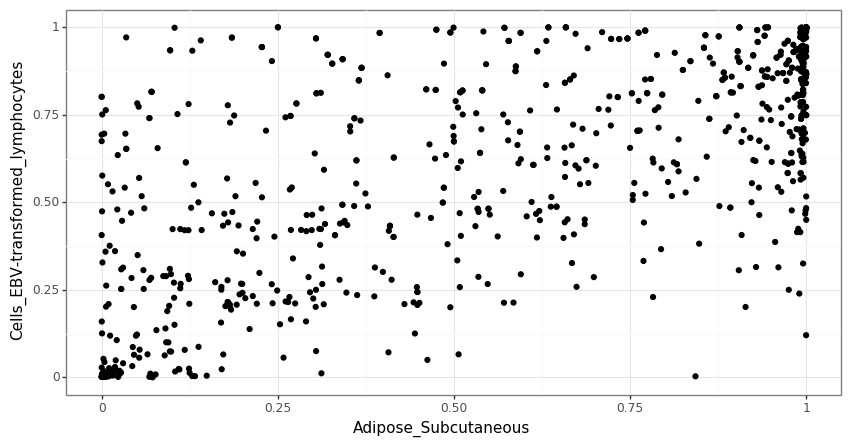

<ggplot: (2978377878905)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 789 rows containing missing values.


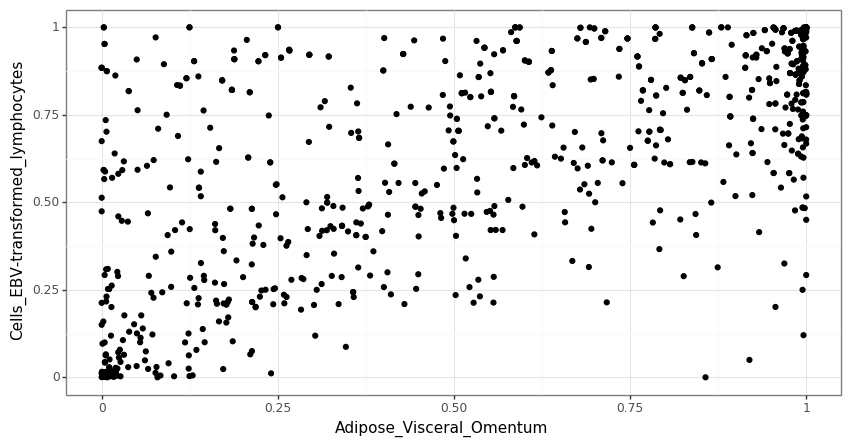

<ggplot: (2978380369119)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 934 rows containing missing values.


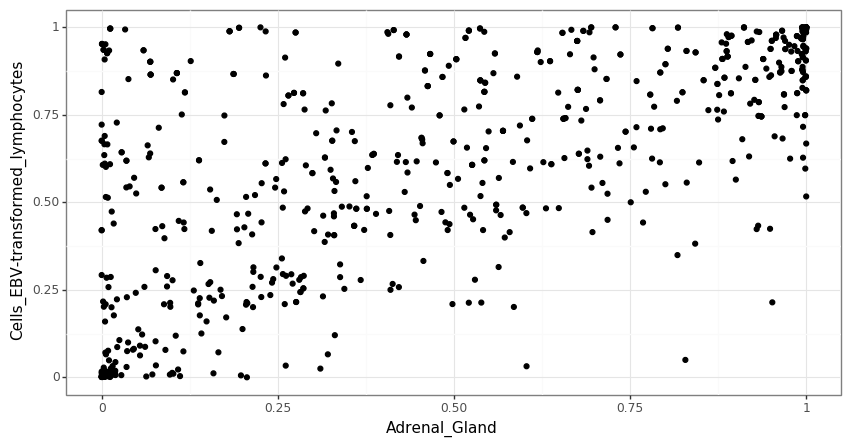

<ggplot: (2978346759903)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 852 rows containing missing values.


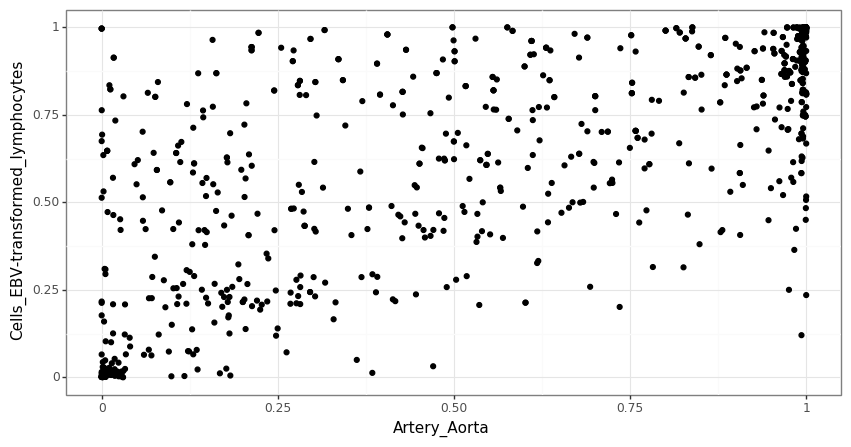

<ggplot: (2978347928974)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 990 rows containing missing values.


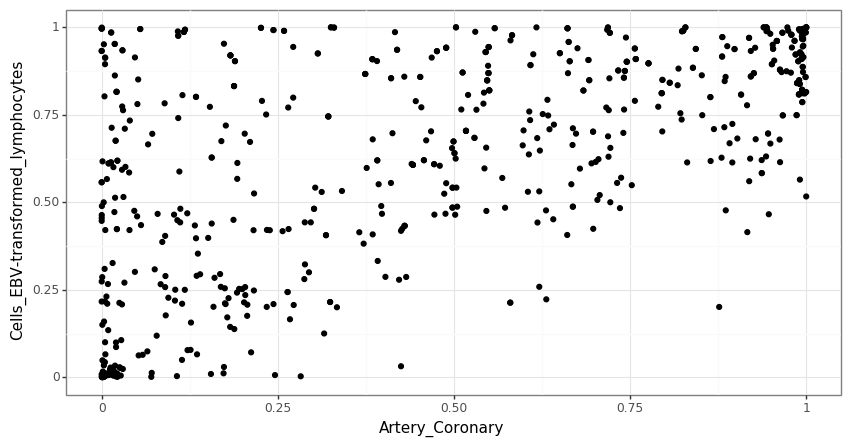

<ggplot: (2978380198575)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 805 rows containing missing values.


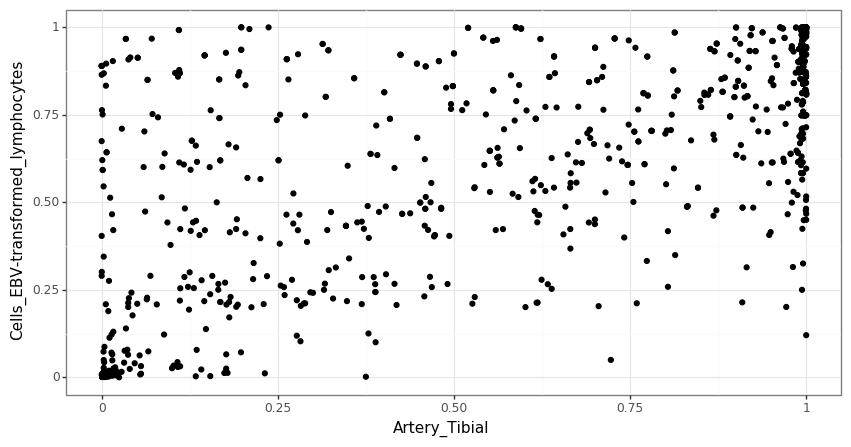

<ggplot: (2978347927089)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1231 rows containing missing values.


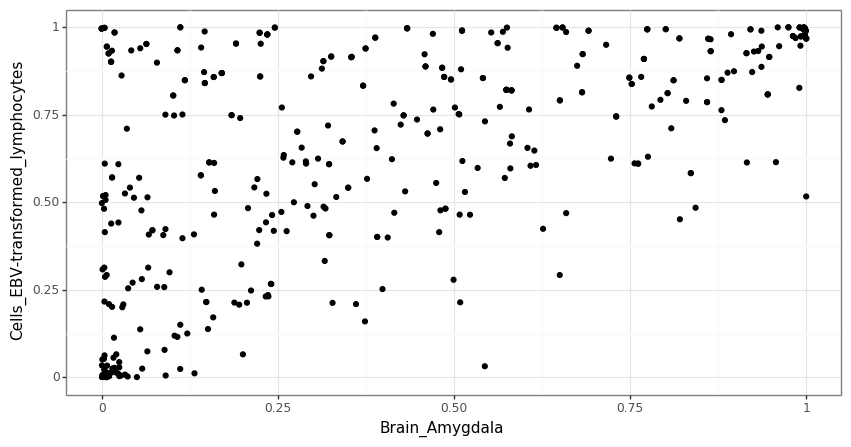

<ggplot: (2978378125873)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1185 rows containing missing values.


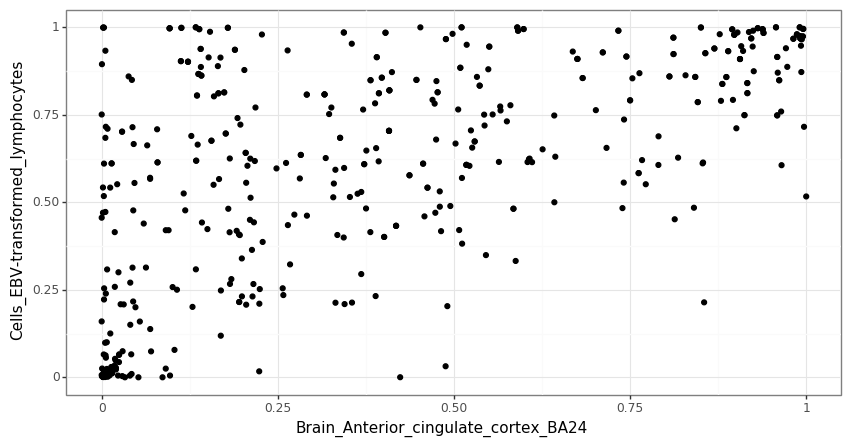

<ggplot: (2978379958429)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1087 rows containing missing values.


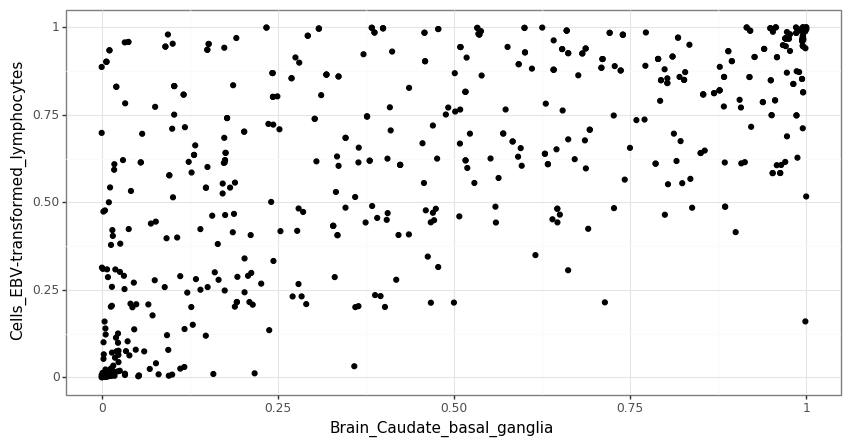

<ggplot: (2978384857585)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1076 rows containing missing values.


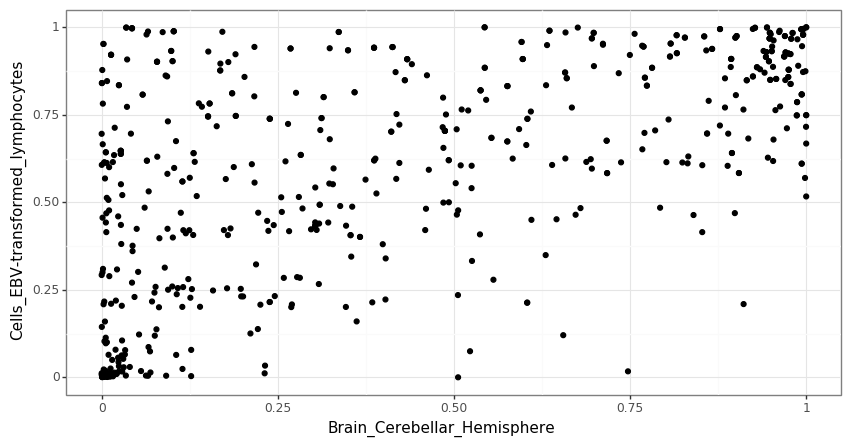

<ggplot: (2978378051768)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1081 rows containing missing values.


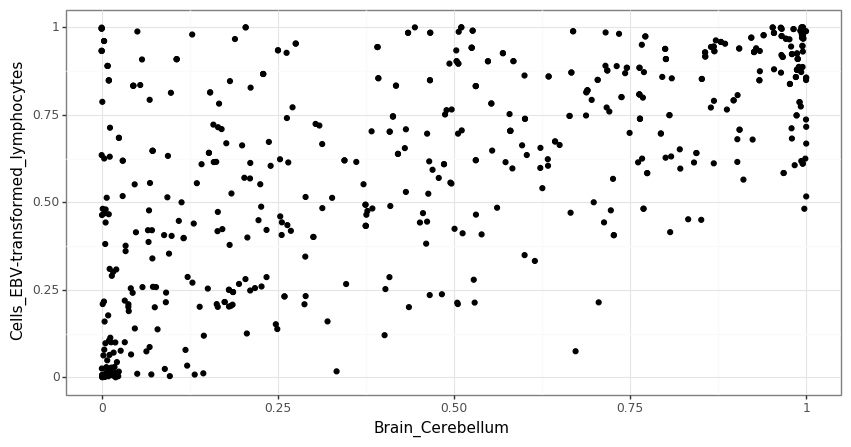

<ggplot: (2978392696610)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1071 rows containing missing values.


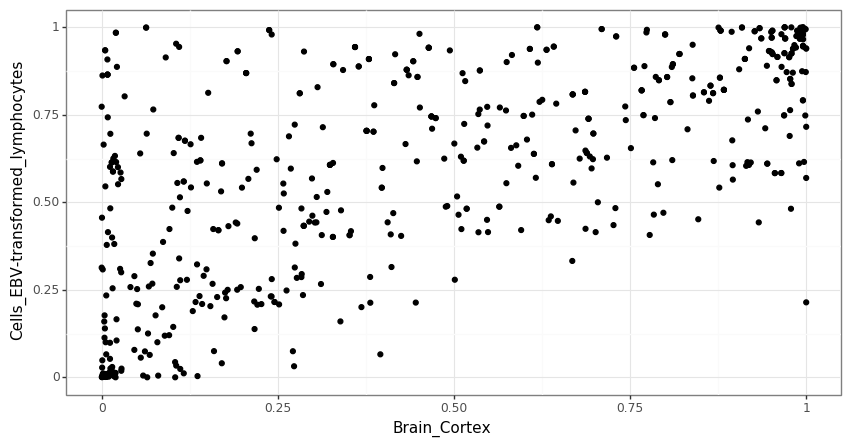

<ggplot: (2978390948325)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1117 rows containing missing values.


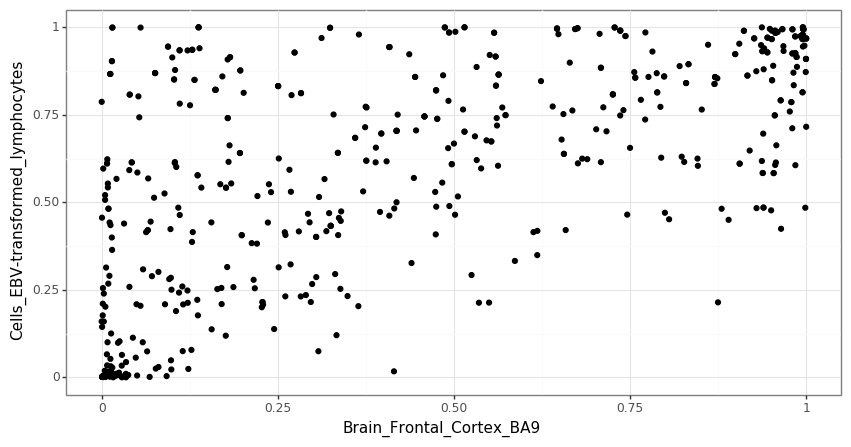

<ggplot: (2978340967364)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1142 rows containing missing values.


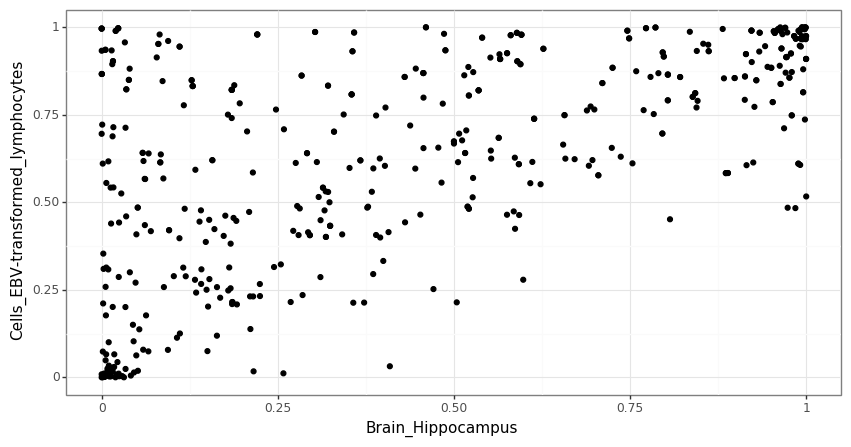

<ggplot: (2978390947193)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1127 rows containing missing values.


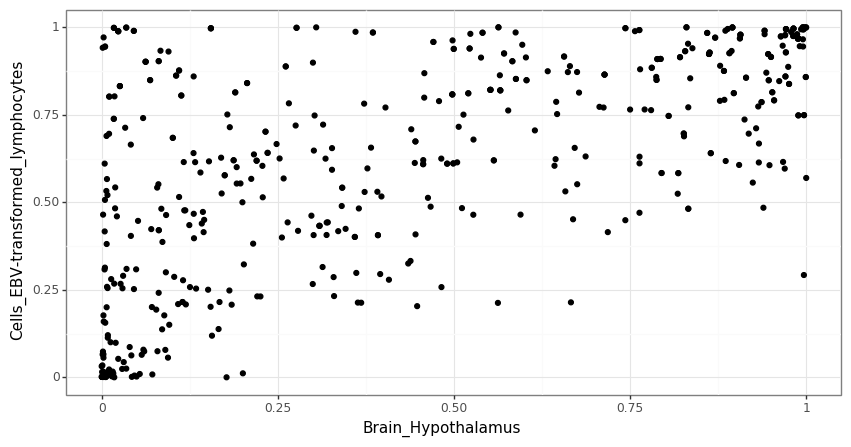

<ggplot: (2978380558930)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1089 rows containing missing values.


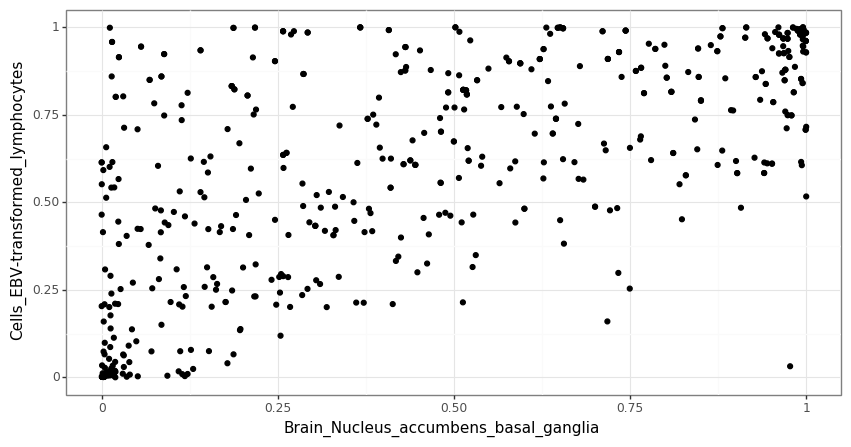

<ggplot: (2978391429720)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1110 rows containing missing values.


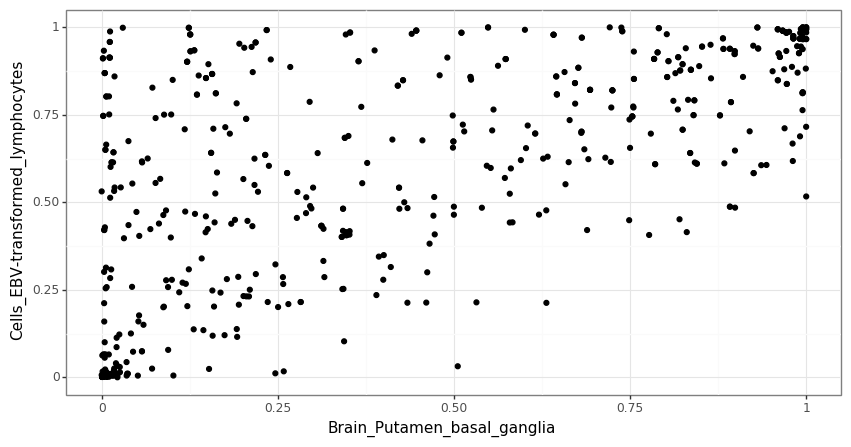

<ggplot: (2978391441445)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1193 rows containing missing values.


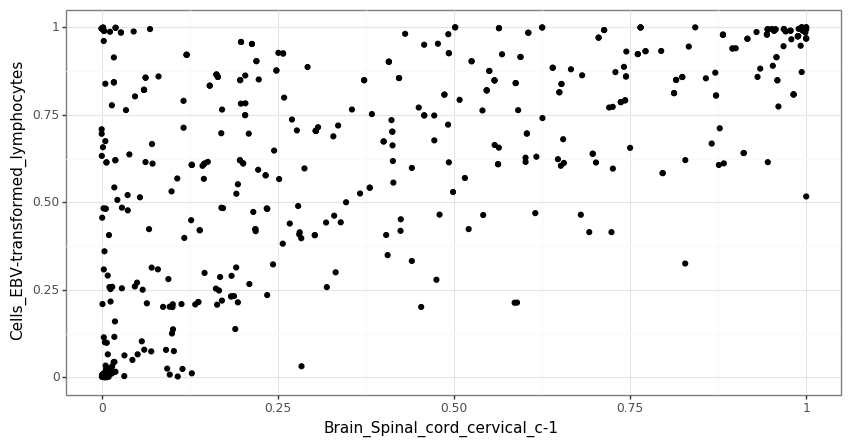

<ggplot: (2978391434933)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1306 rows containing missing values.


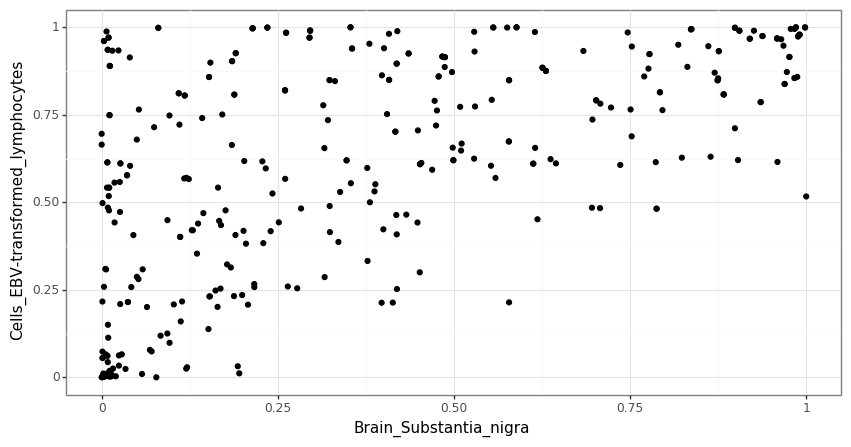

<ggplot: (2978381713285)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 811 rows containing missing values.


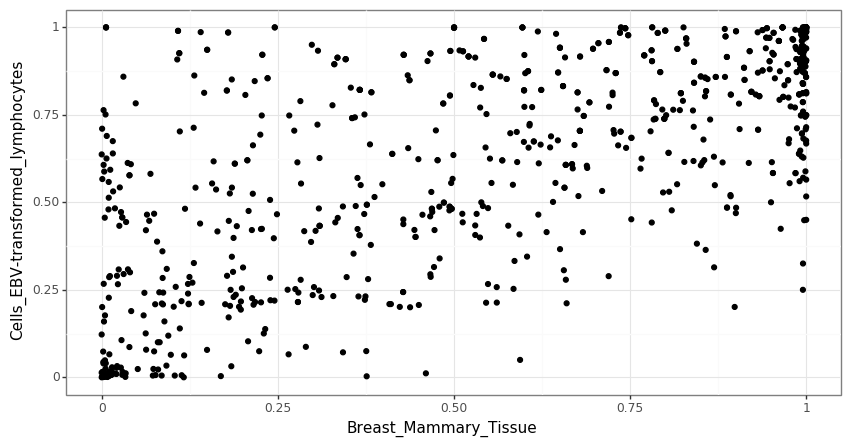

<ggplot: (2978380566489)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 758 rows containing missing values.


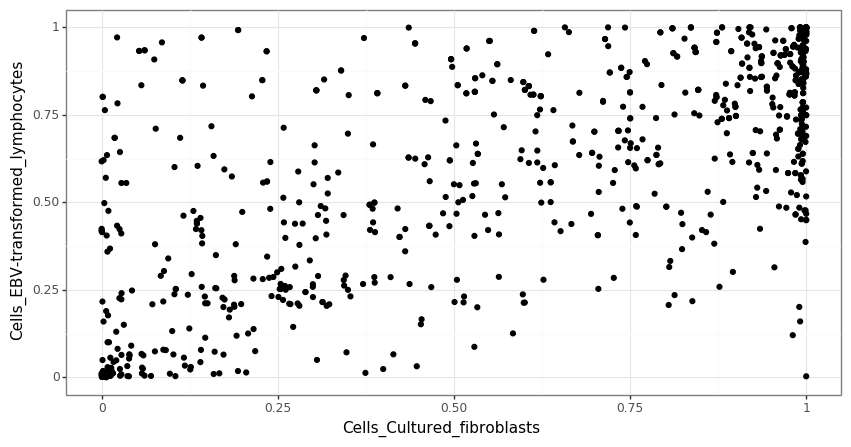

<ggplot: (2978378914211)>


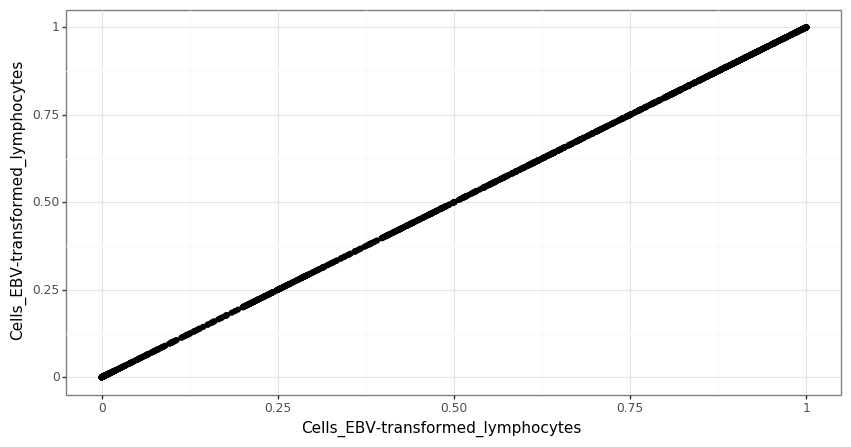

<ggplot: (2978379810091)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 898 rows containing missing values.


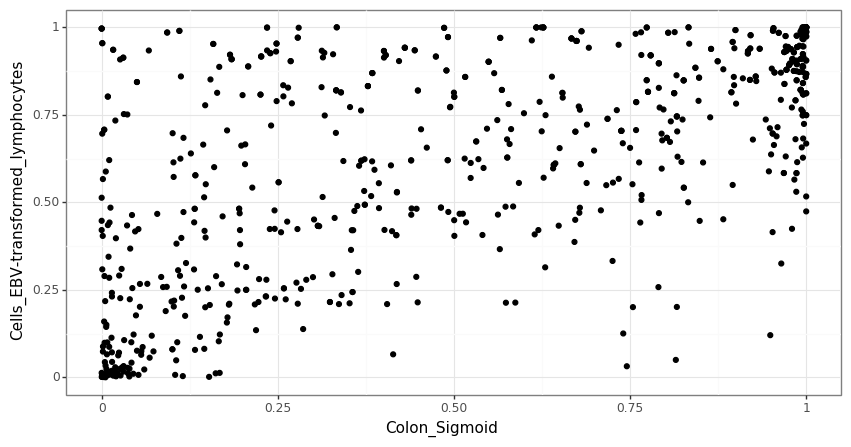

<ggplot: (2978383860526)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 792 rows containing missing values.


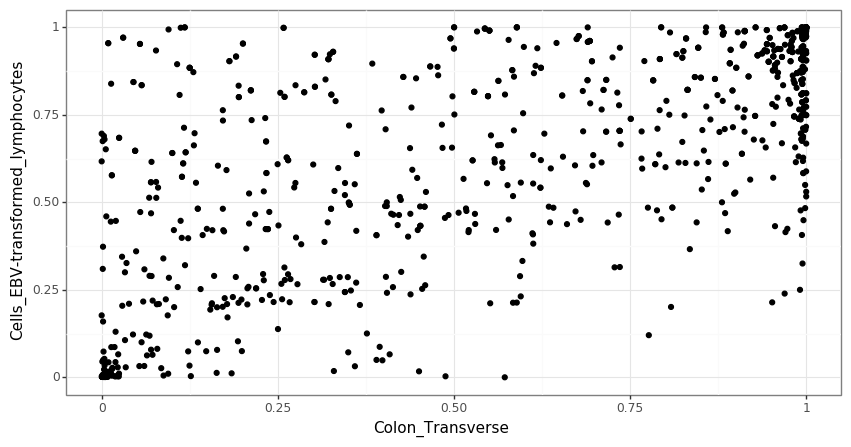

<ggplot: (2978372733916)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 871 rows containing missing values.


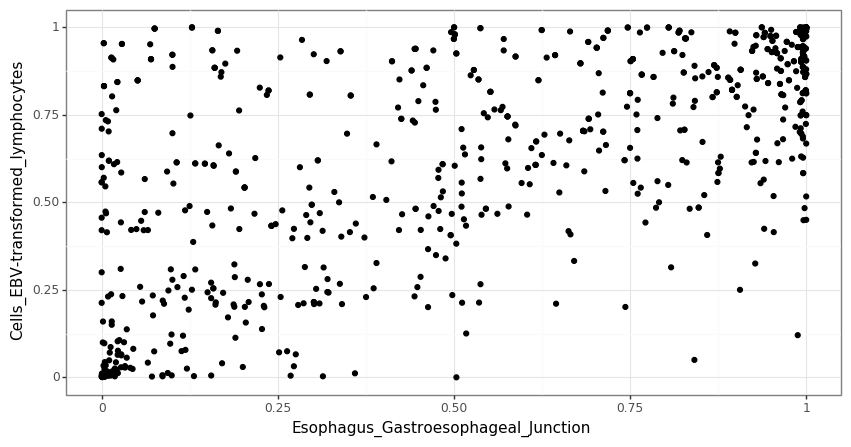

<ggplot: (2978371692930)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 724 rows containing missing values.


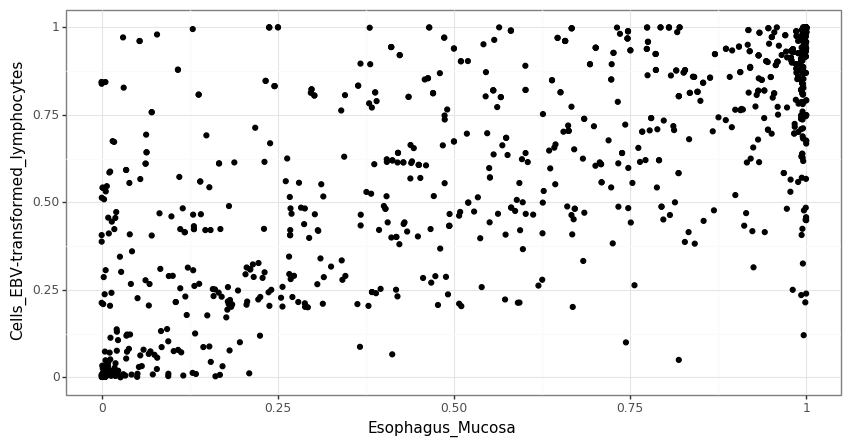

<ggplot: (2978392657225)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 810 rows containing missing values.


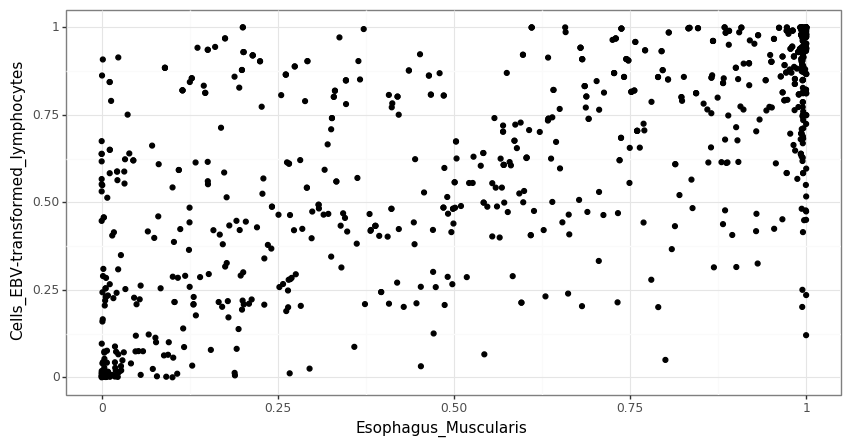

<ggplot: (2978392542961)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 888 rows containing missing values.


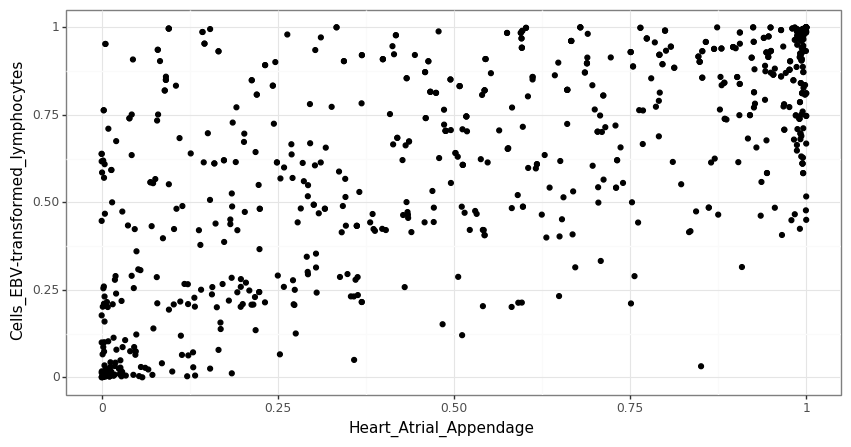

<ggplot: (2978392657186)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 954 rows containing missing values.


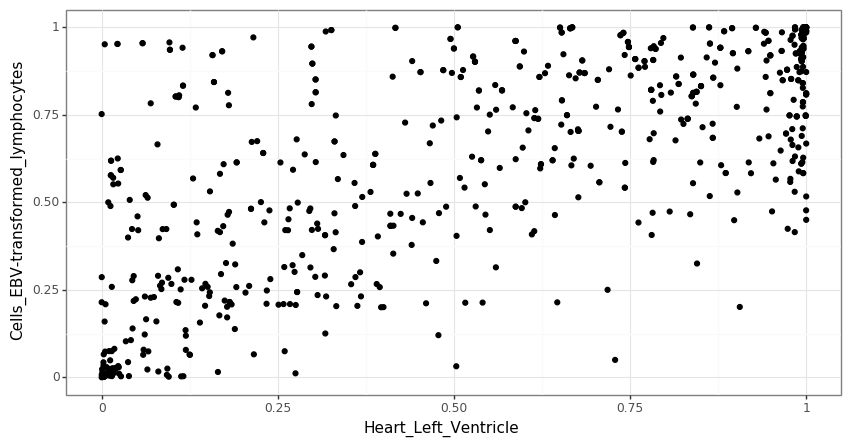

<ggplot: (2978371287113)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1359 rows containing missing values.


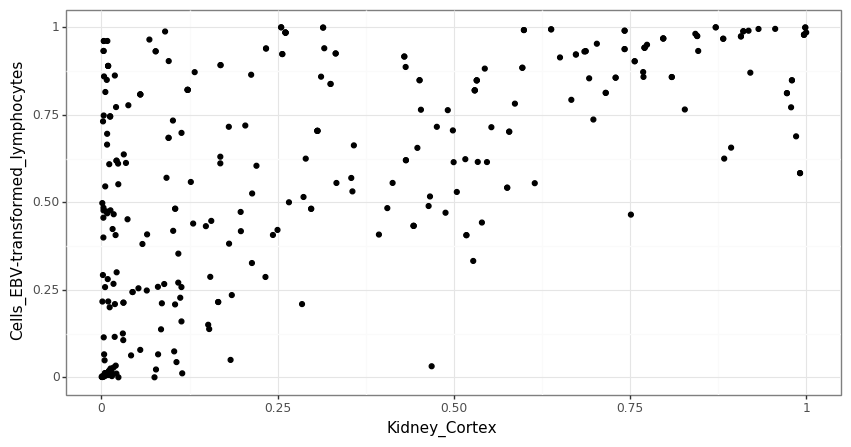

<ggplot: (2978340372646)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1107 rows containing missing values.


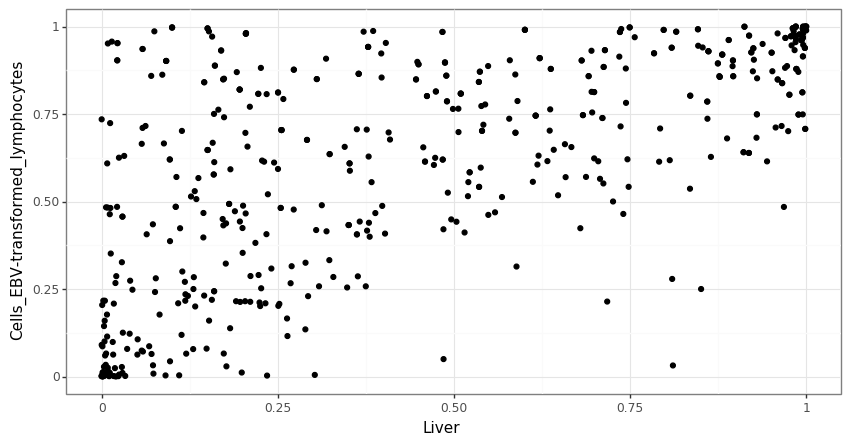

<ggplot: (2978349132782)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 743 rows containing missing values.


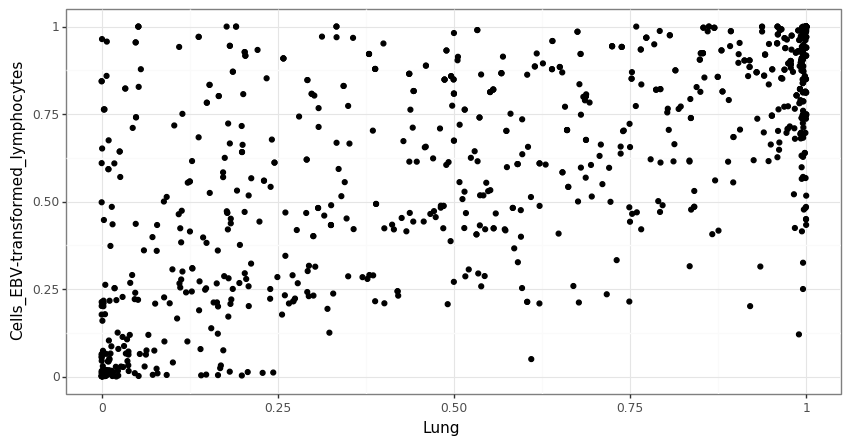

<ggplot: (2978392656279)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1087 rows containing missing values.


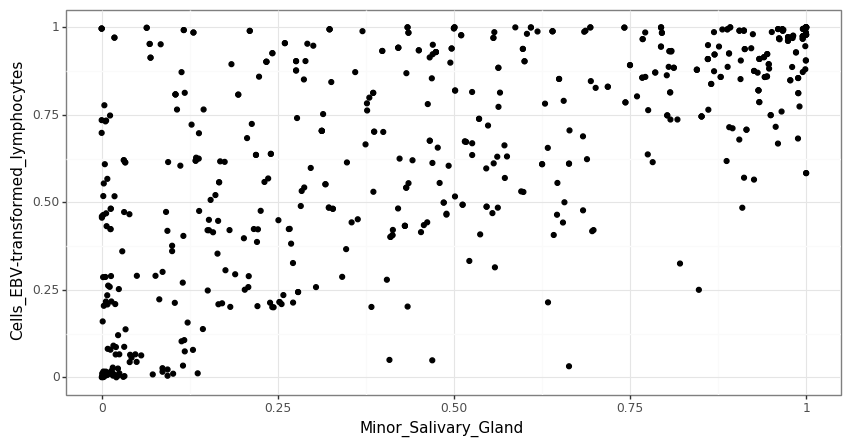

<ggplot: (2978349134114)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 931 rows containing missing values.


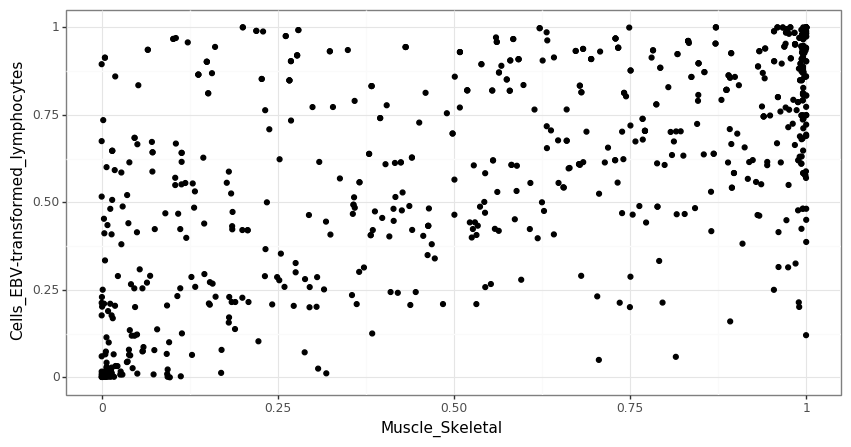

<ggplot: (2978356309011)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 805 rows containing missing values.


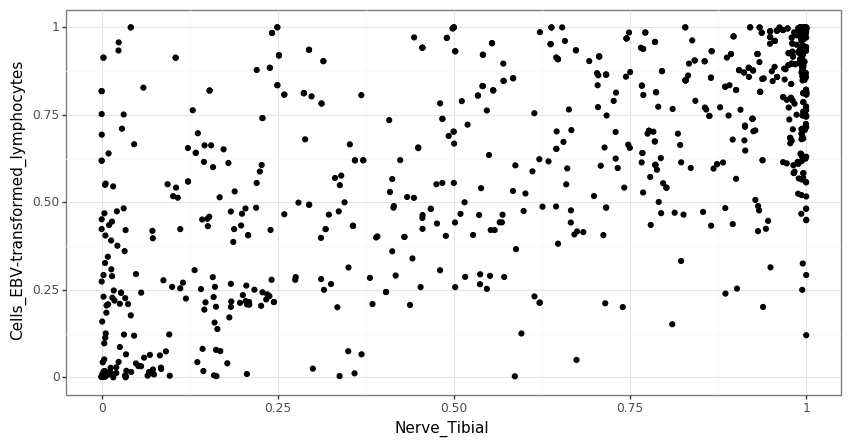

<ggplot: (2978361131198)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1106 rows containing missing values.


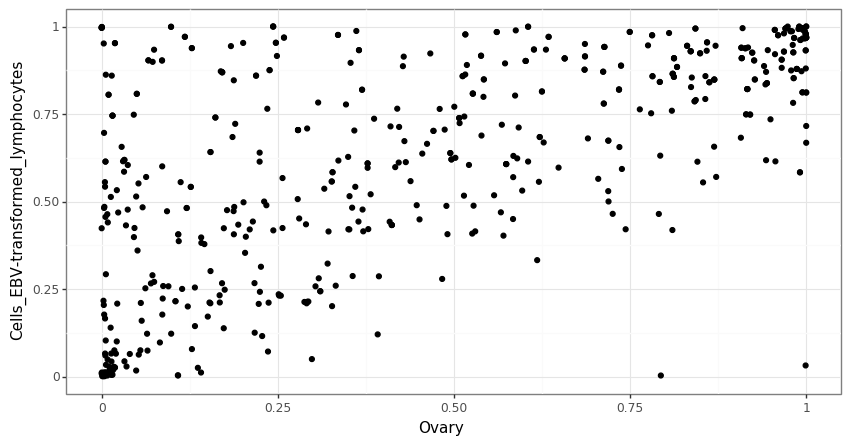

<ggplot: (2978356304439)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 909 rows containing missing values.


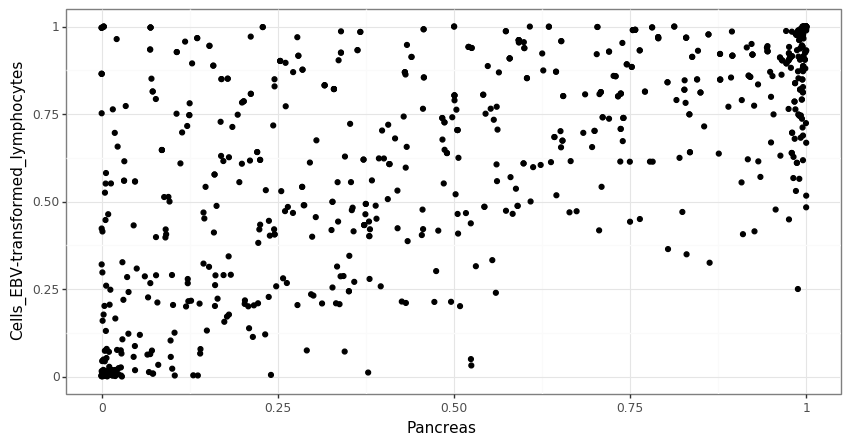

<ggplot: (2978342928556)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 961 rows containing missing values.


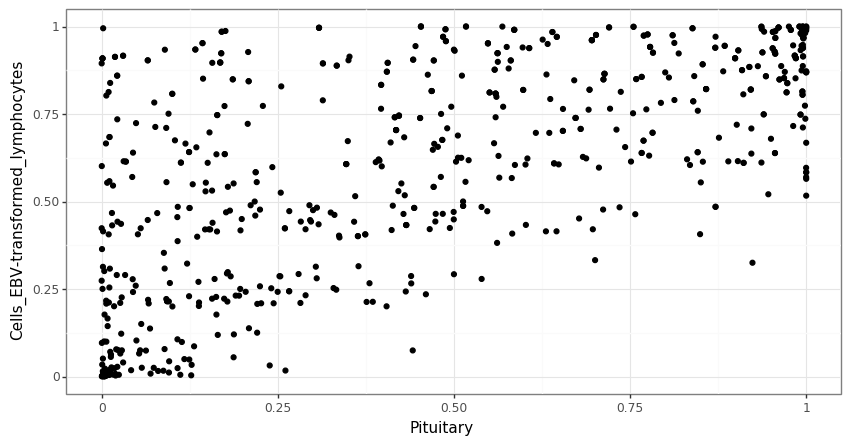

<ggplot: (2978349232336)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1009 rows containing missing values.


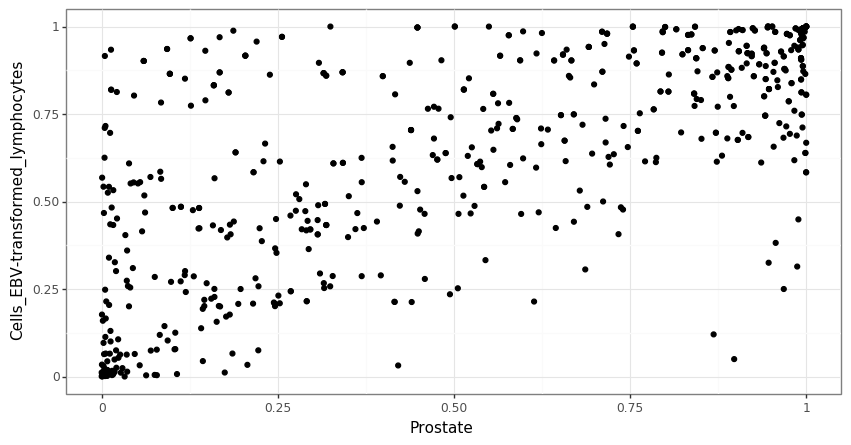

<ggplot: (2978356454325)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 940 rows containing missing values.


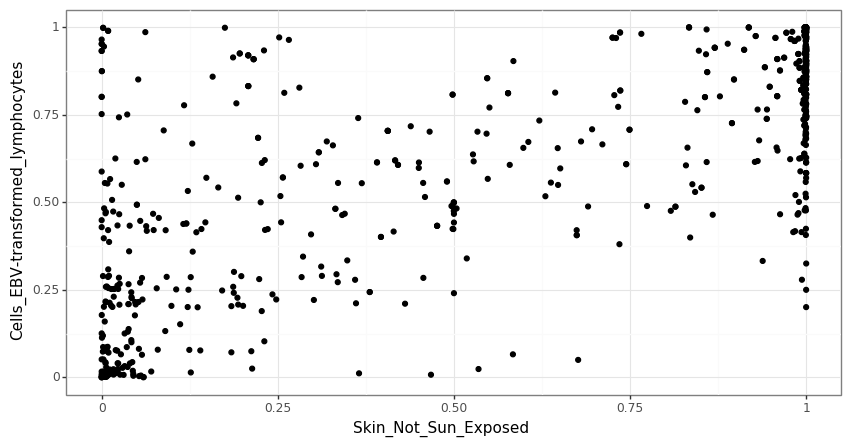

<ggplot: (2978360699414)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1013 rows containing missing values.


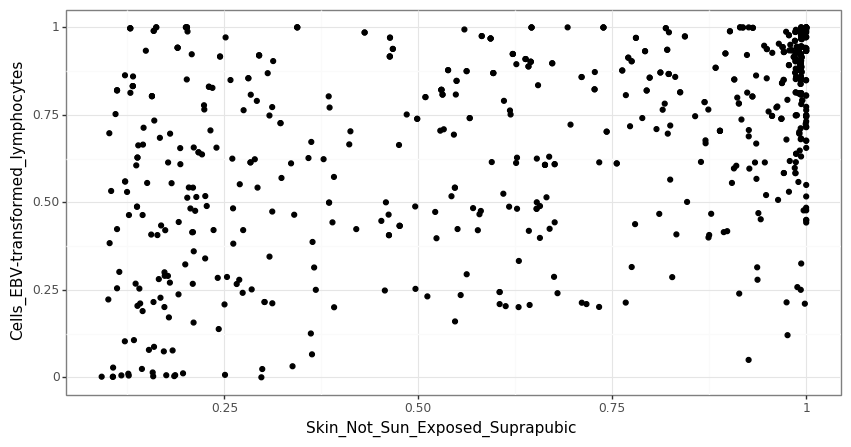

<ggplot: (2978487463042)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 910 rows containing missing values.


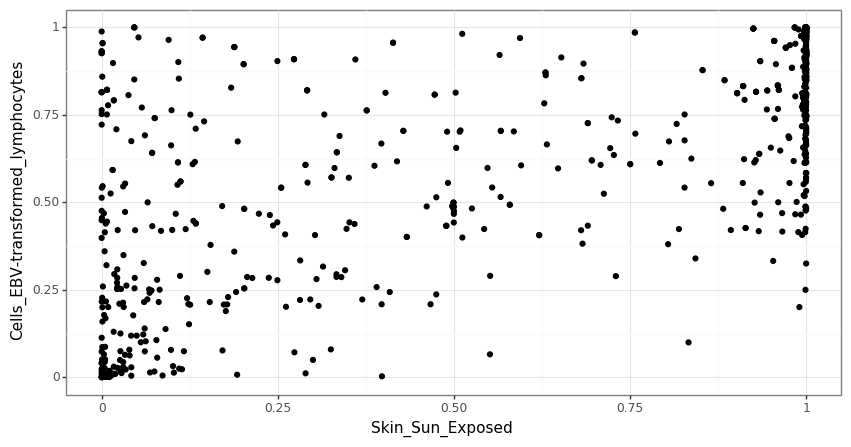

<ggplot: (2978349331604)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 985 rows containing missing values.


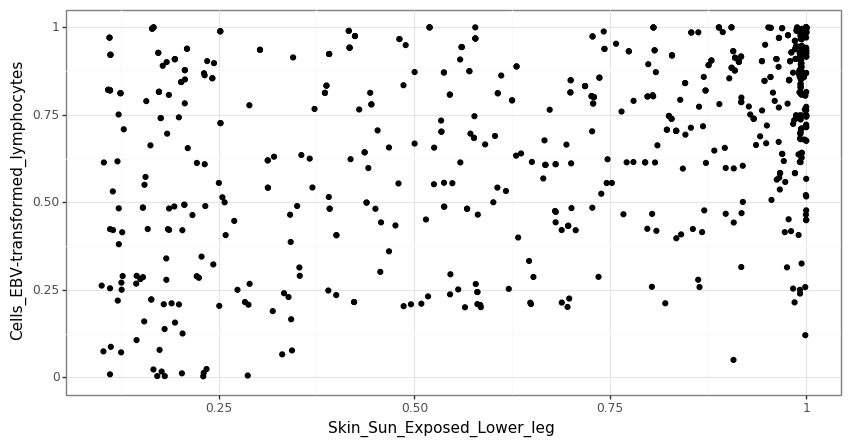

<ggplot: (2978353707951)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 935 rows containing missing values.


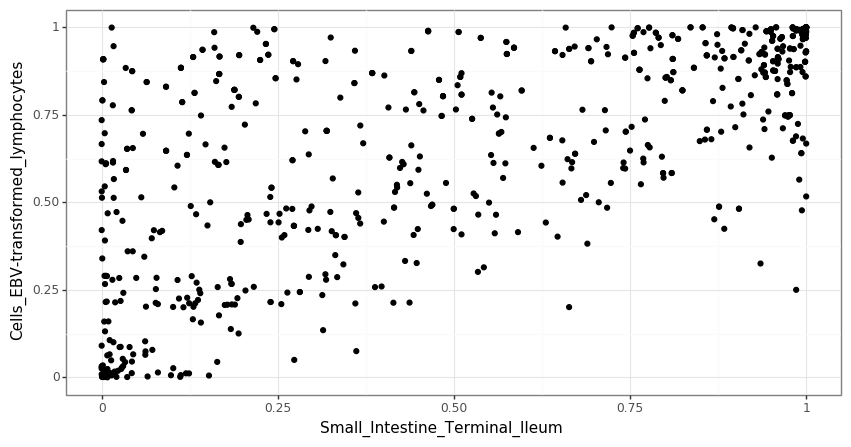

<ggplot: (2978347002766)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 777 rows containing missing values.


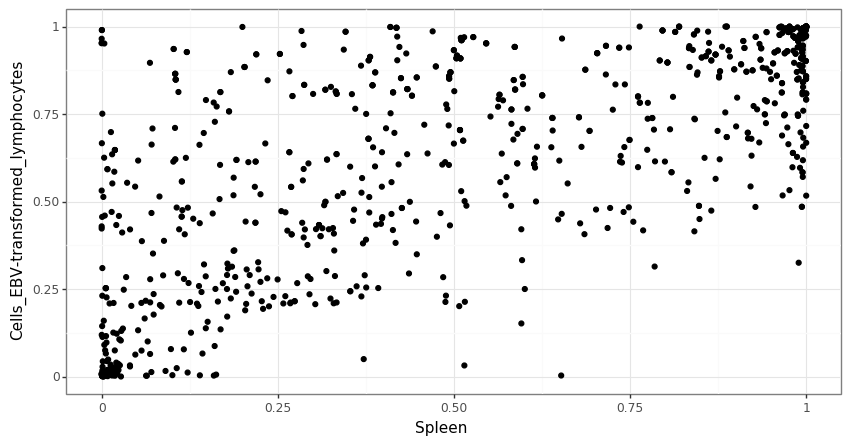

<ggplot: (2978351576083)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 882 rows containing missing values.


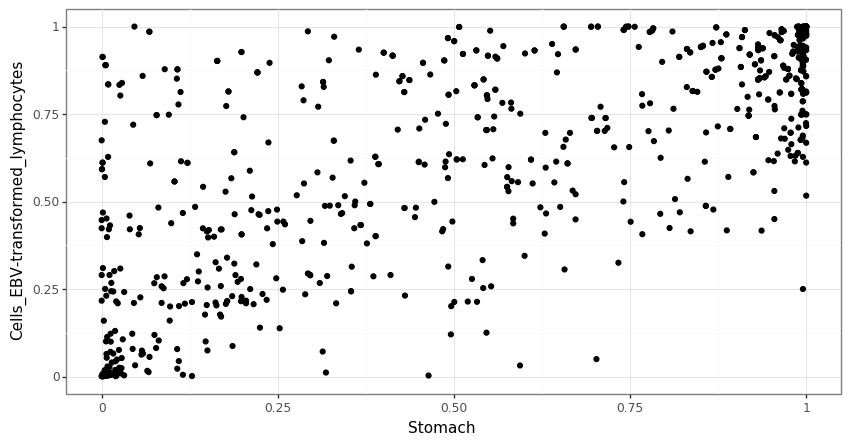

<ggplot: (2978357713457)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1012 rows containing missing values.


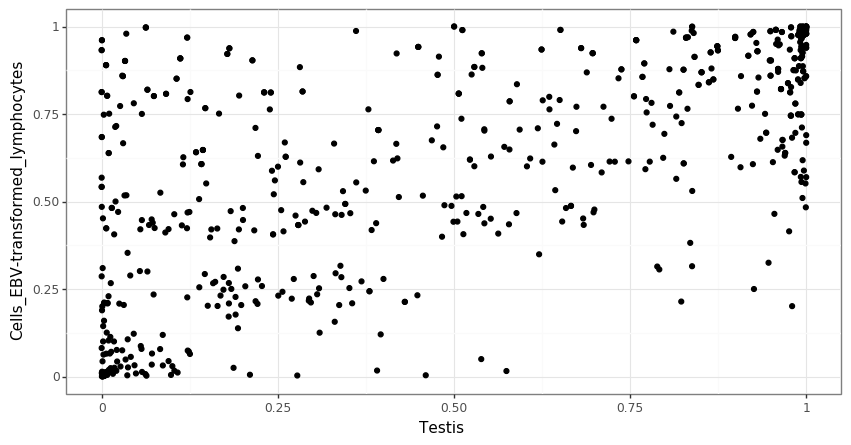

<ggplot: (2978353806981)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 821 rows containing missing values.


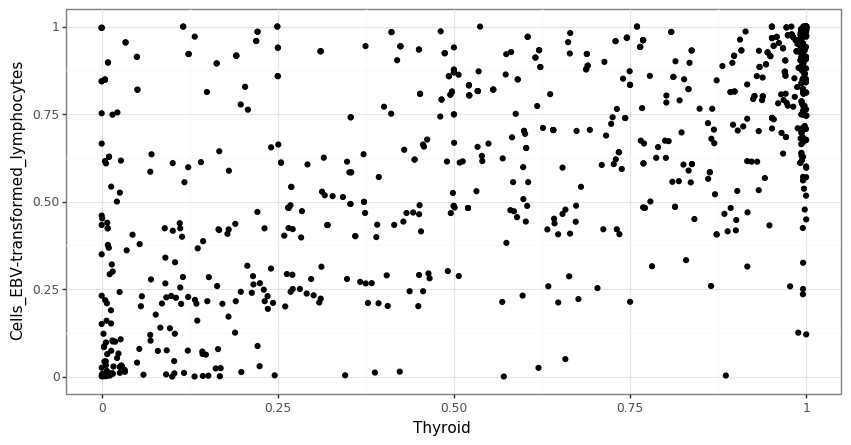

<ggplot: (2978349840255)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1162 rows containing missing values.


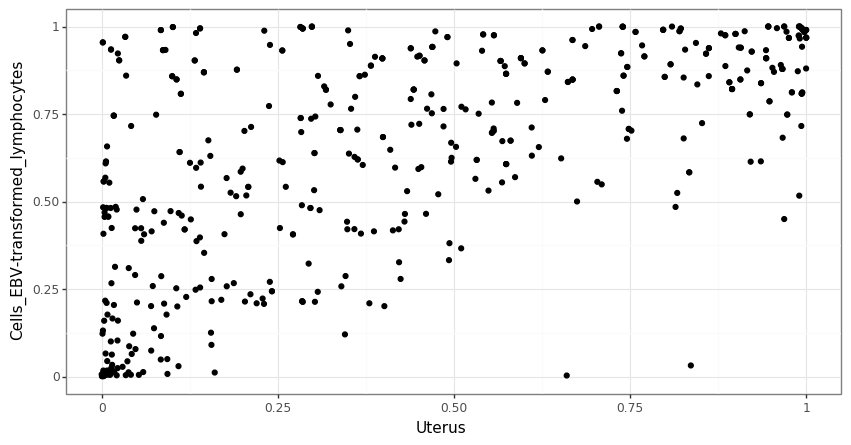

<ggplot: (2978345922723)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1162 rows containing missing values.


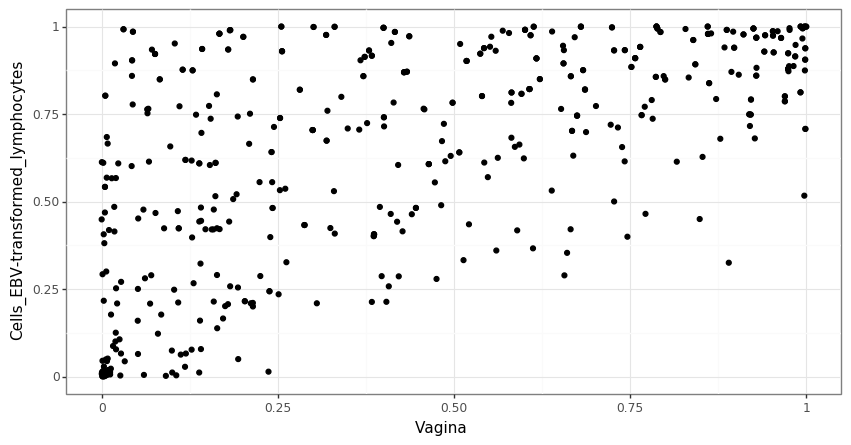

<ggplot: (2978360508489)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 739 rows containing missing values.


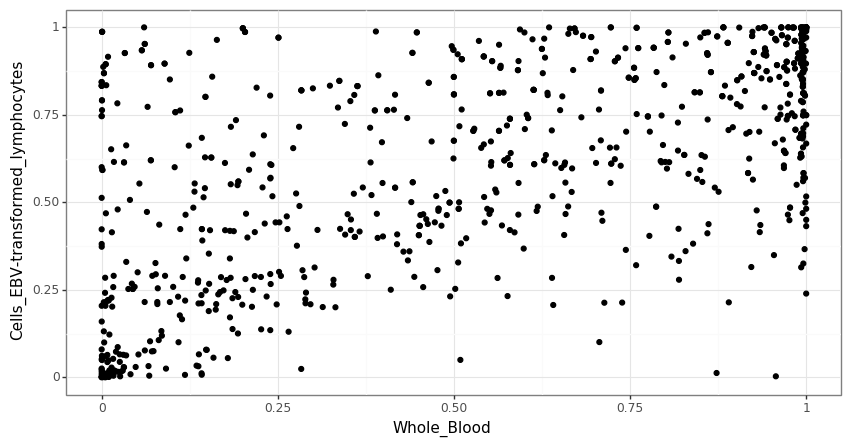

<ggplot: (2978345184648)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1111 rows containing missing values.


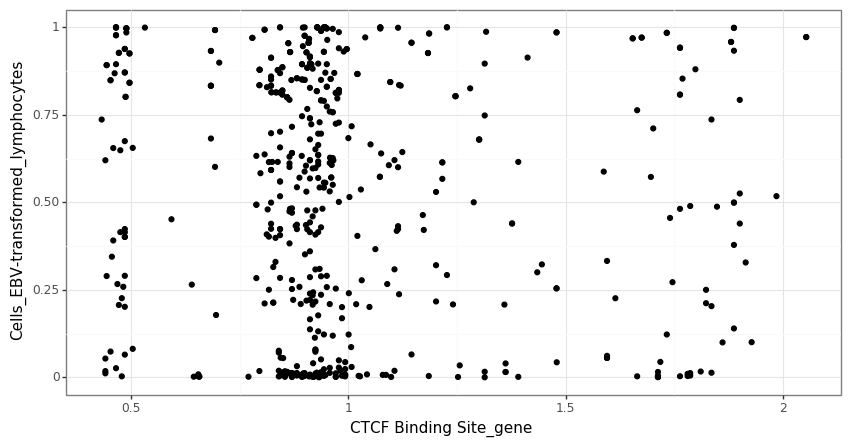

<ggplot: (2978356057215)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1274 rows containing missing values.


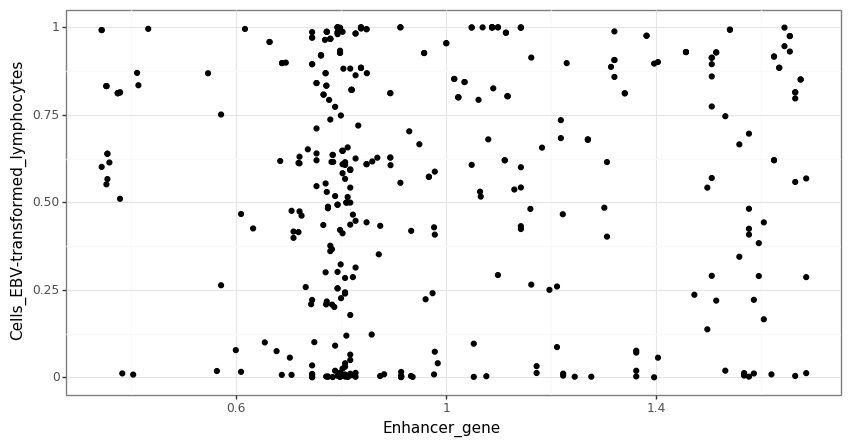

<ggplot: (2978346928900)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 837 rows containing missing values.


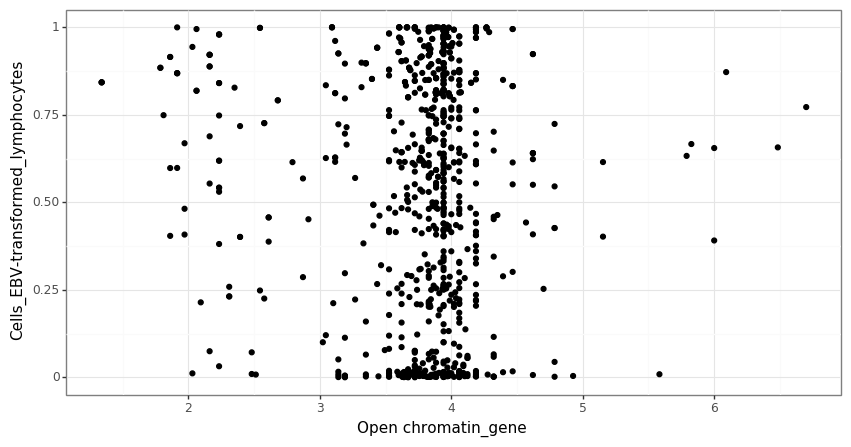

<ggplot: (2978346926867)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 312 rows containing missing values.


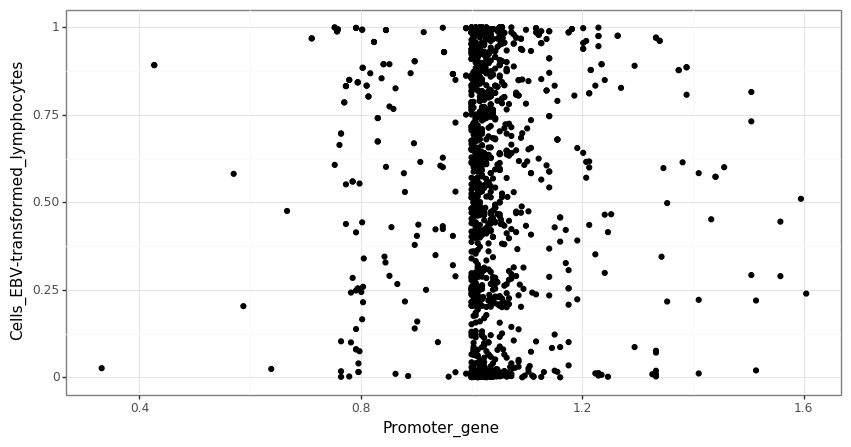

<ggplot: (2978364036172)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1040 rows containing missing values.


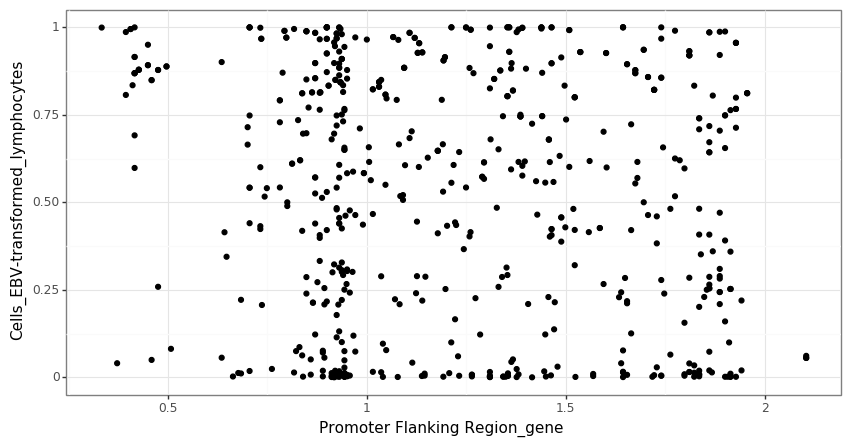

<ggplot: (2978360181998)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1239 rows containing missing values.


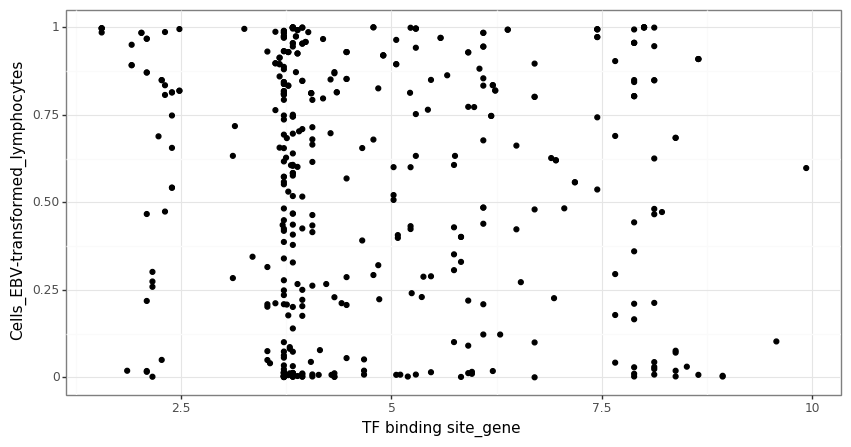

<ggplot: (2978345566736)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1635 rows containing missing values.


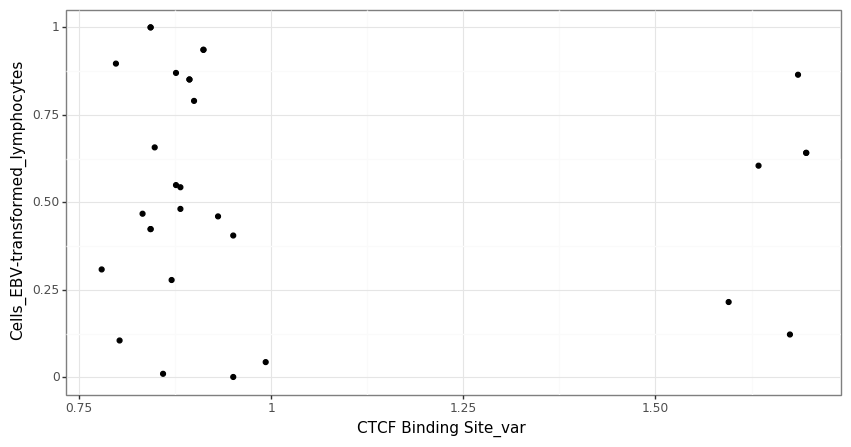

<ggplot: (2978345575162)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1657 rows containing missing values.


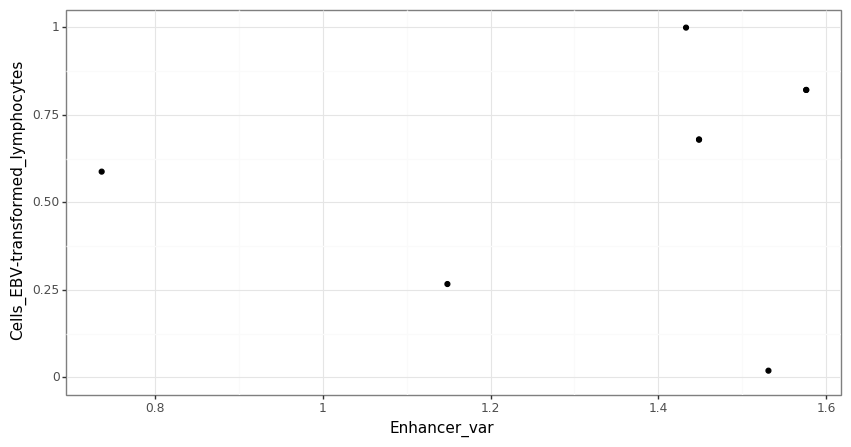

/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1640 rows containing missing values.


<ggplot: (2978371261383)>


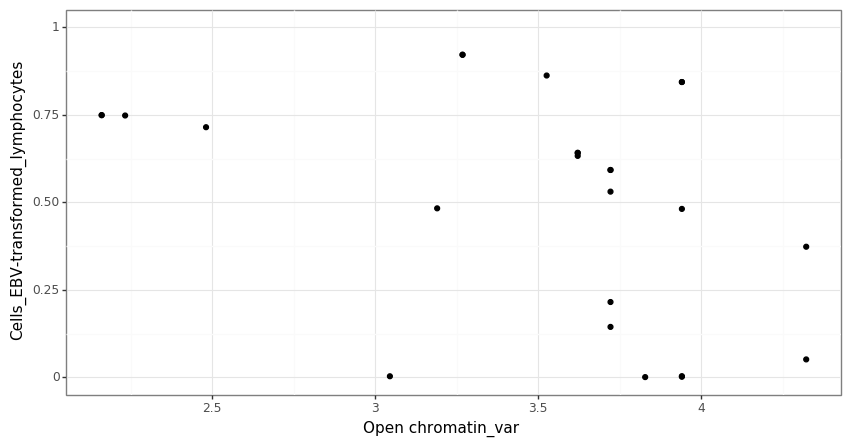

<ggplot: (2978356338231)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1165 rows containing missing values.


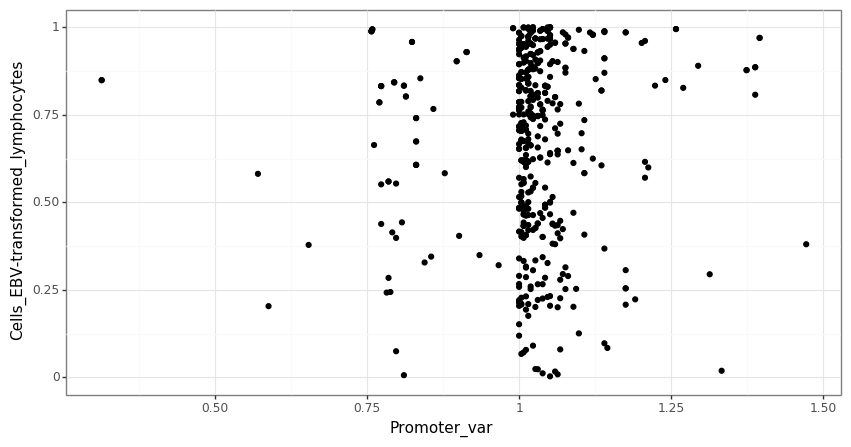

<ggplot: (2978348895672)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1577 rows containing missing values.


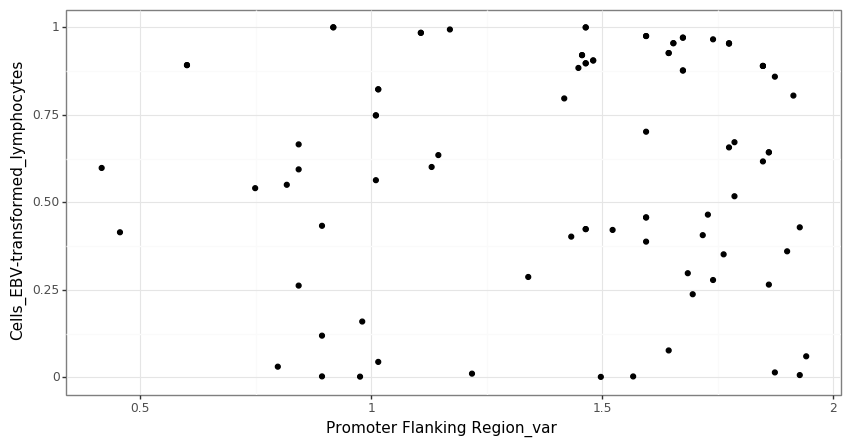

/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 1651 rows containing missing values.


<ggplot: (2978347638556)>


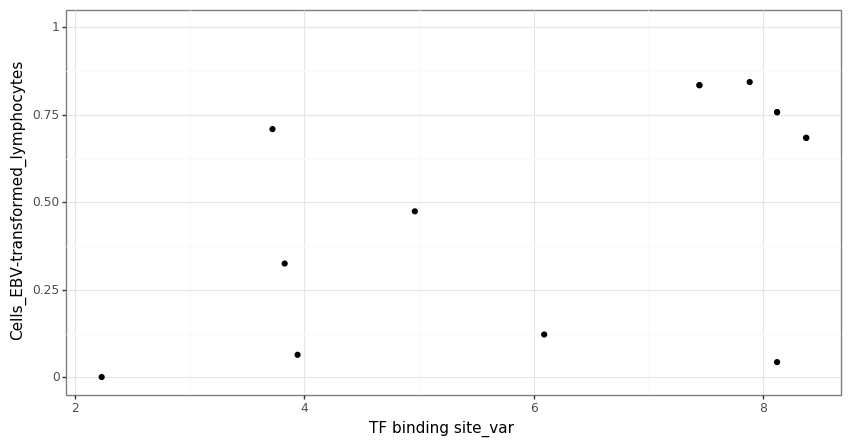

<ggplot: (2978348946905)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 119 rows containing missing values.


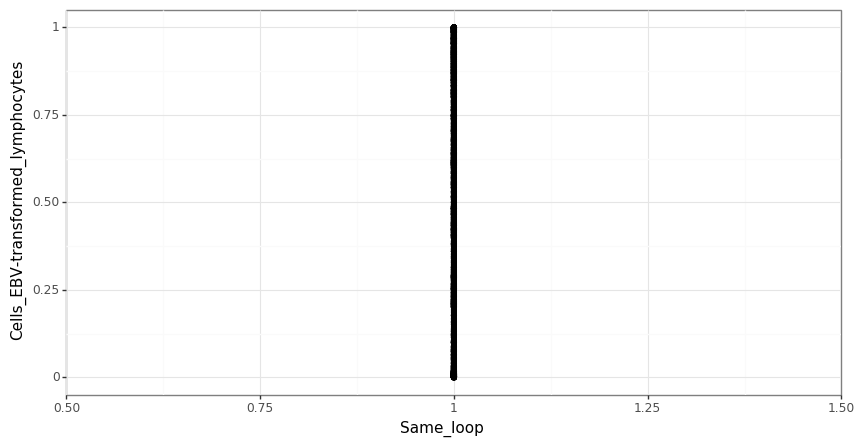

<ggplot: (2978347632195)>


In [1017]:
for i in ML_data.columns.drop(['gene_id','eQTL','var_chr']):
    x=i
    y=target
    plot=(
        ggplot(ML_data,aes(x=x,y=y))
        +geom_point()
        +theme_bw()
    )
    print(plot)

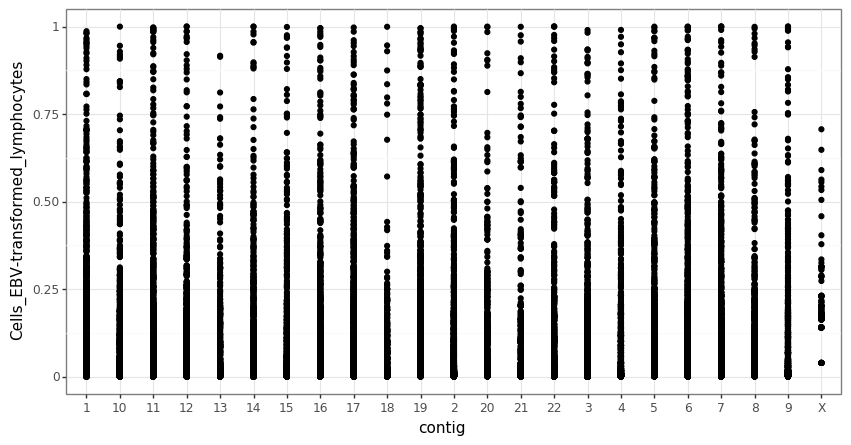

<ggplot: (2978352672407)>


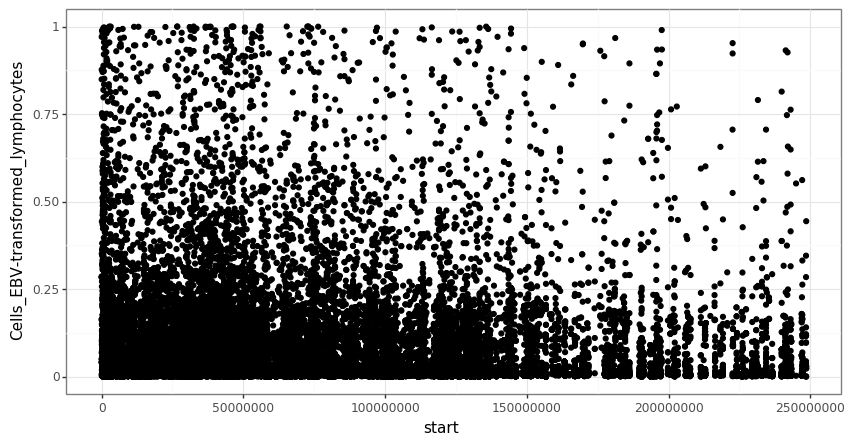

<ggplot: (2978341344591)>


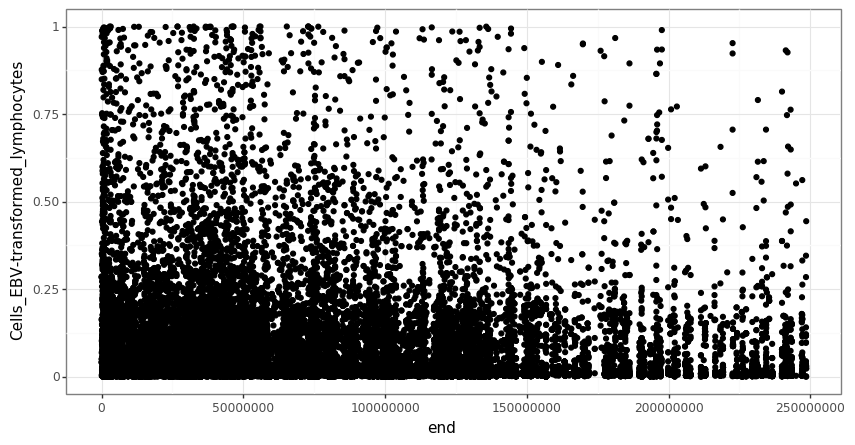

<ggplot: (2978494716151)>


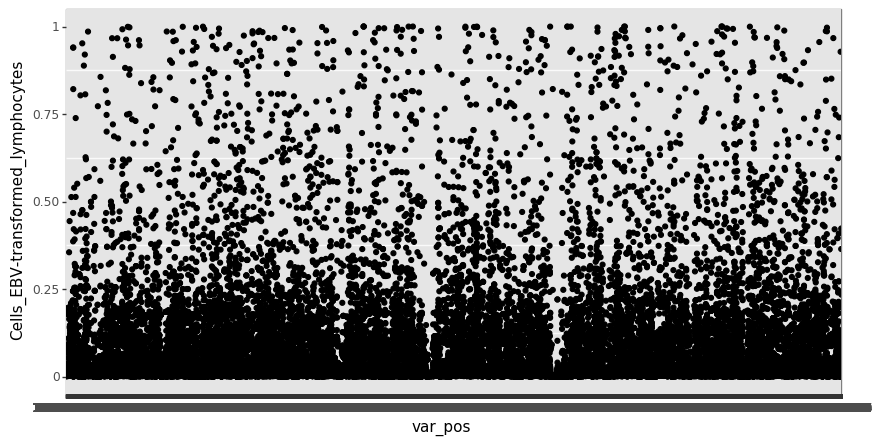

<ggplot: (2978503371454)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 32317 rows containing missing values.


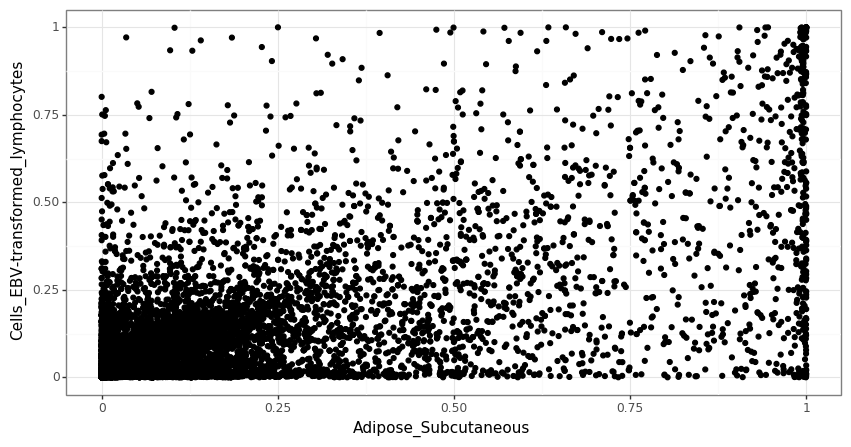

<ggplot: (2978514112211)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33768 rows containing missing values.


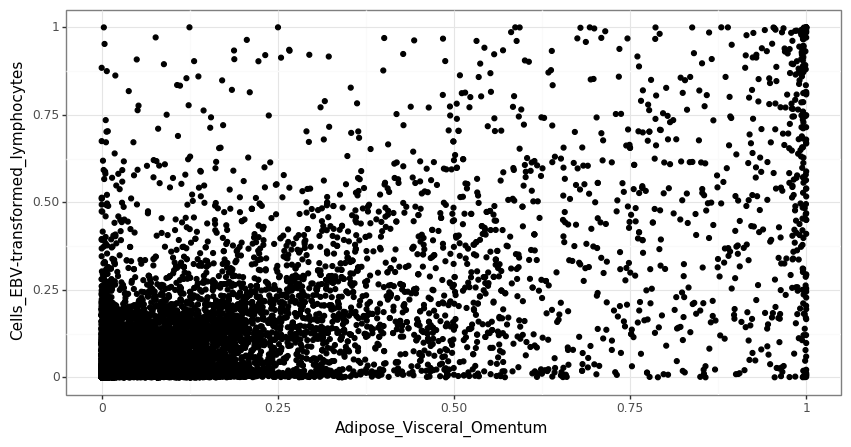

<ggplot: (2978514154469)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 35115 rows containing missing values.


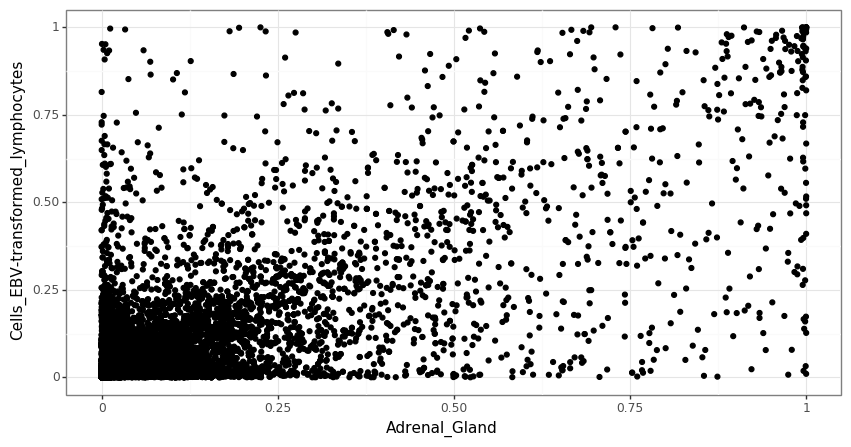

<ggplot: (2978371317571)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33136 rows containing missing values.


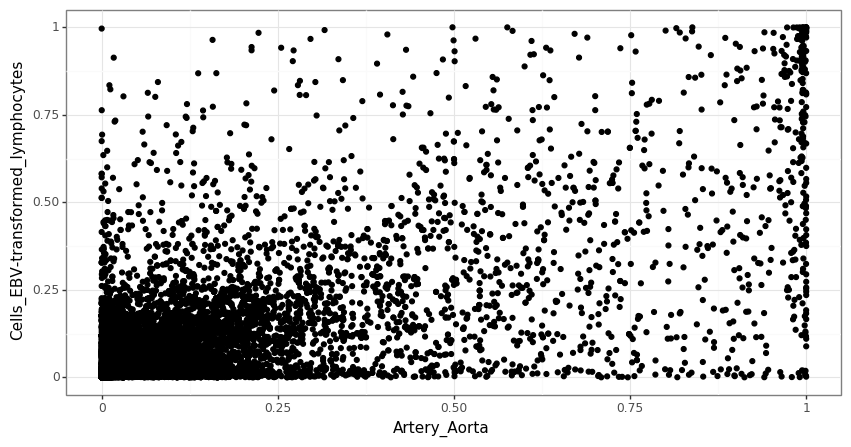

<ggplot: (2978514383216)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37231 rows containing missing values.


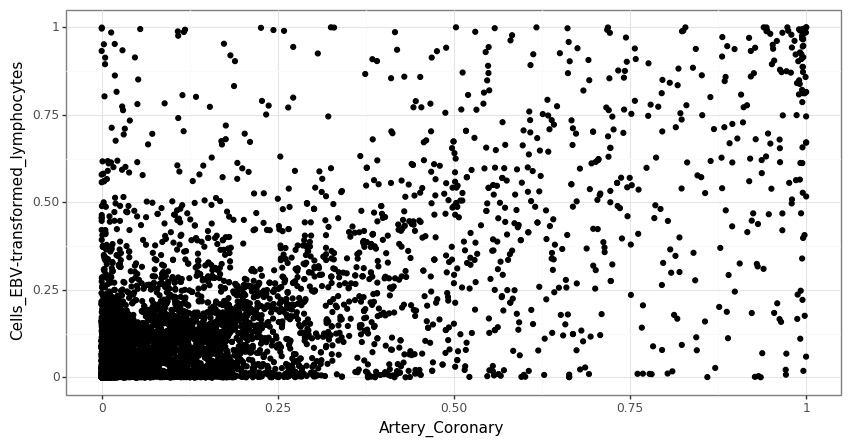

<ggplot: (2978514425555)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33693 rows containing missing values.


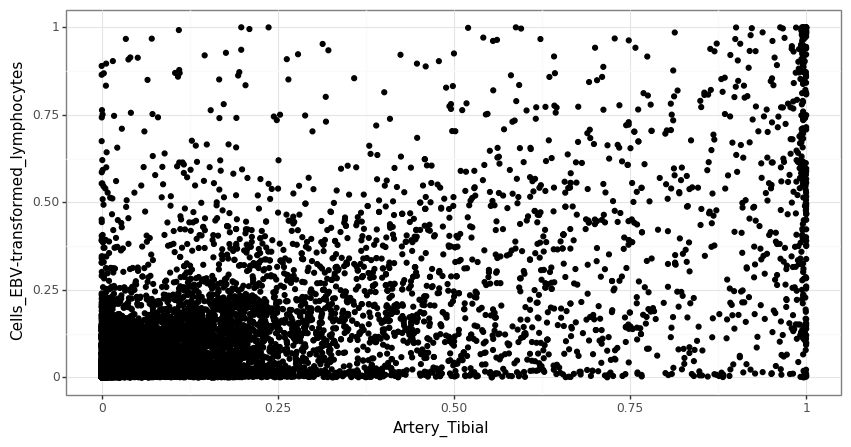

<ggplot: (2978514449933)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 41870 rows containing missing values.


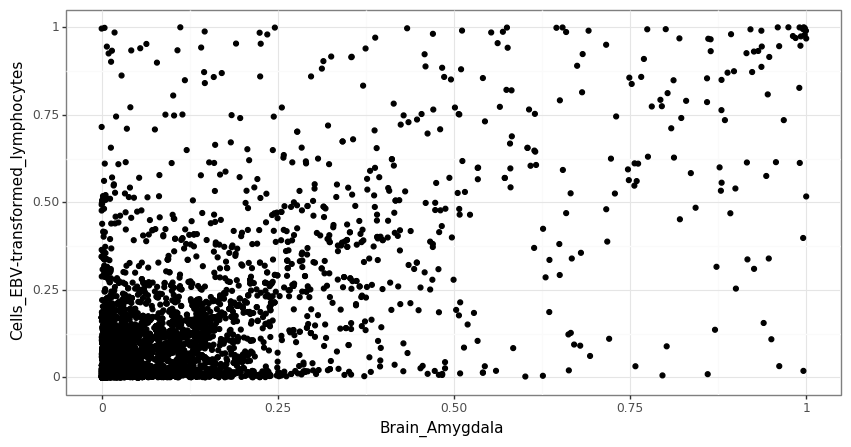

<ggplot: (2978514491938)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 40582 rows containing missing values.


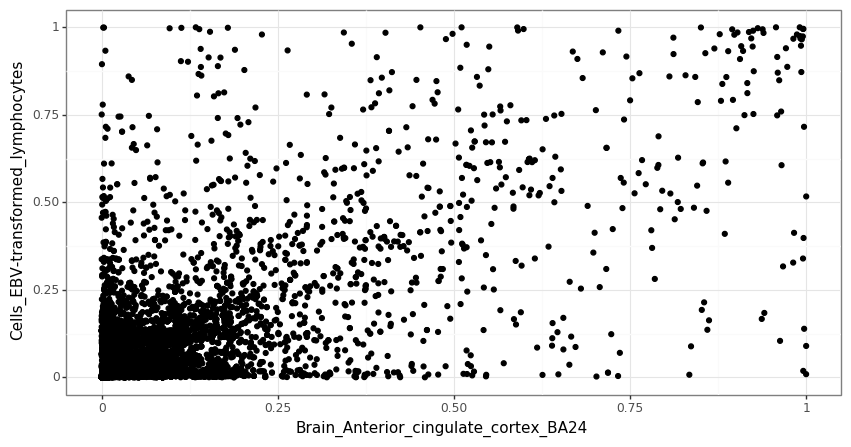

<ggplot: (2978514533750)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37246 rows containing missing values.


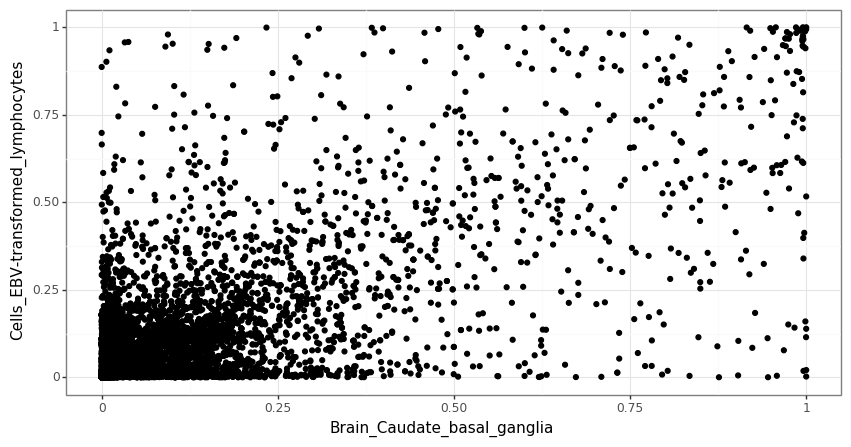

<ggplot: (2978514570503)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37954 rows containing missing values.


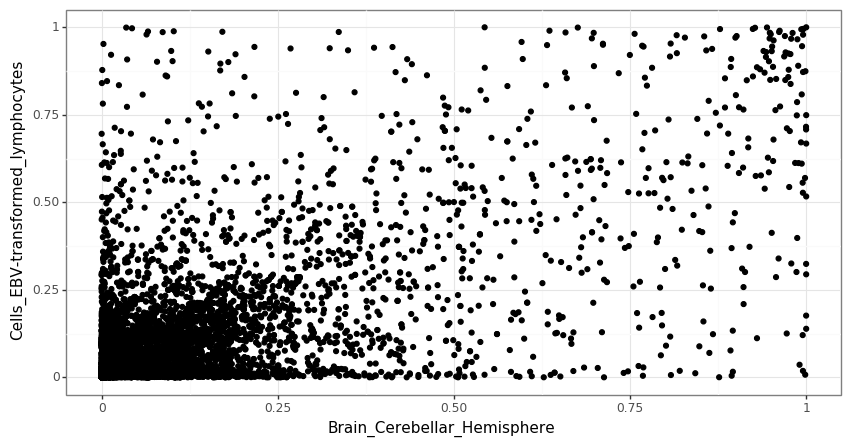

<ggplot: (2978514607978)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 36605 rows containing missing values.


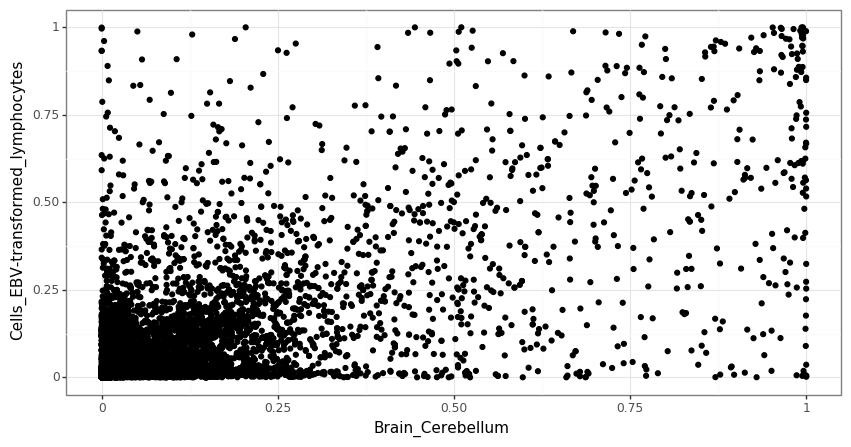

<ggplot: (2978514645221)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37345 rows containing missing values.


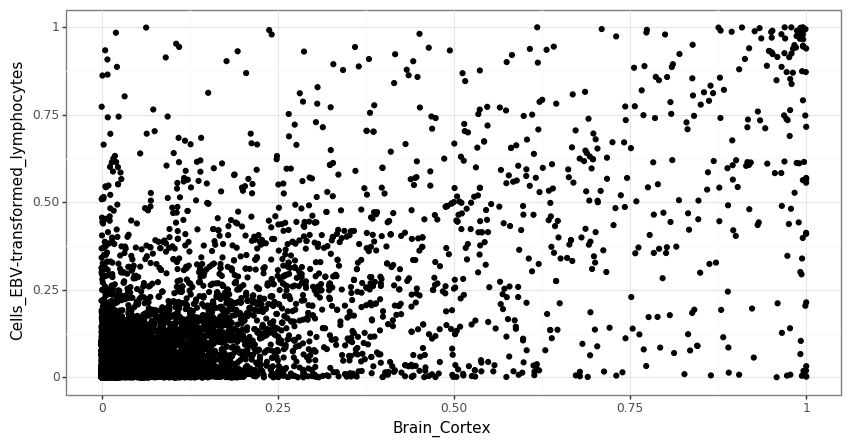

<ggplot: (2978514685775)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37997 rows containing missing values.


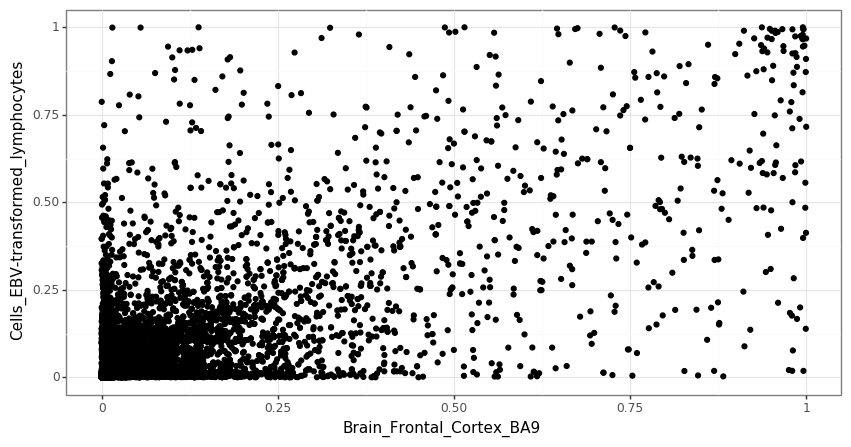

<ggplot: (2978514723054)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 39478 rows containing missing values.


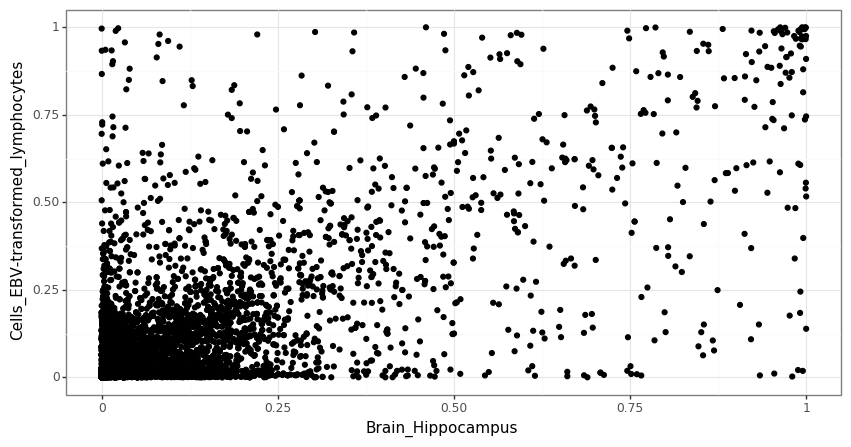

<ggplot: (2978514761828)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37486 rows containing missing values.


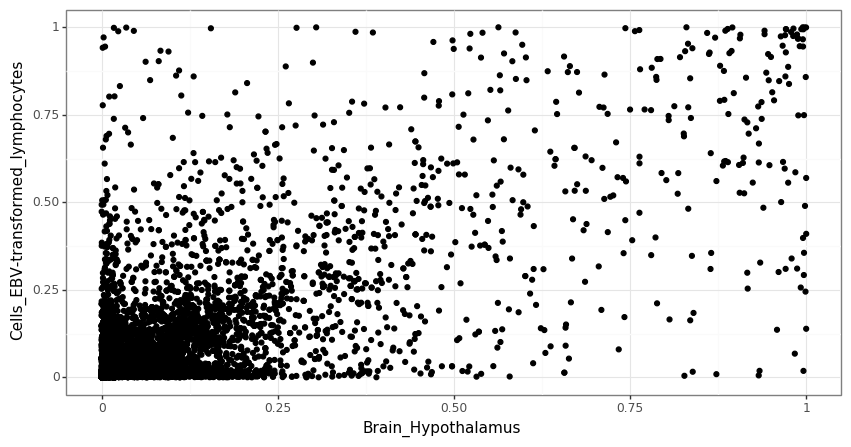

<ggplot: (2978514798686)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 36423 rows containing missing values.


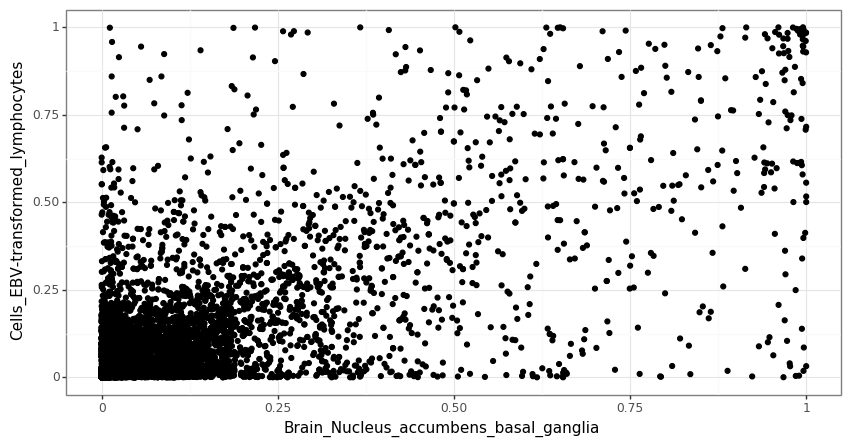

<ggplot: (2978514841281)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37654 rows containing missing values.


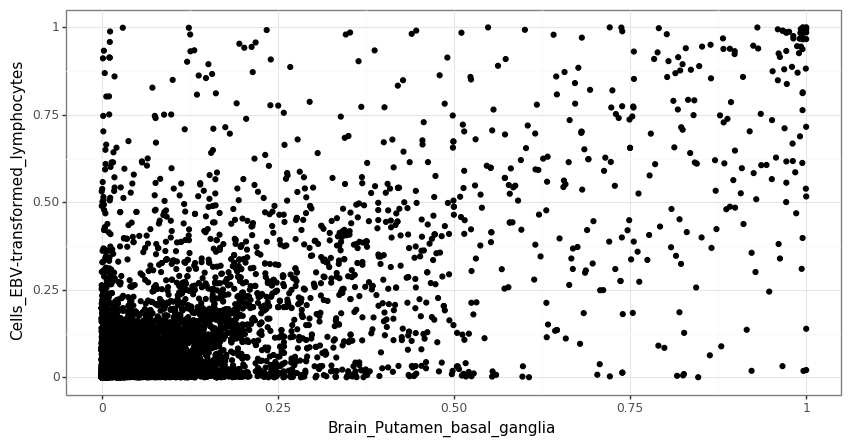

<ggplot: (2978514875444)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 41074 rows containing missing values.


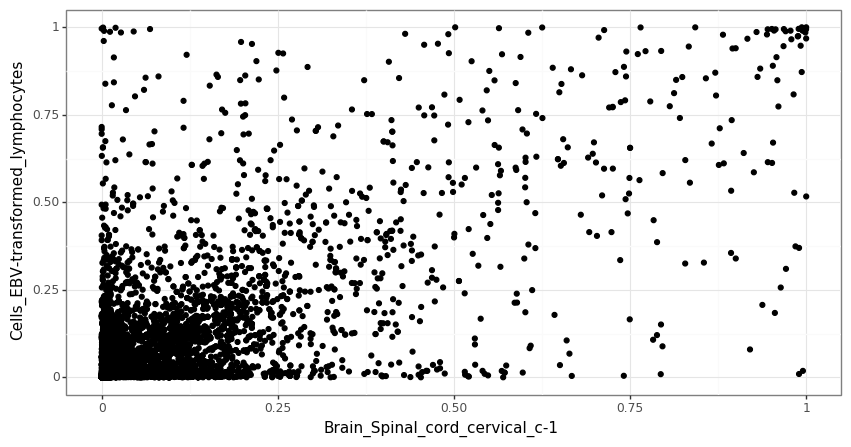

<ggplot: (2978514906884)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 42647 rows containing missing values.


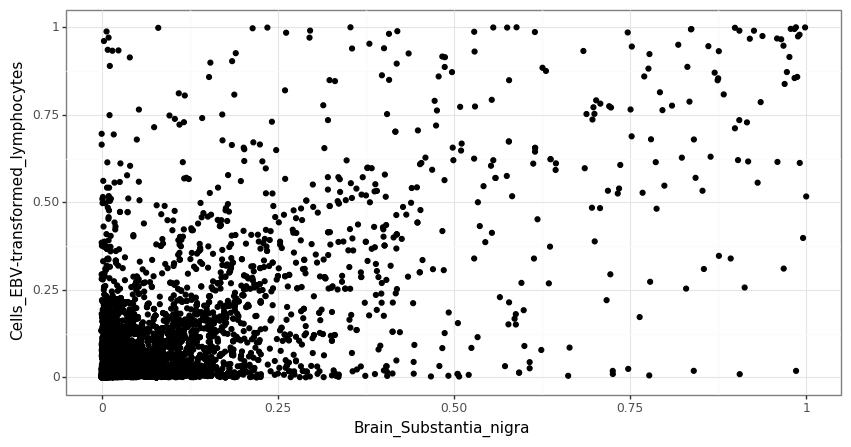

<ggplot: (2978514947157)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 34107 rows containing missing values.


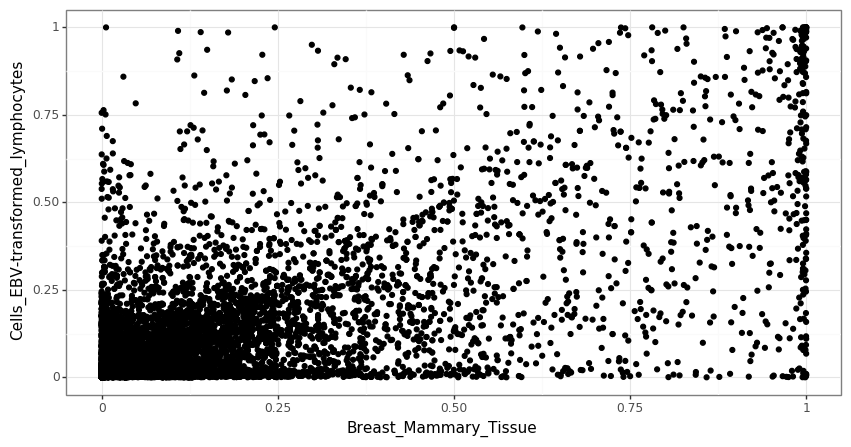

<ggplot: (2978514984241)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33128 rows containing missing values.


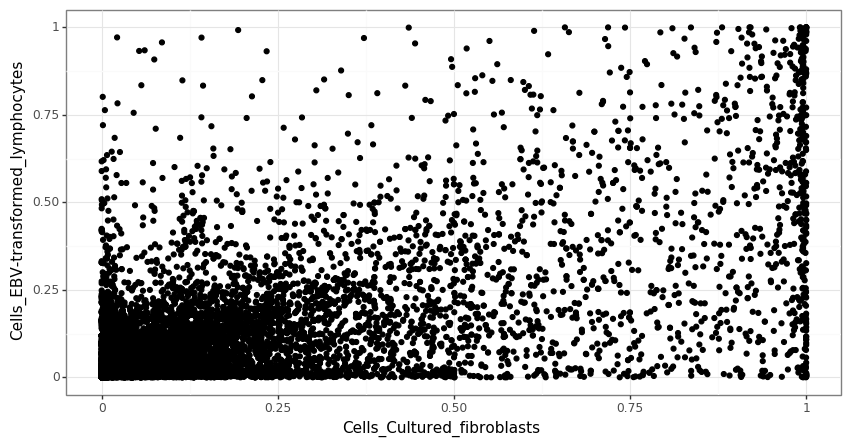

<ggplot: (2978515023436)>


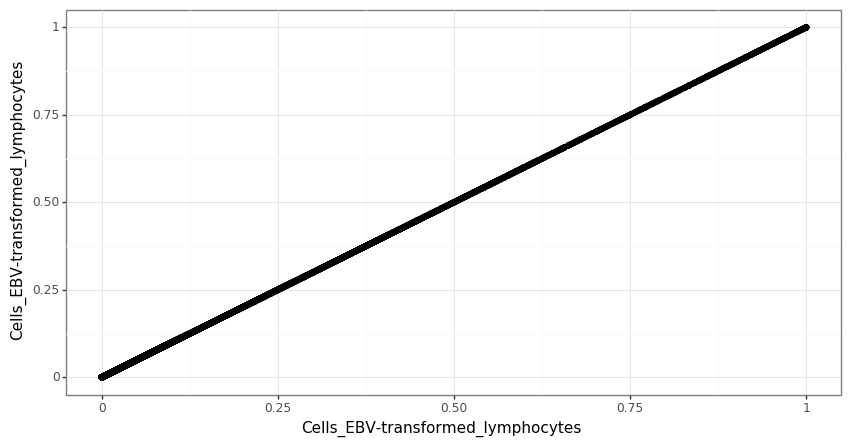

<ggplot: (2978515059228)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 35290 rows containing missing values.


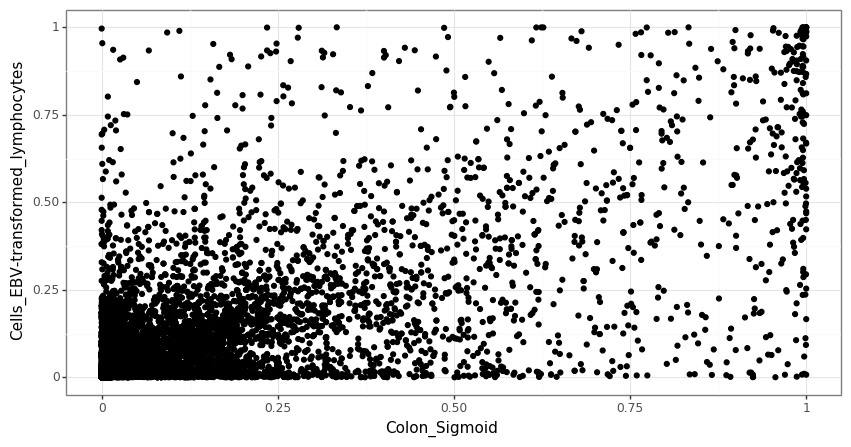

<ggplot: (2978515095679)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33261 rows containing missing values.


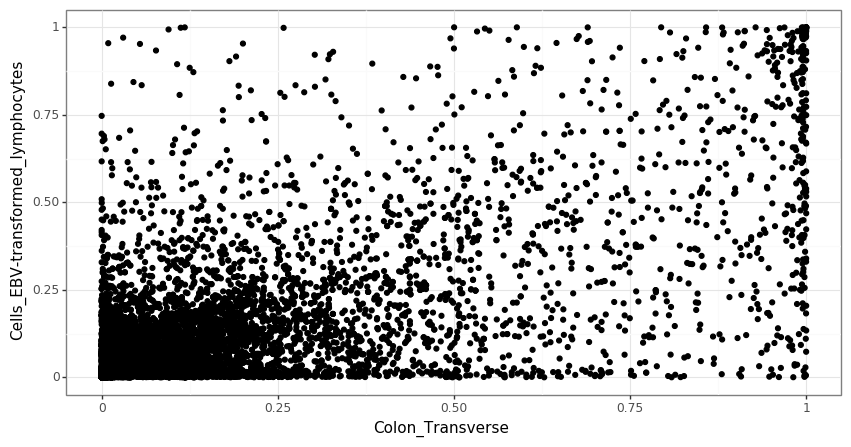

<ggplot: (2978514674324)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 34239 rows containing missing values.


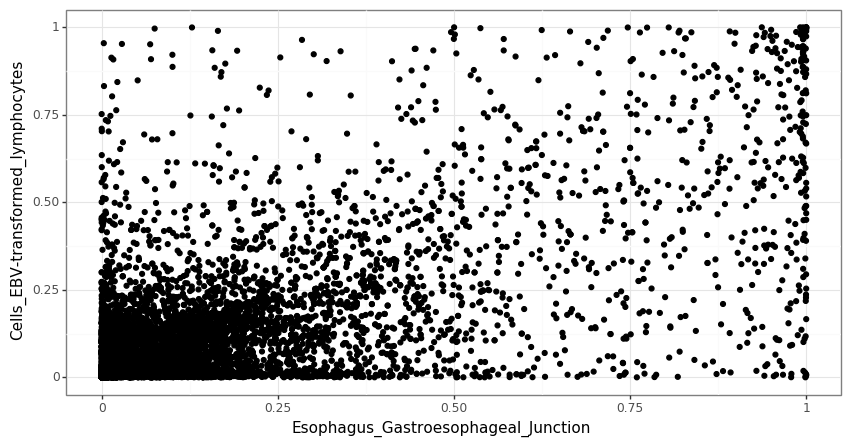

<ggplot: (2978515166739)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 32453 rows containing missing values.


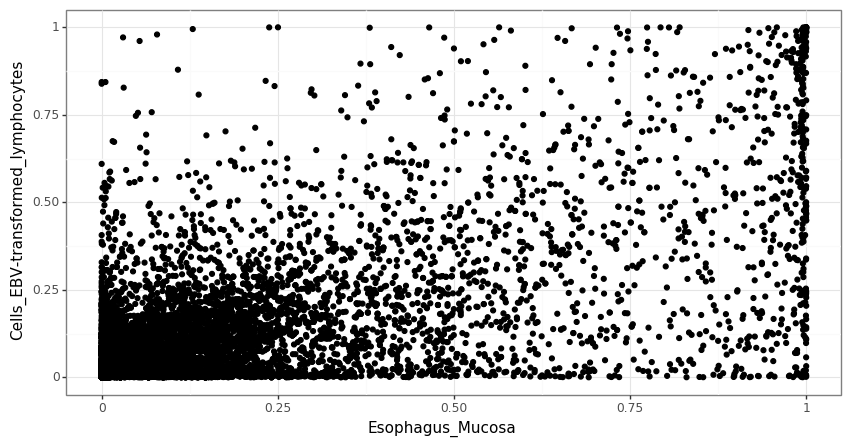

<ggplot: (2978515200169)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 34068 rows containing missing values.


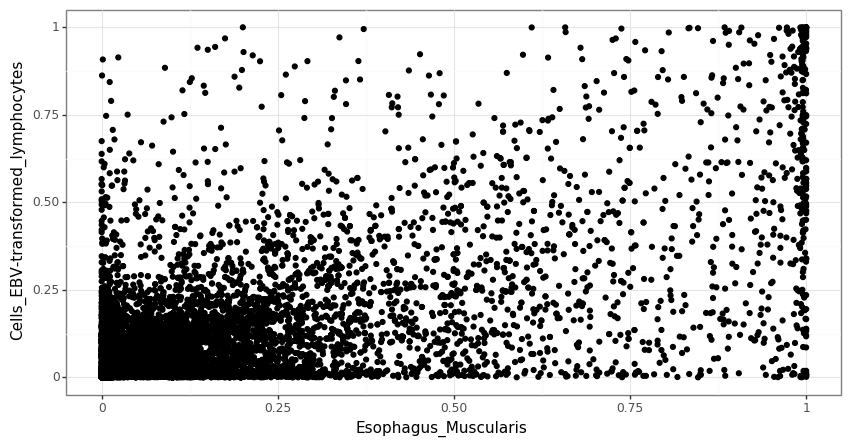

<ggplot: (2978515237669)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33788 rows containing missing values.


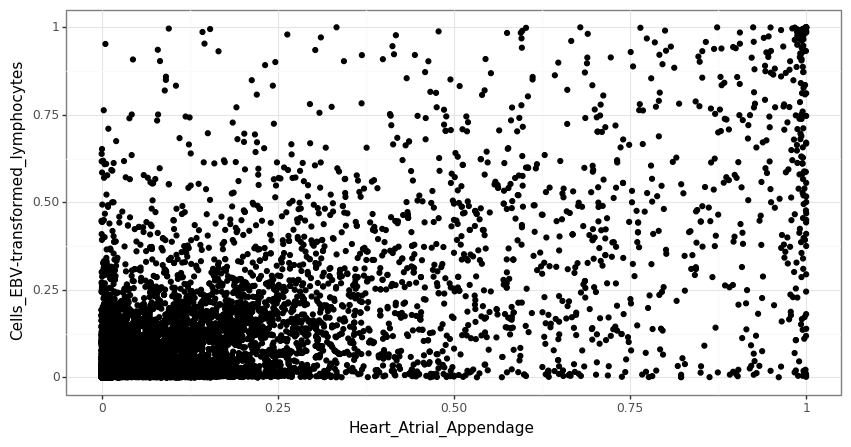

<ggplot: (2978515267597)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 36751 rows containing missing values.


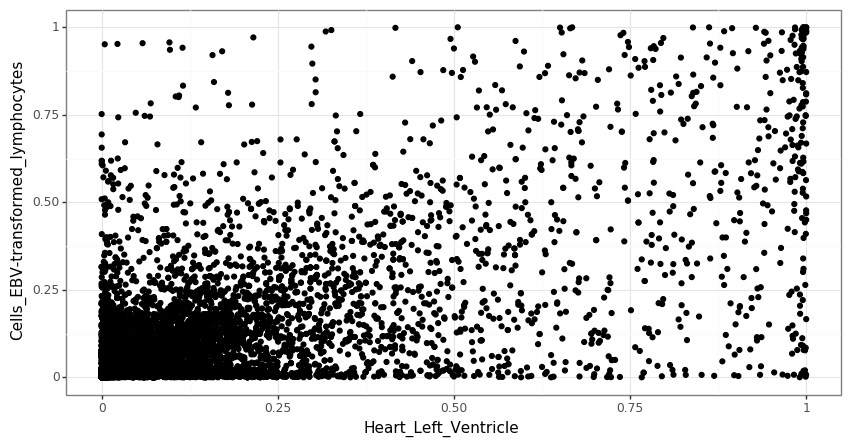

<ggplot: (2978515305009)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 44571 rows containing missing values.


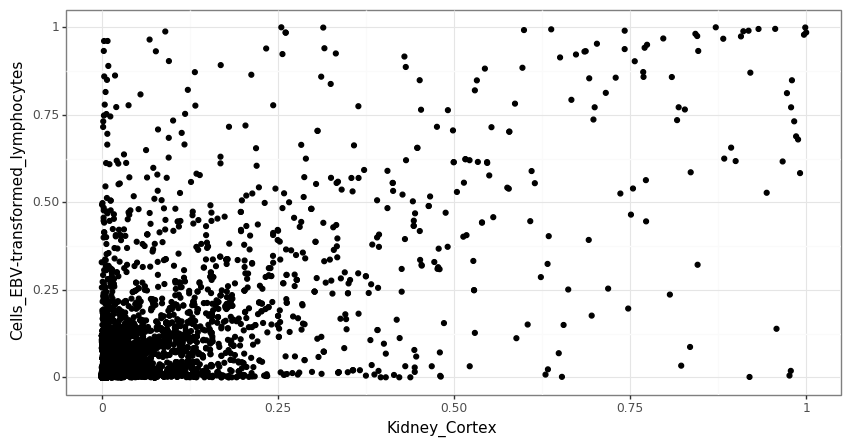

<ggplot: (2978515338301)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 40017 rows containing missing values.


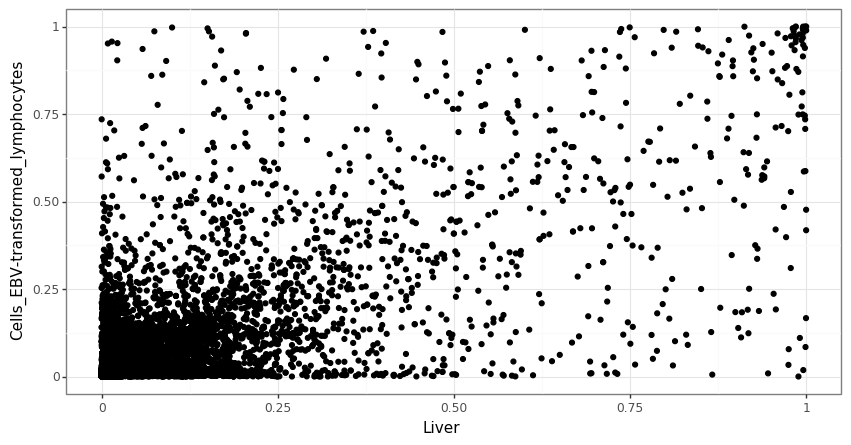

<ggplot: (2978515373415)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 32235 rows containing missing values.


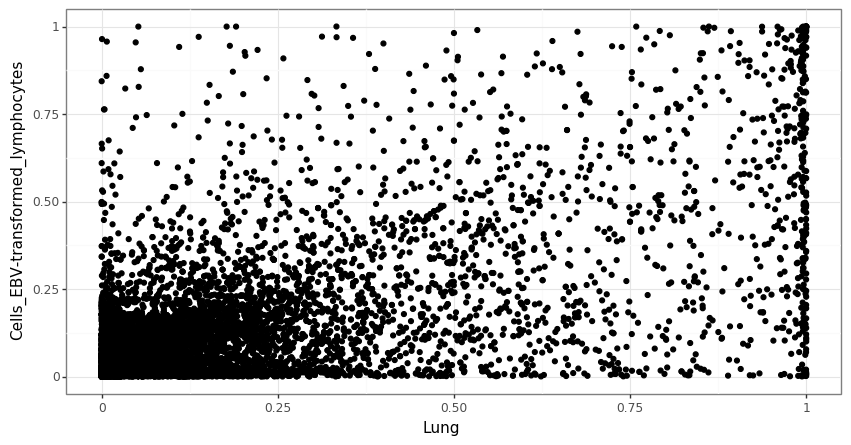

<ggplot: (2978515409595)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 39006 rows containing missing values.


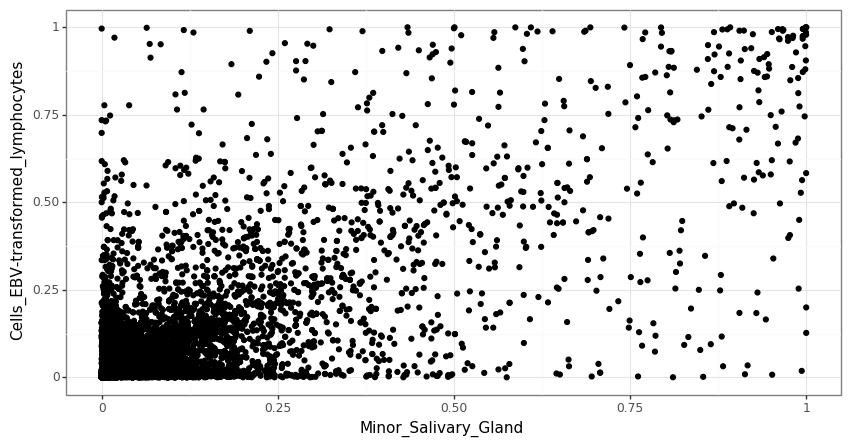

<ggplot: (2978515443225)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 36913 rows containing missing values.


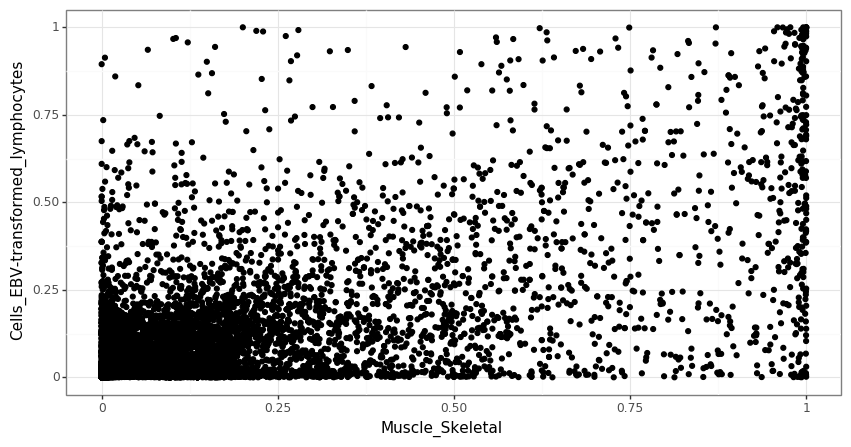

<ggplot: (2978515479176)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33893 rows containing missing values.


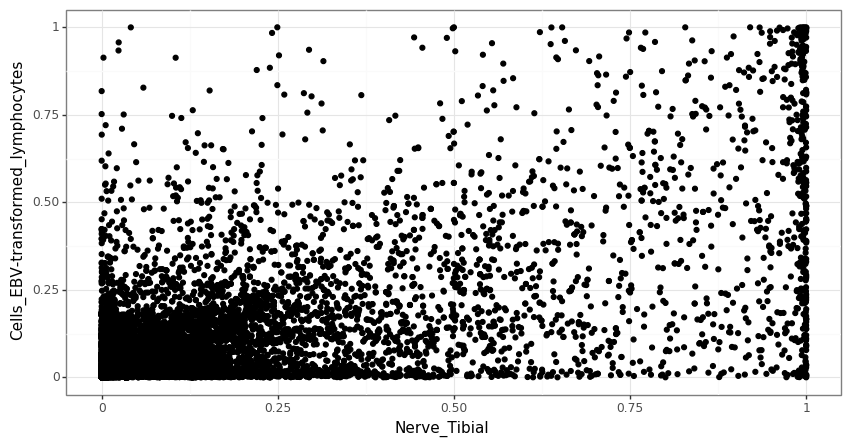

<ggplot: (2978515516582)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 39796 rows containing missing values.


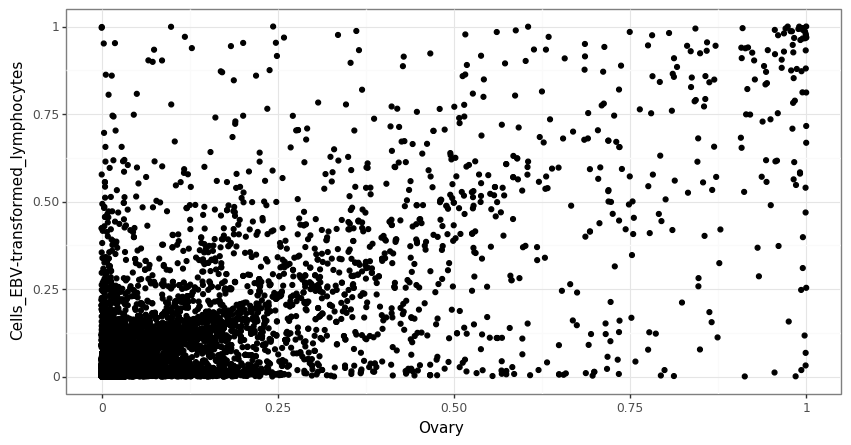

<ggplot: (2978515548492)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 35828 rows containing missing values.


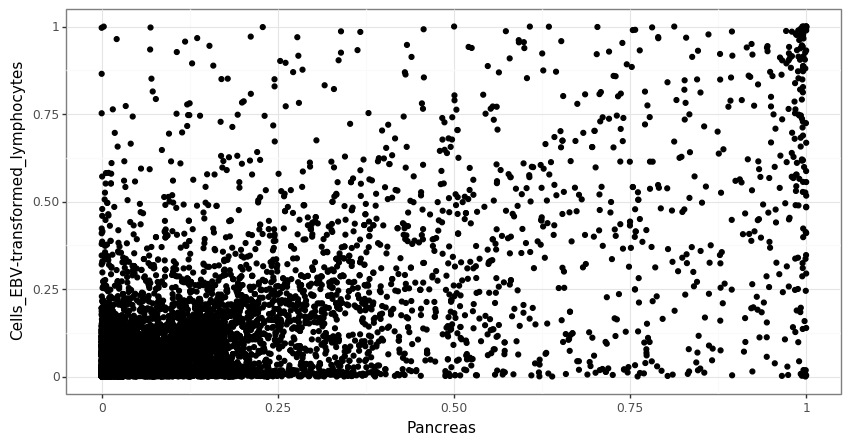

<ggplot: (2978515582317)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 36769 rows containing missing values.


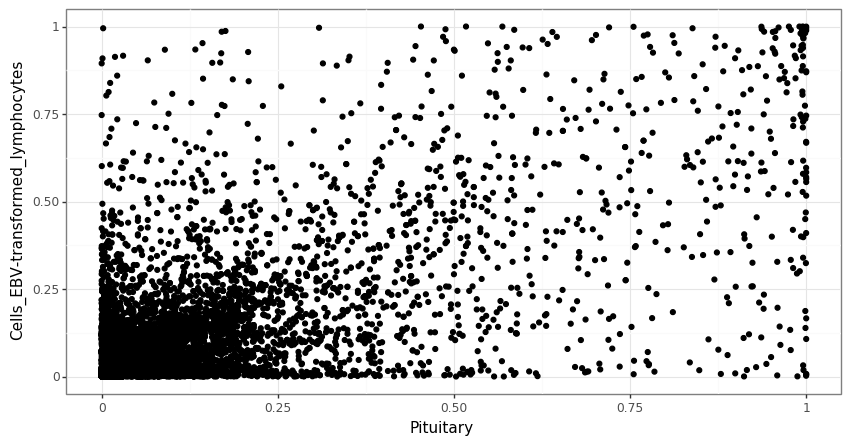

<ggplot: (2978515618633)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 37512 rows containing missing values.


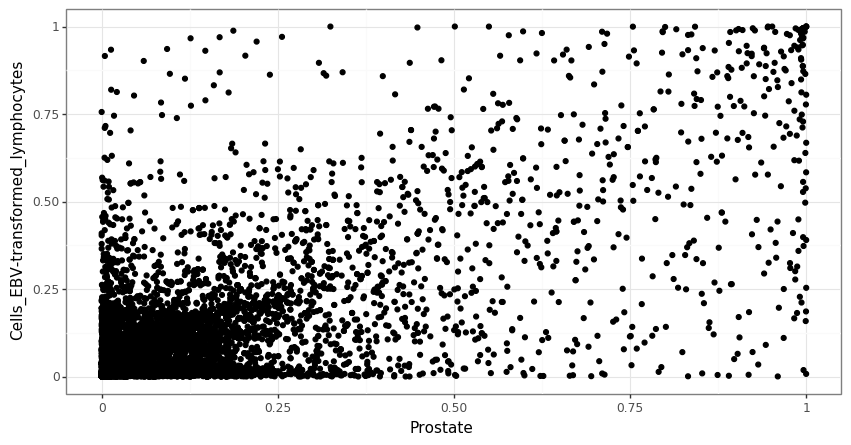

<ggplot: (2978515655120)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 36071 rows containing missing values.


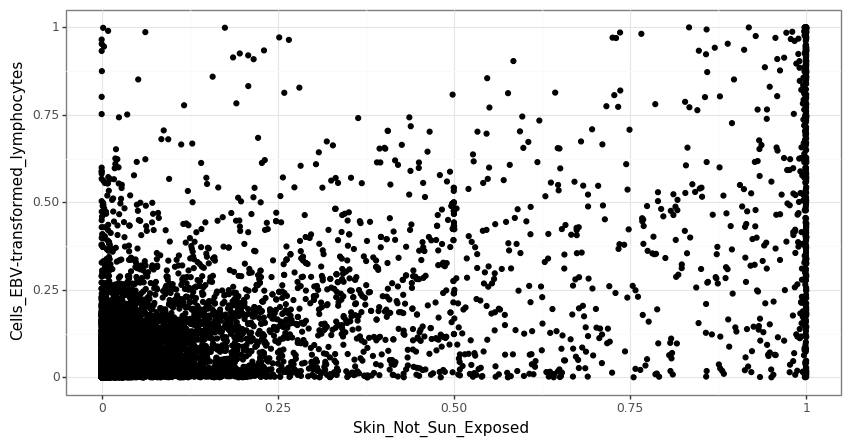

<ggplot: (2978515689786)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 46505 rows containing missing values.


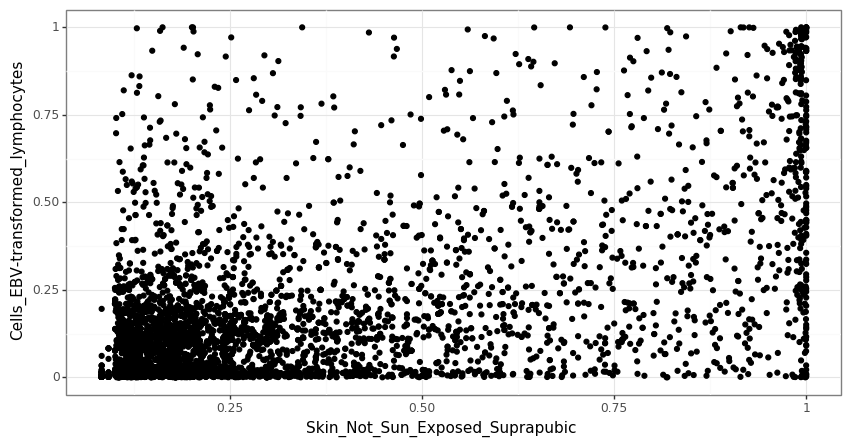

<ggplot: (2978515722159)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 35995 rows containing missing values.


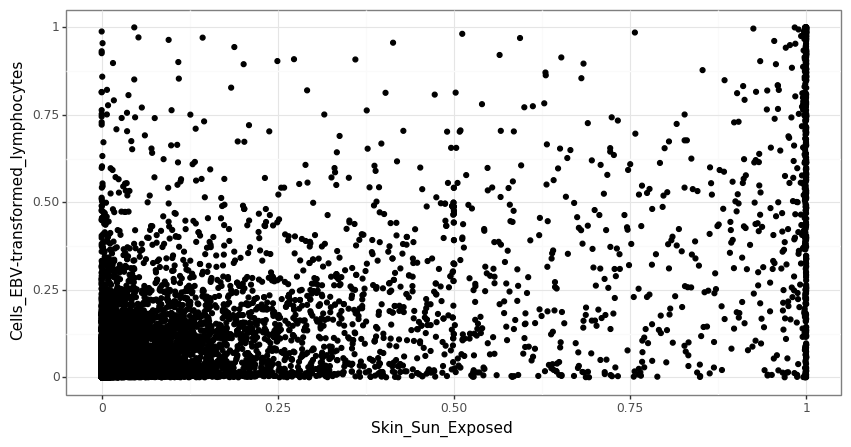

<ggplot: (2978527951933)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 46643 rows containing missing values.


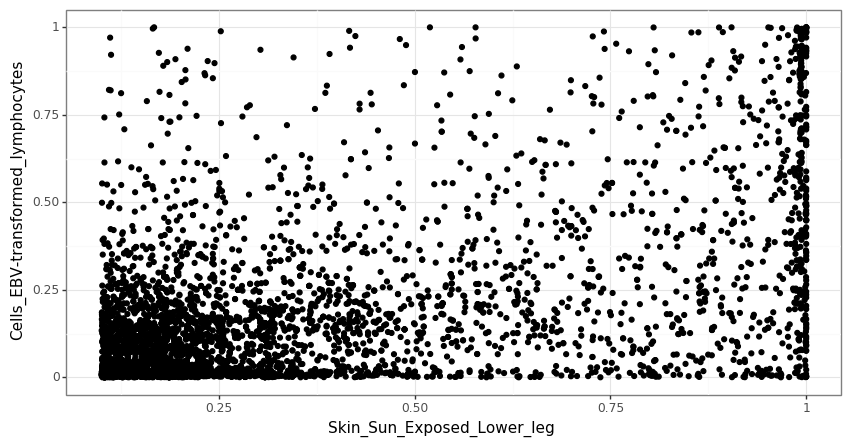

<ggplot: (2978529275835)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 35699 rows containing missing values.


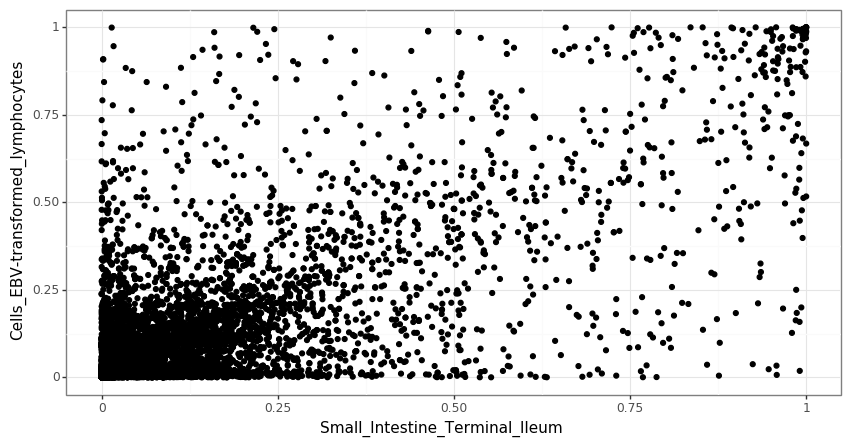

<ggplot: (2978515646736)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 33369 rows containing missing values.


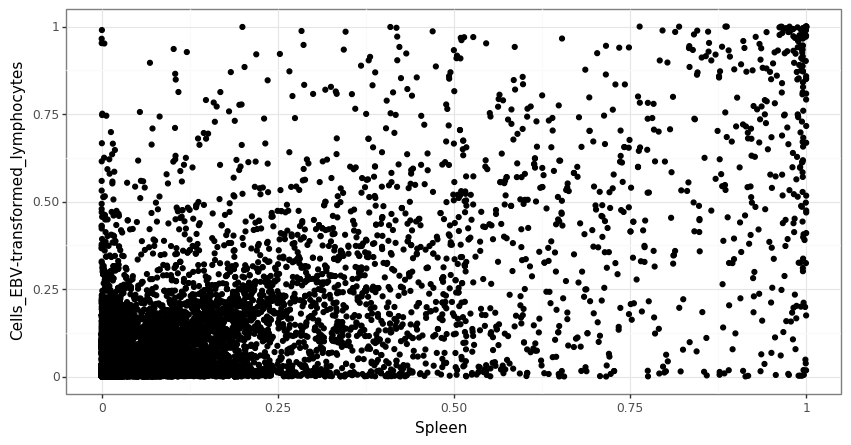

<ggplot: (2978529750089)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 35450 rows containing missing values.


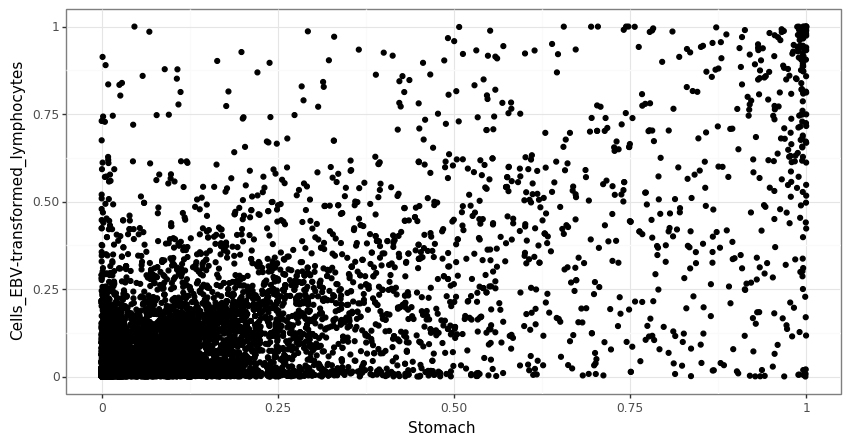

<ggplot: (2978529841243)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 36946 rows containing missing values.


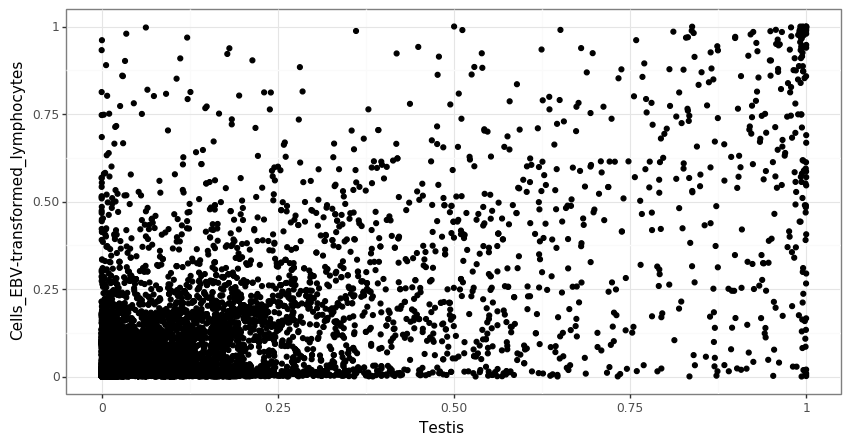

<ggplot: (2978529802349)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 34747 rows containing missing values.


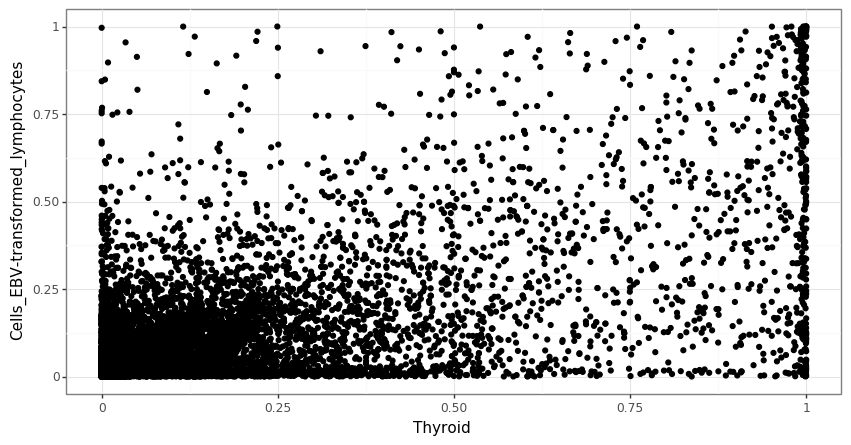

<ggplot: (2978529795711)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 41851 rows containing missing values.


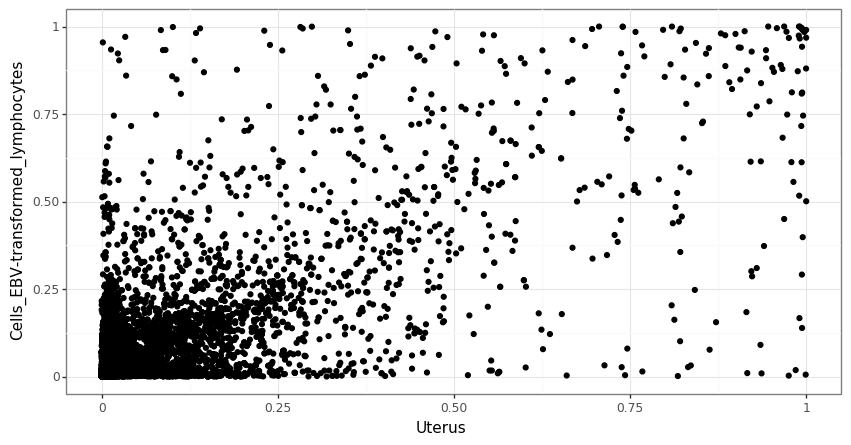

<ggplot: (2978529974676)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 41538 rows containing missing values.


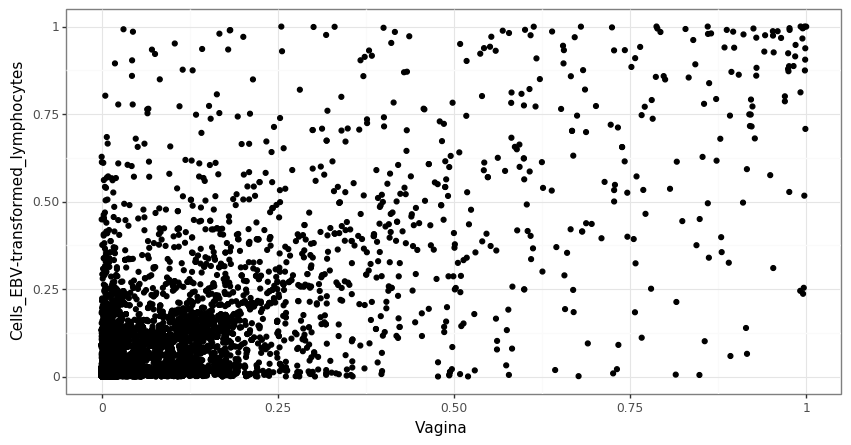

<ggplot: (2978529665699)>


/homes/jhidalgo/.local/lib/python3.8/site-packages/plotnine/layer.py:467: PlotnineWarning: geom_point : Removed 34059 rows containing missing values.


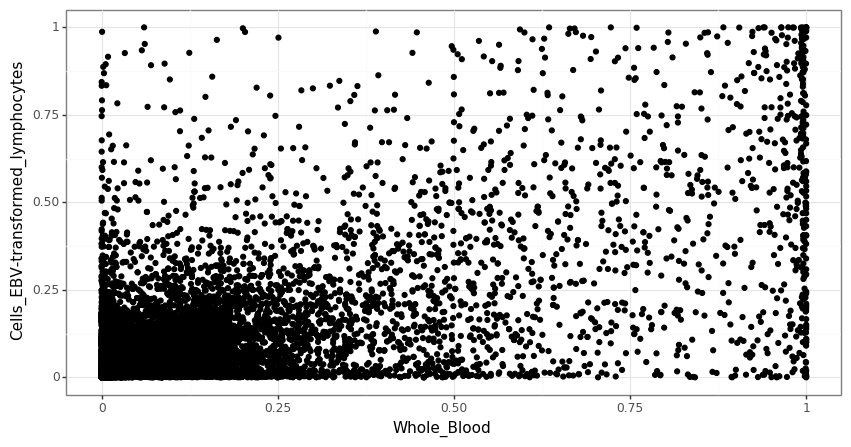

<ggplot: (2978529992629)>


In [1018]:
for i in data_merged.columns.drop(['gene_id','eQTL','var_chr']):
    x=i
    y=target
    plot=(
        ggplot(data_merged,aes(x=x,y=y))
        +geom_point()
        +theme_bw()
    )
    print(plot)

# OLD CODE

In [143]:
reg_build_gff=gffpd.read_gff3('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/original-data/regbuild/homo_sapiens.GRCh38.GM12878.Regulatory_Build.regulatory_activity.20161111.gff')

In [144]:
reg_build_gff=reg_build_gff.attributes_to_columns()[['seq_id','start','end','regulatory_feature_stable_id','feature_type','activity']]

In [145]:
reg_build_bed=pybedtools.BedTool.from_dataframe(reg_build_gff)

In [147]:
names=['chrom', 'start', 'end', 'gene_id', 'eQTL', 'strand', 'thickStart','thickEnd', 'reg_id', 'regbuild_snp_feature_type', 'regbuild_snp_activity']

In [148]:
gene_intersection=gene_bed.intersect(reg_build_bed, wa=True, wb=True, loj=True).to_dataframe(names=names)[['gene_id','eQTL','reg_id','regbuild_snp_feature_type','regbuild_snp_activity']]

/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


In [149]:
gene_intersection['regbuild_snp_activity']=gene_intersection['regbuild_snp_activity'].replace({'REPRESSED':1,'INACTIVE':2,'POISED':3,'ACTIVE':4,'.':0}).astype('int')

In [150]:
gene_intersection[gene_intersection['gene_id']=='ENSG00000228327']

,gene_id,eQTL,reg_id,regbuild_snp_feature_type,regbuild_snp_activity
4785,ENSG00000228327,chr1_777135,ENSR00000000074,Open chromatin,1
4786,ENSG00000228327,chr1_777135,ENSR00000000073,TF binding site,2
4787,ENSG00000228327,chr1_777135,ENSR00000000076,Open chromatin,2
4788,ENSG00000228327,chr1_777135,ENSR00000000075,Open chromatin,2
4789,ENSG00000228327,chr1_777135,ENSR00000000078,Open chromatin,2
4790,ENSG00000228327,chr1_777135,ENSR00000000079,Open chromatin,2
4791,ENSG00000228327,chr1_777135,ENSR00000000080,Open chromatin,2
4792,ENSG00000228327,chr1_777135,ENSR00000000081,Promoter,4
4793,ENSG00000228327,chr1_777135,ENSR00000000077,Open chromatin,2
7631,ENSG00000228327,chr1_777135,ENSR00000000074,Open chromatin,1


In [151]:
gene_intersection_table=gene_intersection.pivot_table(index=['gene_id','eQTL'], columns=['regbuild_snp_feature_type'], values='regbuild_snp_activity').drop(columns='.')

In [152]:
gene_intersection_table

regbuild_snp_feature_type       CTCF Binding Site  Enhancer  Open chromatin  \
gene_id         eQTL                                                          
ENSG00000003393 chr2_201788249           4.000000       NaN             2.0   
ENSG00000005156 chr17_34980567                NaN       2.0             2.0   
                chr17_35005158                NaN       2.0             2.0   
ENSG00000005882 chr17_50094913                NaN       2.0             2.0   
ENSG00000006282 chr17_50547162           1.000000       NaN             NaN   
...                                           ...       ...             ...   
ENSG00000281103 chr7_38344703            2.222222       NaN             NaN   
                chr7_38361383            2.222222       NaN             NaN   
ENSG00000282826 chr20_28642057           2.000000       NaN             NaN   
ENSG00000283312 chr2_231484825                NaN       NaN             NaN   
ENSG00000283426 chr3_195654189                NaN       NaN             NaN   

regbuild_snp_feature_type       Promoter  Promoter Flanking Region  \
gene_id         eQTL                                                 
ENSG00000003393 chr2_201788249       4.0                       NaN   
ENSG00000005156 chr17_34980567       4.0                  2.000000   
                chr17_35005158       4.0                  2.000000   
ENSG00000005882 chr17_50094913       4.0                  2.000000   
ENSG00000006282 chr17_50547162       4.0                       NaN   
...                                  ...                       ...   
ENSG00000281103 chr7_38344703        NaN                  3.333333   
                chr7_38361383        NaN                  3.333333   
ENSG00000282826 chr20_28642057       4.0                       NaN   
ENSG00000283312 chr2_231484825       NaN                       NaN   
ENSG00000283426 chr3_195654189       NaN                       NaN   

regbuild_snp_feature_type       TF binding site  
gene_id         eQTL                             
ENSG00000003393 chr2_201788249              2.0  
ENSG00000005156 chr17_34980567              3.0  
                chr17_35005158              3.0  
ENSG00000005882 chr17_50094913              NaN  
ENSG00000006282 chr17_50547162              1.0  
...                                         ...  
ENSG00000281103 chr7_38344703               NaN  
                chr7_38361383               NaN  
ENSG00000282826 chr20_28642057              NaN  
ENSG00000283312 chr2_231484825              NaN  
ENSG00000283426 chr3_195654189              NaN  

[1318 rows x 6 columns]

In [154]:
var_intersection=var_bed.intersect(reg_build_bed, wa=True, wb=True, loj=True).to_dataframe(names=names)[['gene_id','eQTL','reg_id','regbuild_snp_feature_type','regbuild_snp_activity']]

/homes/jhidalgo/.local/lib/python3.8/subprocess.py:849: RuntimeWarning: line buffering (buffering=1) isn't supported in binary mode, the default buffer size will be used


In [155]:
var_intersection['regbuild_snp_activity']=var_intersection['regbuild_snp_activity'].replace({'REPRESSED':1,'INACTIVE':2,'POISED':3,'ACTIVE':4,'.':0}).astype('int')

In [156]:
var_intersection

,gene_id,eQTL,reg_id,regbuild_snp_feature_type,regbuild_snp_activity
0,ENSG00000117115,chr1_17087810,.,.,0
1,ENSG00000132740,chr11_68938036,.,.,0
2,ENSG00000174125,chr4_38810916,.,.,0
3,ENSG00000228506,chr6_99432696,.,.,0
4,ENSG00000168268,chr3_52532049,.,.,0
...,...,...,...,...,...
1669,ENSG00000215845,chr1_161038745,ENSR00000014624,Promoter,4
1670,ENSG00000206503,chr6_29941420,.,.,0
1671,ENSG00000271605,chr17_64448998,ENSR00000096963,Promoter Flanking Region,4
1672,ENSG00000249626,chr3_197649099,.,.,0


In [157]:
var_intersection_table=var_intersection.pivot_table(index=['gene_id','eQTL'], columns=['regbuild_snp_feature_type'], values='regbuild_snp_activity').drop(columns='.')

In [158]:
var_intersection_table

regbuild_snp_feature_type       CTCF Binding Site  Enhancer  Open chromatin  \
gene_id         eQTL                                                          
ENSG00000003393 chr2_201788249                NaN       NaN             NaN   
ENSG00000005156 chr17_34980567                NaN       NaN             NaN   
                chr17_35005158                NaN       NaN             NaN   
ENSG00000005882 chr17_50094913                NaN       NaN             NaN   
ENSG00000006282 chr17_50547162                NaN       NaN             NaN   
...                                           ...       ...             ...   
ENSG00000281103 chr7_38344703                 NaN       NaN             NaN   
                chr7_38361383                 NaN       NaN             NaN   
ENSG00000282826 chr20_28642057                NaN       NaN             NaN   
ENSG00000283312 chr2_231484825                NaN       NaN             NaN   
ENSG00000283426 chr3_195654189                4.0       NaN             NaN   

regbuild_snp_feature_type       Promoter  Promoter Flanking Region  \
gene_id         eQTL                                                 
ENSG00000003393 chr2_201788249       NaN                       NaN   
ENSG00000005156 chr17_34980567       4.0                       NaN   
                chr17_35005158       NaN                       NaN   
ENSG00000005882 chr17_50094913       4.0                       NaN   
ENSG00000006282 chr17_50547162       4.0                       NaN   
...                                  ...                       ...   
ENSG00000281103 chr7_38344703        NaN                       4.0   
                chr7_38361383        NaN                       4.0   
ENSG00000282826 chr20_28642057       NaN                       NaN   
ENSG00000283312 chr2_231484825       NaN                       NaN   
ENSG00000283426 chr3_195654189       NaN                       NaN   

regbuild_snp_feature_type       TF binding site  
gene_id         eQTL                             
ENSG00000003393 chr2_201788249              NaN  
ENSG00000005156 chr17_34980567              NaN  
                chr17_35005158              NaN  
ENSG00000005882 chr17_50094913              NaN  
ENSG00000006282 chr17_50547162              NaN  
...                                         ...  
ENSG00000281103 chr7_38344703               NaN  
                chr7_38361383               NaN  
ENSG00000282826 chr20_28642057              NaN  
ENSG00000283312 chr2_231484825              NaN  
ENSG00000283426 chr3_195654189              NaN  

[1318 rows x 6 columns]

In [159]:
ML_data=eQTLs.merge(var_intersection_table.add_prefix('var_'),how='left',on=['gene_id','eQTL']).merge(gene_intersection_table.add_prefix('gene_'),how='left',on=['gene_id','eQTL'])

In [160]:
ML_data

,contig,start,end,gene_id,eQTL,var_chr,var_pos,Adipose_Subcutaneous,Adipose_Visceral_Omentum,Adrenal_Gland,...,var_Open chromatin,var_Promoter,var_Promoter Flanking Region,var_TF binding site,gene_CTCF Binding Site,gene_Enhancer,gene_Open chromatin,gene_Promoter,gene_Promoter Flanking Region,gene_TF binding site
0,1,17066761,17119435,ENSG00000117115,chr1_17087810,1,17087810,0.006361,0.157861,NaN,...,NaN,NaN,NaN,NaN,4.000000,NaN,NaN,3.0,2.0,NaN
1,11,68903842,68940602,ENSG00000132740,chr11_68938036,11,68938036,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,2.0,4.0,2.0,NaN
2,4,38790677,38856817,ENSG00000174125,chr4_38810916,4,38810916,NaN,NaN,0.002161,...,NaN,NaN,NaN,NaN,1.857143,3.333333,2.0,4.0,2.0,4.0
3,6,99424922,99431373,ENSG00000228506,chr6_99432696,6,99432696,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN
4,3,52524385,52535054,ENSG00000168268,chr3_52532049,3,52532049,NaN,0.006312,NaN,...,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,4.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1660,1,161037631,161038990,ENSG00000215845,chr1_161038745,1,161038745,0.995021,0.995659,0.492677,...,NaN,4.0,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN
1661,6,29941260,29945884,ENSG00000206503,chr6_29941420,6,29941420,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN
1662,17,64449037,64468643,ENSG00000271605,chr17_64448998,17,64448998,0.975288,0.600680,0.999600,...,NaN,NaN,4.0,NaN,NaN,NaN,2.0,NaN,3.0,NaN
1663,3,197634315,197635811,ENSG00000249626,chr3_197649099,3,197649099,0.097184,0.569673,0.059450,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [161]:
ML_data['var_Ref']=ML_data['var_Ref'].str.len()
ML_data['var_Alt']=ML_data['var_Alt'].str.len()

In [162]:
ML_data=ML_data.replace('X',23)

In [245]:
ML_data.to_csv('/nfs/research1/zerbino/jhidalgo/inteql_GTEX_v8/data/processed_data/ML_input.csv',index=False)